In [ ]:
# Get loss etc values so you don't need to fetch from wandb
!git clone https://github.com/allenai/OLMoE.git

Cloning into 'OLMoE'...
fatal: could not read Username for 'https://github.com': No such device or address


In [ ]:
!pip install -q wandb
# matplotlib version: 3.7.1 # !pip install --upgrade matplotlib

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 22.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 309.1/309.1 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 3.0 MB/s eta 0:00:00


In [ ]:
# Get your key at https://wandb.ai/authorize
# Then use Colab secrets and set it under the name WANDB & then run this cell to login
# See https://github.com/wandb/wandb/issues/2074
from google.colab import userdata
import wandb
wandb.login(key=userdata.get('WANDB'))
api = wandb.Api()

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
### GLOBAL VARIABLES ###

mmlu_keys = [
    "eval/downstream/mmlu_stem_mc_5shot_len_norm", # 0.215
    "eval/downstream/mmlu_humanities_mc_5shot_len_norm", # 0.335
    "eval/downstream/mmlu_social_sciences_mc_5shot_len_norm", # 0.219
    "eval/downstream/mmlu_other_mc_5shot_len_norm", # 0.231
]

mmlu_keys_var = [
    "eval/downstream/mmlu_stem_var_len_norm", # 0.215
    "eval/downstream/mmlu_humanities_var_len_norm", # 0.335
    "eval/downstream/mmlu_social_sciences_var_len_norm", # 0.219
    "eval/downstream/mmlu_other_var_len_norm", # 0.231
]

import copy
# Mutate the below via
# YOUR_DATA = copy.deepcopy(DATA)
DATA = {
    "train": [["train/CrossEntropyLoss"], []],
    "val_c4": [["eval/c4_en-validation/CrossEntropyLoss"], []],
    "val_pile": [["eval/pile-validation/CrossEntropyLoss"], []],
    "down_hellaswag": [["eval/downstream/hellaswag_len_norm"], []],
    "down_mmlu_var": [mmlu_keys_var, []],
    "down_arcc": [["eval/downstream/arc_challenge_len_norm"], []],
}

def avg_mmlu(x, keys):
    if len(keys) == 1: return x[keys[0]]
    if "var" in keys[0]:
        return 0.215*x['eval/downstream/mmlu_stem_var_len_norm'] + 0.335*x['eval/downstream/mmlu_humanities_var_len_norm'] + 0.219*x['eval/downstream/mmlu_social_sciences_var_len_norm'] + 0.231*x['eval/downstream/mmlu_other_var_len_norm']
    return 0.215*x['eval/downstream/mmlu_stem_mc_5shot_len_norm'] + 0.335*x['eval/downstream/mmlu_humanities_mc_5shot_len_norm'] + 0.219*x['eval/downstream/mmlu_social_sciences_mc_5shot_len_norm'] + 0.231*x['eval/downstream/mmlu_other_mc_5shot_len_norm']

import os
import pickle

def get_data(data_dict, suffix, runs=None, sample_every_n=1, wandb="ai2-llm/olmoe/", check_steps=False):
    # Load files if exist
    if os.path.exists("train" + suffix + ".pkl"):
      for k, v in data_dict.items():
        with open(k + suffix + ".pkl", "rb") as f:
          data_dict[k][1] = pickle.load(f)

    else:
      import wandb
      api = wandb.Api()

      for run_id, end_step in runs:
          print("Run ID:", run_id)
          samples = end_step // sample_every_n
          run = api.run(f"ai2-llm/olmoe/{run_id}")
          for name, (keys, data) in data_dict.items():
              if check_steps:
                  data += [
                      (x['_step'], avg_mmlu(x, keys)) for x in run.history(samples=samples, keys=keys, x_axis="_step", pandas=False, stream="default") if x['_step'] <= end_step
                  ]
              else:
                  data += [
                      (x['_step'], avg_mmlu(x, keys)) for x in run.history(samples=samples, keys=keys, x_axis="_step", pandas=False, stream="default")
                  ]
      # Save to file
      for k, v in data_dict.items():
        with open(k + suffix + ".pkl", "wb") as f:
          pickle.dump(v[1], f)

##### Palette Experiment

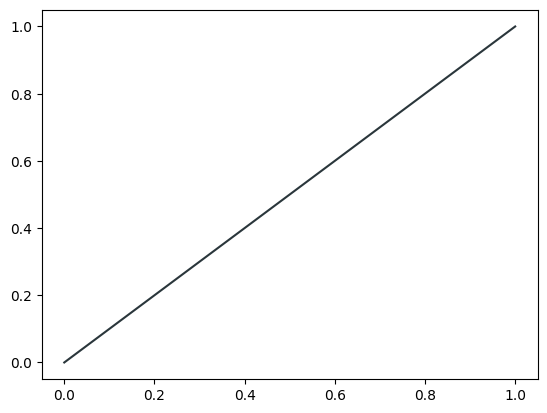

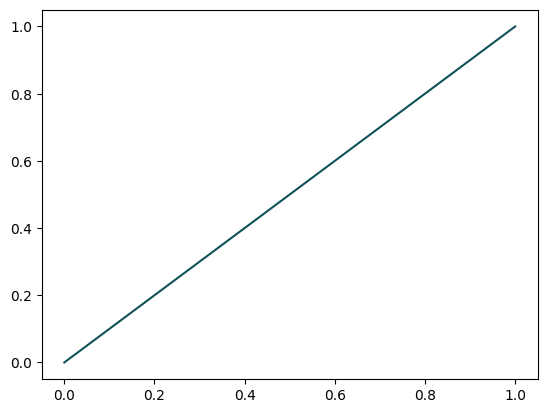

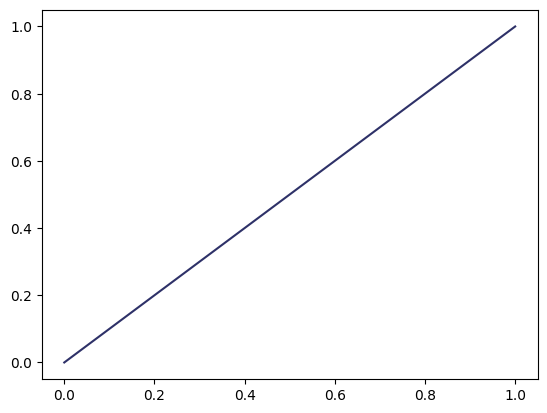

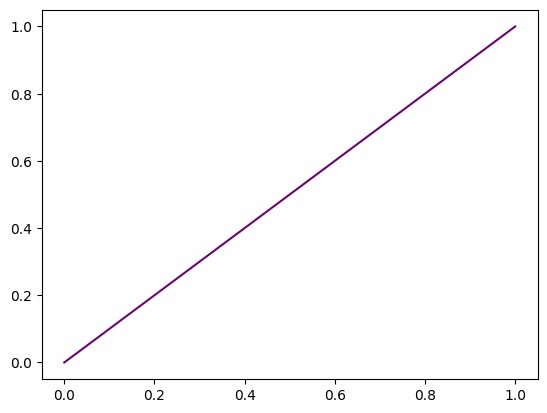

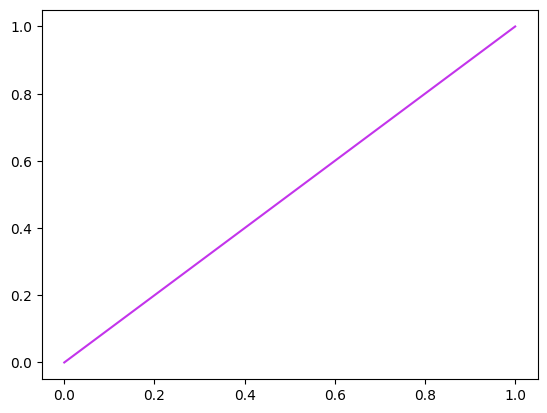

...

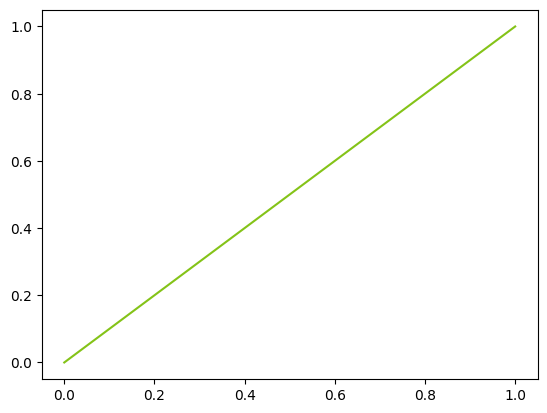

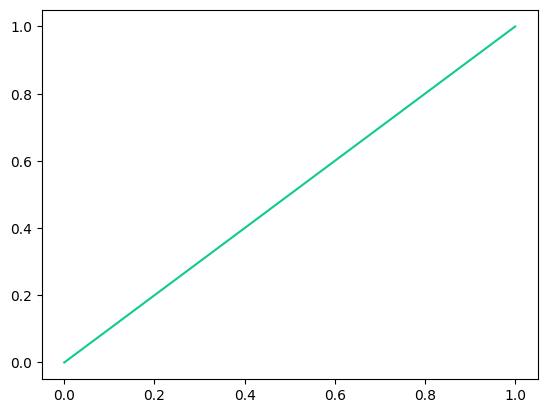

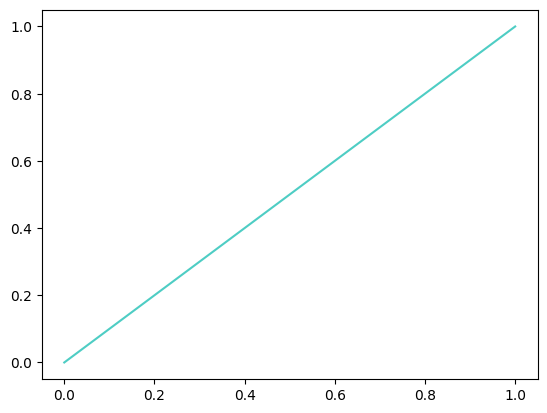

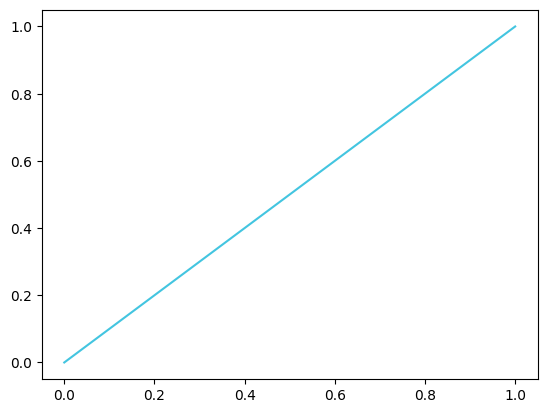

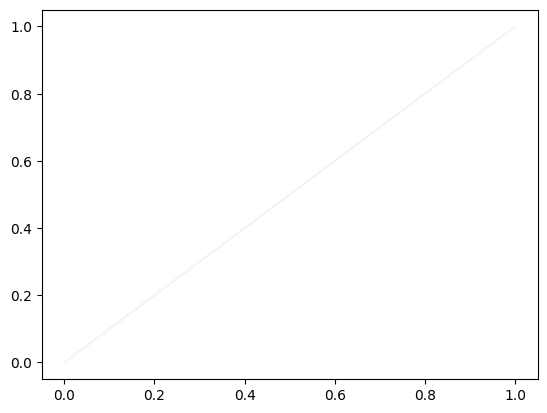

In [ ]:
colors = """#2A363B - Dark Charcoal Grey
#105257 - Deep Teal
#2E3168 - Dark Blue
#6A0572 - Deep Purple
#C334EB - Vibrant Purple
#B11BE8 - Bright Magenta
#F0539B - Vivid Pink
#FF6B6B - Lively Pink
#FF7F50 - Soft Coral
#FFDD57 - Warm Golden Yellow
#FDBE15 - Bright Yellow
#84C318 - Bright Green
#0FCB8C - Bright Teal Green
#4ECDC4 - Bright Turquoise
#43C5E0 - Light Blue
#FAF2E9 - Soft Cream
"""

# Visualize them all
for line in colors.splitlines():
    c = line.split(" ")[0]
    import matplotlib.pyplot as plt
    plt.figure()
    plt.plot([0, 1], [0, 1], color=c)
    plt.show()


##### Main Plot

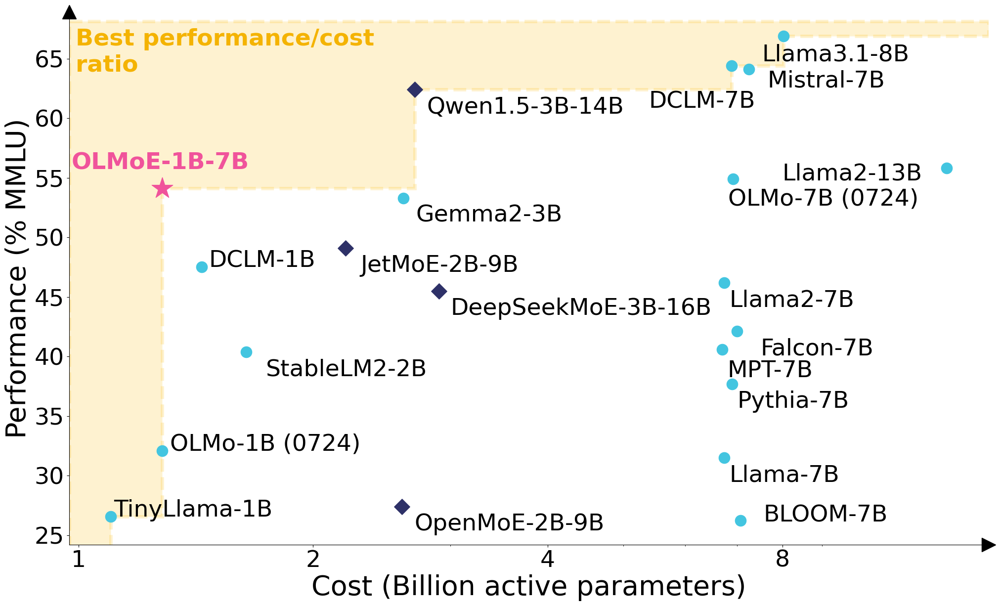

In [1]:
import json
import os
import sys

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# matplotlib.rcParams['font.sans-serif'] = "Arial"

FONTSIZE = 34

model_to_scores = {
    "OLMoE-1B-7B": [1.28, 54.1, "pink", 0.103022592],

    "JetMoE-2B-9B": [2.2, 49.1, "MoE", 0.0], # tied
    "OpenMoE-2B-9B": [2.6, 27.4, "MoE", 0.0],
    "Qwen1.5-3B-14B": [2.7, 62.4, "MoE", 0.0],
    "DeepSeekMoE-3B-16B": [2.9, 45.5, "MoE", 0.0],
#    "Jamba-12B-52B": [12.0, 67.4, "MoE"],
#    "Mixtral-13B-47B": [13.0, 70.6, "MoE"],

    "OLMo-1B (0724)": [1.28, 32.1, "Dense", 0.103022592],
#    "OLMo-7B (0424)": [6.92, 54.4, "Dense", 0.205946880],
    "OLMo-7B (0724)": [6.92, 54.89, "Dense", 0.205946880],

    "Gemma2-3B": [2.61, 53.3, "Dense", 0], # tied
#    "Gemma2-9B": [9.24, 70.61, "Dense"],

    "Mistral-7B": [7.25, 64.1, "Dense", 0.131072000],

    "Llama-7B": [6.74, 31.5, "Dense", 0.131072000],
    "Llama2-7B": [6.74, 46.2, "Dense", 0.131072000],
    "Llama2-13B": [13.0, 55.8, "Dense", 0.163840000],
    "Llama3.1-8B": [8.03, 66.9, "Dense", 0.525336576],

    "DCLM-1B": [1.44, 47.5, "Dense", 0.103284736],
    "DCLM-7B": [6.89, 64.38, "Dense", 0.206569472],

    "TinyLlama-1B": [1.1, 26.58, "Dense", 0.065536000],

    "Falcon-7B": [7, 42.13, "Dense", 0.0],

#    "Pythia-1B": [1.08, 31.09, "Dense", 0.0],
    "Pythia-7B": [6.9	, 37.7, "Dense", 0.0],

    "StableLM2-2B": [1.64, 40.37, "Dense", 0.205520896],

    "MPT-7B": [6.7, 40.57, "Dense", 0.0], # 0.206569472 # unclear

    # https://huggingface.co/spaces/open-llm-leaderboard-old/open_llm_leaderboard
    "BLOOM-7B": [7.07, 26.25, "Dense", 0.0] # tied
}

model_to_offset = {
     "OLMoE-1B-7B": [-0.3, 1.6],

     "Llama2-13B": [-5.0, -1],
     "Llama3.1-8B": [-0.5, -2.1],

     "DCLM-1B": [0.03, 0],
     "DCLM-7B": [-1.5, -3.5],

     "Pythia-1B": [0.05, -2],
     "OpenMoE-3B-9B": [0.05, 0],
     "TinyLlama-1B": [0.01, 0],

     "OLMo-1B (0724)": [0.03, 0],
#     "OLMo-7B (0424)": [-0.1, -2.2],
     "OLMo-7B (0724)": [-0.1, -2.2],

     "BLOOM-7B": [0.5, -0.1],
     "Falcon-7B": [0.5, -2],
     "MPT-7B": [0.1, -2.3],
     "Mistral-7B": [0.4, -1.5],
#     "StableLM2-2B": [-0.1, 0],
#     "StableLM2-2B": [-0.1, 0],

}

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

# https://mdigi.tools/darken-color/#google_vignette
dark_yellow = "#f4b302"

model_to_color = {
    "MoE": "#2E3168",
    "Dense": "#43C5E0", # #F4CBCC
    "OLMoE": "#F0539B",
    "black": "black",
    "pink": "#F0539B",
}

model_to_text_color = {
    "pink": "#F0539B",
}

model_to_fontweight = {
    "pink": "bold",
}

model_to_marker = {
    "MoE": [256, "D"],
    "Dense": [256, "o"],
    "pink": [1024, "*"]
}

fig, ax = plt.subplots(figsize=(24, 14))

for k, v in model_to_scores.items():
    ### dot + name ###
    #"""
    color = model_to_color[v[2]]
    s, marker = model_to_marker[v[2]]
    ax.scatter(
        v[0], # - v[3],
        v[1],
        label=k,
        color=color,
        s=s,
        marker=marker
#        alpha=.5
    )
    x_offset, y_offset = model_to_offset.get(k, (0.1, -2))

    ax.text(
        v[0] + x_offset,
        v[1] + y_offset,
        k,
        fontsize=FONTSIZE,
        fontweight=model_to_fontweight.get(v[2], None),
        color=model_to_text_color.get(v[2], None),
    )
    #"""

    ### only name ###
    """
    fontweight = 'normal'
    fontsize = FONTSIZE
    if k == "SGPT2":
        fontweight = "bold"
        fontsize += 2
    ax.text(
        v[0],
        v[1],
        k,
        fontsize=FONTSIZE,
        fontweight=fontweight,
        color=model_to_color[v[-1]],
    )
    """

    # Annotate does not work with logscale, https://stackoverflow.com/questions/21140385/matplotlib-annotate-doesnt-work-on-log-scale
    #ax.annotate(
    #    MODEL_TO_NAME.get(k, k),
    #   xy=(np.log10(1000 / v["STS15"]["speed_ms"]), results_avg[k] - offset)
    #)

# Make x-axis log
ax.set_xscale('log')

ax.set_ylabel("Performance (% MMLU)", fontsize=FONTSIZE+6)
ax.set_xlabel("Cost (Billion active parameters)", fontsize=FONTSIZE+6)

ax.set_xticks([1, 2, 4, 8], ["1", "2", "4", "8"])
#ax.set_xticks([1, 1.5, 2.5, 4.5, 8.5], ["1", "1.5", "2.5", "4.5", "8.5"])
#ax.set_xlim((0 - 2, model_to_scores["GPT 4"][0] + 4))

#ax.set_yticks([0.,  20.,  40.,  60.,  80.], ["0 / N/A", "20", "40", "60", "80"])
#ax.set_ylim((EMB_MIN - 1, EMB_MAX))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

a, b = ax.get_xlim()
c, d = ax.get_ylim()

# https://stackoverflow.com/questions/44397105/how-to-draw-a-triangle-using-matplotlib-pyplot-based-on-3-dots-x-y-in-2d
"""
X = np.array([[a, 45], [a, d-0.8], [3.0, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:3,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)
"""

X = np.array([[a, 0], [1.1, 0], [1.1, 26.58], [1.28, 26.58], [1.28, 54.1], [2.7, 54.1], [2.7, 62.4], [6.89, 62.4], [6.89, 64.38], [8.03, 64.38], [8.03, 66.9], [b, 66.9], [b, d-0.8], [a, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)


ax.text(a+0.02, d-5, "Best performance/cost\nratio", fontsize=FONTSIZE, color=dark_yellow, fontweight="bold")
#ax.text(a+0.02, d-5, "Best performance/cost\n         ratio", fontsize=FONTSIZE, color=colors[3], fontweight="bold")

# change all spines
# for axis in ['bottom','left']:
#     ax.spines[axis].set_linewidth(3)
# increase tick width
# ax.tick_params(width=3)

# Add arrows at end of axis
#ax.annotate('', xy=(a+1, 65), xytext=(a+1, 65), arrowprops=dict(arrowstyle="->", color='black', linewidth=5))
# https://matplotlib.org/stable/gallery/spines/centered_spines_with_arrows.html
ax.plot(a, d, "^k", linewidth=20, markersize=20, clip_on=False)
ax.plot(b, c, ">k", linewidth=20, markersize=20, clip_on=False)
ax.set_xlim(a, b)
ax.set_ylim(c, d)

#ax.grid(alpha=0.5)
# Create deduplicated Global Legend
#handles, labels = plt.gca().get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#lgnd = plt.legend(
#    by_label.values(),
#    by_label.keys(),
#    title="Base Architecture",
#    loc=(0.08,0.08), # "lower left",
#)
# Rescale bubbles to have the same size
#for handle in lgnd.legendHandles:
#    handle.set_sizes([70.0])
ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

plt.savefig('performance.pdf', dpi=300, bbox_inches='tight')
plt.savefig('performance.png', dpi=300, bbox_inches='tight')
plt.show()


###### Old versions

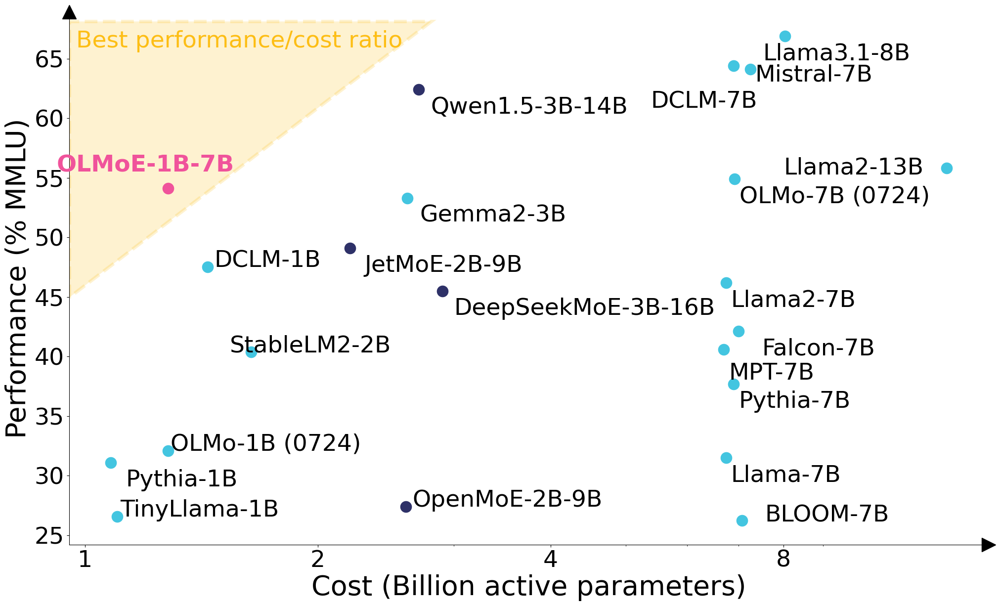

In [ ]:
import json
import os
import sys

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# matplotlib.rcParams['font.sans-serif'] = "Arial"

FONTSIZE = 34

model_to_scores = {
    "OLMoE-1B-7B": [1.28, 54.1, "pink", 0.103022592],

    "JetMoE-2B-9B": [2.2, 49.1, "MoE", 0.0], # tied
    "OpenMoE-2B-9B": [2.6, 27.4, "MoE", 0.0],
    "Qwen1.5-3B-14B": [2.7, 62.4, "MoE", 0.0],
    "DeepSeekMoE-3B-16B": [2.9, 45.5, "MoE", 0.0],
#    "Jamba-12B-52B": [12.0, 67.4, "MoE"],
#    "Mixtral-13B-47B": [13.0, 70.6, "MoE"],

    "OLMo-1B (0724)": [1.28, 32.1, "Dense", 0.103022592],
#    "OLMo-7B (0424)": [6.92, 54.4, "Dense", 0.205946880],
    "OLMo-7B (0724)": [6.92, 54.89, "Dense", 0.205946880],

    "Gemma2-3B": [2.61, 53.3, "Dense", 0], # tied
#    "Gemma2-9B": [9.24, 70.61, "Dense"],

    "Mistral-7B": [7.25, 64.1, "Dense", 0.131072000],

    "Llama-7B": [6.74, 31.5, "Dense", 0.131072000],
    "Llama2-7B": [6.74, 46.2, "Dense", 0.131072000],
    "Llama2-13B": [13.0, 55.8, "Dense", 0.163840000],
    "Llama3.1-8B": [8.03, 66.9, "Dense", 0.525336576],

    "DCLM-1B": [1.44, 47.5, "Dense", 0.103284736],
    "DCLM-7B": [6.89, 64.38, "Dense", 0.206569472],

    "TinyLlama-1B": [1.1, 26.58, "Dense", 0.065536000],

    "Falcon-7B": [7, 42.13, "Dense", 0.0],

    "Pythia-1B": [1.08, 31.09, "Dense", 0.0],
    "Pythia-7B": [6.9	, 37.7, "Dense", 0.0],

    "StableLM2-2B": [1.64, 40.37, "Dense", 0.205520896],

    "MPT-7B": [6.7, 40.57, "Dense", 0.0], # 0.206569472 # unclear

    # https://huggingface.co/spaces/open-llm-leaderboard-old/open_llm_leaderboard
    "BLOOM-7B": [7.07, 26.25, "Dense", 0.0] # tied
}

model_to_offset = {
     "OLMoE-1B-7B": [-0.36, 1.4],

     "Llama2-13B": [-5.0, -0.5],
     "Llama3.1-8B": [-0.5, -2.0],

     "DCLM-1B": [0.03, 0],
     "DCLM-7B": [-1.5, -3.5],

     "Pythia-1B": [0.05, -2],
     "OpenMoE-2B-9B": [0.05, 0],
     "TinyLlama-1B": [0.01, 0],

     "OLMo-1B (0724)": [0.01, 0],
     "OLMo-7B (0424)": [-0.1, -2.2],

     "BLOOM-7B": [0.5, -0.1],
     "Falcon-7B": [0.5, -2],
     "MPT-7B": [0.1, -2.5],
     "Mistral-7B": [0.1, -1],
     "StableLM2-2B": [-0.1, 0],
}

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

model_to_color = {
    "MoE": "#2E3168",
    "Dense": "#43C5E0", # #F4CBCC
    "OLMoE": "#F0539B",
    "black": "black",
    "pink": "#F0539B",
}

model_to_text_color = {
    "pink": "#F0539B",
}

model_to_fontweight = {
    "pink": "bold",
}


fig, ax = plt.subplots(figsize=(24, 14))

for k, v in model_to_scores.items():
    ### dot + name ###
    #"""
    color = model_to_color[v[2]]
    s = 256
    ax.scatter(
        v[0], # - v[3],
        v[1],
        label=k,
        color=color,
        s=s,
#        alpha=.5
    )
    x_offset, y_offset = model_to_offset.get(k, (0.1, -2))

    ax.text(
        v[0] + x_offset,
        v[1] + y_offset,
        k,
        fontsize=FONTSIZE,
        fontweight=model_to_fontweight.get(v[2], None),
        color=model_to_text_color.get(v[2], None),
    )
    #"""

    ### only name ###
    """
    fontweight = 'normal'
    fontsize = FONTSIZE
    if k == "SGPT2":
        fontweight = "bold"
        fontsize += 2
    ax.text(
        v[0],
        v[1],
        k,
        fontsize=FONTSIZE,
        fontweight=fontweight,
        color=model_to_color[v[-1]],
    )
    """

    # Annotate does not work with logscale, https://stackoverflow.com/questions/21140385/matplotlib-annotate-doesnt-work-on-log-scale
    #ax.annotate(
    #    MODEL_TO_NAME.get(k, k),
    #   xy=(np.log10(1000 / v["STS15"]["speed_ms"]), results_avg[k] - offset)
    #)

# Make x-axis log
ax.set_xscale('log')

ax.set_ylabel("Performance (% MMLU)", fontsize=FONTSIZE+6)
ax.set_xlabel("Cost (Billion active parameters)", fontsize=FONTSIZE+6)

ax.set_xticks([1, 2, 4, 8], ["1", "2", "4", "8"])
#ax.set_xticks([1, 1.5, 2.5, 4.5, 8.5], ["1", "1.5", "2.5", "4.5", "8.5"])
#ax.set_xlim((0 - 2, model_to_scores["GPT 4"][0] + 4))

#ax.set_yticks([0.,  20.,  40.,  60.,  80.], ["0 / N/A", "20", "40", "60", "80"])
#ax.set_ylim((EMB_MIN - 1, EMB_MAX))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

a, b = ax.get_xlim()
c, d = ax.get_ylim()

# https://stackoverflow.com/questions/44397105/how-to-draw-a-triangle-using-matplotlib-pyplot-based-on-3-dots-x-y-in-2d
X = np.array([[a, 45], [a, d-0.8], [2.8, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:3,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)
ax.text(a+0.02, d-3, "Best performance/cost ratio", fontsize=FONTSIZE, color=colors[3])

# change all spines
# for axis in ['bottom','left']:
#     ax.spines[axis].set_linewidth(3)
# increase tick width
# ax.tick_params(width=3)

# Add arrows at end of axis
#ax.annotate('', xy=(a+1, 65), xytext=(a+1, 65), arrowprops=dict(arrowstyle="->", color='black', linewidth=5))
# https://matplotlib.org/stable/gallery/spines/centered_spines_with_arrows.html
ax.plot(a, d, "^k", linewidth=20, markersize=20, clip_on=False)
ax.plot(b, c, ">k", linewidth=20, markersize=20, clip_on=False)
ax.set_xlim(a, b)
ax.set_ylim(c, d)

"""
ax.plot(
    [model_to_scores["SGPT2 Gen Only"][0], model_to_scores["SGPT2 Gen Only"][0]],
    [model_to_scores["SGPT2 Gen Only"][1], model_to_scores["SGPT2"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Gen'],
    dashes=(2, 5)

)

ax.plot(
    [model_to_scores["SGPT2 Emb Only"][0], model_to_scores["SGPT2"][0]],
    [model_to_scores["SGPT2 Emb Only"][1], model_to_scores["SGPT2 Emb Only"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Emb'],
    dashes=(2, 5)
)
"""

#ax.grid(alpha=0.5)
# Create deduplicated Global Legend
#handles, labels = plt.gca().get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#lgnd = plt.legend(
#    by_label.values(),
#    by_label.keys(),
#    title="Base Architecture",
#    loc=(0.08,0.08), # "lower left",
#)
# Rescale bubbles to have the same size
#for handle in lgnd.legendHandles:
#    handle.set_sizes([70.0])
ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

#plt.savefig('performance.pdf', dpi=300, bbox_inches='tight')
#plt.savefig('performance.svg', dpi=300, bbox_inches='tight')
plt.savefig('performance.png', dpi=300, bbox_inches='tight')
plt.show()

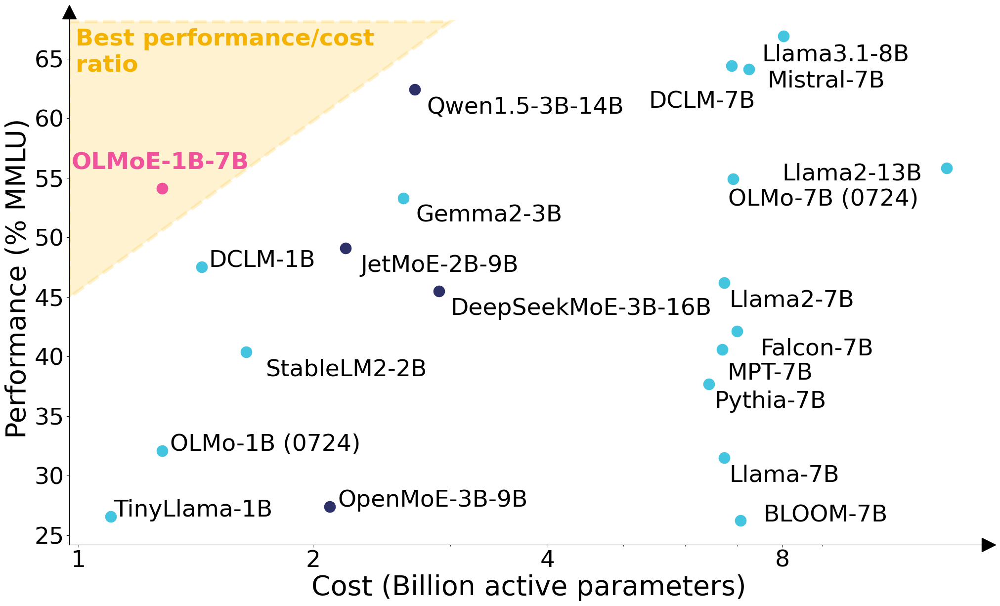

In [ ]:
import json
import os
import sys

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# matplotlib.rcParams['font.sans-serif'] = "Arial"

FONTSIZE = 34

model_to_scores = {
    "OLMoE-1B-7B": [1.28, 54.1, "pink", 0.103022592],

    "JetMoE-2B-9B": [2.2, 49.1, "MoE", 0.0], # tied
    "OpenMoE-3B-9B": [2.1, 27.4, "MoE", 0.0], # alrdy excludes vocab
    "Qwen1.5-3B-14B": [2.7, 62.4, "MoE", 0.0],
    "DeepSeekMoE-3B-16B": [2.9, 45.5, "MoE", 0.0],
#    "Jamba-12B-52B": [12.0, 67.4, "MoE"],
#    "Mixtral-13B-47B": [13.0, 70.6, "MoE"],

    "OLMo-1B (0724)": [1.28, 32.1, "Dense", 0.103022592],
    #"OLMo-7B (0424)": [6.92, 54.4, "Dense", 0.205946880],
    "OLMo-7B (0724)": [6.92, 54.89, "Dense", 0.205946880],

    "Gemma2-3B": [2.61, 53.3, "Dense", 0], # tied
#    "Gemma2-9B": [9.24, 70.61, "Dense"],

    "Mistral-7B": [7.25, 64.1, "Dense", 0.131072000],

    "Llama-7B": [6.74, 31.5, "Dense", 0.131072000],
    "Llama2-7B": [6.74, 46.2, "Dense", 0.131072000],
    "Llama2-13B": [13.0, 55.8, "Dense", 0.163840000],
    "Llama3.1-8B": [8.03, 66.9, "Dense", 0.525336576],

    "DCLM-1B": [1.44, 47.5, "Dense", 0.103284736],
    "DCLM-7B": [6.89, 64.38, "Dense", 0.206569472],

    "TinyLlama-1B": [1.1, 26.58, "Dense", 0.065536000],

    "Falcon-7B": [7, 42.13, "Dense", 0.0],

#    "Pythia-1B": [0.805736448, 31.09, "Dense", 0.0], # alrdy excludes vocab
    "Pythia-7B": [6.444163072	, 37.7, "Dense", 0.0], # alrdy excludes vocab

    "StableLM2-2B": [1.64, 40.37, "Dense", 0.205520896],

    "MPT-7B": [6.7, 40.57, "Dense", 0.0], # 0.206569472 # unclear

    # https://huggingface.co/spaces/open-llm-leaderboard-old/open_llm_leaderboard
    "BLOOM-7B": [7.07, 26.25, "Dense", 0.0] # tied
}

model_to_offset = {
     "OLMoE-1B-7B": [-0.3, 1.6],

     "Llama2-13B": [-5.0, -1],
     "Llama3.1-8B": [-0.5, -2.1],

     "DCLM-1B": [0.03, 0],
     "DCLM-7B": [-1.5, -3.5],

     "Pythia-1B": [0.05, -2],
     "OpenMoE-3B-9B": [0.05, 0],
     "TinyLlama-1B": [0.01, 0],

     "OLMo-1B (0724)": [0.03, 0],
#     "OLMo-7B (0424)": [-0.1, -2.2],
     "OLMo-7B (0724)": [-0.1, -2.2],

     "BLOOM-7B": [0.5, -0.1],
     "Falcon-7B": [0.5, -2],
     "MPT-7B": [0.1, -2.5],
     "Mistral-7B": [0.4, -1.5],
#     "StableLM2-2B": [-0.1, 0],
#     "StableLM2-2B": [-0.1, 0],

}

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

# https://mdigi.tools/darken-color/#google_vignette
dark_yellow = "#f4b302"

model_to_color = {
    "MoE": "#2E3168",
    "Dense": "#43C5E0", # #F4CBCC
    "OLMoE": "#F0539B",
    "black": "black",
    "pink": "#F0539B",
}

model_to_text_color = {
    "pink": "#F0539B",
}

model_to_fontweight = {
    "pink": "bold",
}


fig, ax = plt.subplots(figsize=(24, 14))

for k, v in model_to_scores.items():
    ### dot + name ###
    #"""
    color = model_to_color[v[2]]
    s = 256
    ax.scatter(
        v[0], # - v[3],
        v[1],
        label=k,
        color=color,
        s=s,
#        alpha=.5
    )
    x_offset, y_offset = model_to_offset.get(k, (0.1, -2))

    ax.text(
        v[0] + x_offset,
        v[1] + y_offset,
        k,
        fontsize=FONTSIZE,
        fontweight=model_to_fontweight.get(v[2], None),
        color=model_to_text_color.get(v[2], None),
    )
    #"""

    ### only name ###
    """
    fontweight = 'normal'
    fontsize = FONTSIZE
    if k == "SGPT2":
        fontweight = "bold"
        fontsize += 2
    ax.text(
        v[0],
        v[1],
        k,
        fontsize=FONTSIZE,
        fontweight=fontweight,
        color=model_to_color[v[-1]],
    )
    """

    # Annotate does not work with logscale, https://stackoverflow.com/questions/21140385/matplotlib-annotate-doesnt-work-on-log-scale
    #ax.annotate(
    #    MODEL_TO_NAME.get(k, k),
    #   xy=(np.log10(1000 / v["STS15"]["speed_ms"]), results_avg[k] - offset)
    #)

# Make x-axis log
ax.set_xscale('log')

ax.set_ylabel("Performance (% MMLU)", fontsize=FONTSIZE+6)
ax.set_xlabel("Cost (Billion active parameters)", fontsize=FONTSIZE+6)

ax.set_xticks([1, 2, 4, 8], ["1", "2", "4", "8"])
#ax.set_xticks([1, 1.5, 2.5, 4.5, 8.5], ["1", "1.5", "2.5", "4.5", "8.5"])
#ax.set_xlim((0 - 2, model_to_scores["GPT 4"][0] + 4))

#ax.set_yticks([0.,  20.,  40.,  60.,  80.], ["0 / N/A", "20", "40", "60", "80"])
#ax.set_ylim((EMB_MIN - 1, EMB_MAX))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

a, b = ax.get_xlim()
c, d = ax.get_ylim()

# https://stackoverflow.com/questions/44397105/how-to-draw-a-triangle-using-matplotlib-pyplot-based-on-3-dots-x-y-in-2d
X = np.array([[a, 45], [a, d-0.8], [3.0, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:3,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)
ax.text(a+0.02, d-5, "Best performance/cost\nratio", fontsize=FONTSIZE, color=dark_yellow, fontweight="bold")
#ax.text(a+0.02, d-5, "Best performance/cost\n         ratio", fontsize=FONTSIZE, color=colors[3], fontweight="bold")

# change all spines
# for axis in ['bottom','left']:
#     ax.spines[axis].set_linewidth(3)
# increase tick width
# ax.tick_params(width=3)

# Add arrows at end of axis
#ax.annotate('', xy=(a+1, 65), xytext=(a+1, 65), arrowprops=dict(arrowstyle="->", color='black', linewidth=5))
# https://matplotlib.org/stable/gallery/spines/centered_spines_with_arrows.html
ax.plot(a, d, "^k", linewidth=20, markersize=20, clip_on=False)
ax.plot(b, c, ">k", linewidth=20, markersize=20, clip_on=False)
ax.set_xlim(a, b)
ax.set_ylim(c, d)

"""
ax.plot(
    [model_to_scores["SGPT2 Gen Only"][0], model_to_scores["SGPT2 Gen Only"][0]],
    [model_to_scores["SGPT2 Gen Only"][1], model_to_scores["SGPT2"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Gen'],
    dashes=(2, 5)

)

ax.plot(
    [model_to_scores["SGPT2 Emb Only"][0], model_to_scores["SGPT2"][0]],
    [model_to_scores["SGPT2 Emb Only"][1], model_to_scores["SGPT2 Emb Only"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Emb'],
    dashes=(2, 5)
)
"""

#ax.grid(alpha=0.5)
# Create deduplicated Global Legend
#handles, labels = plt.gca().get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#lgnd = plt.legend(
#    by_label.values(),
#    by_label.keys(),
#    title="Base Architecture",
#    loc=(0.08,0.08), # "lower left",
#)
# Rescale bubbles to have the same size
#for handle in lgnd.legendHandles:
#    handle.set_sizes([70.0])
ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

#plt.savefig('performance.pdf', dpi=300, bbox_inches='tight')
#plt.savefig('performance.svg', dpi=300, bbox_inches='tight')
plt.savefig('performance.png', dpi=300, bbox_inches='tight')
plt.show()

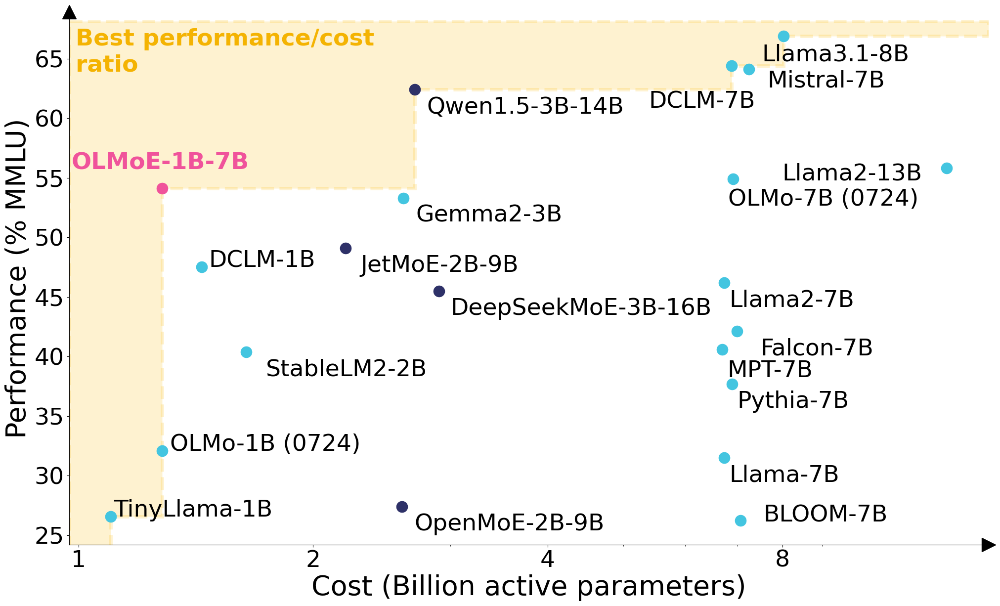

In [ ]:
import json
import os
import sys

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# matplotlib.rcParams['font.sans-serif'] = "Arial"

FONTSIZE = 34

model_to_scores = {
    "OLMoE-1B-7B": [1.28, 54.1, "pink", 0.103022592],

    "JetMoE-2B-9B": [2.2, 49.1, "MoE", 0.0], # tied
    "OpenMoE-2B-9B": [2.6, 27.4, "MoE", 0.0],
    "Qwen1.5-3B-14B": [2.7, 62.4, "MoE", 0.0],
    "DeepSeekMoE-3B-16B": [2.9, 45.5, "MoE", 0.0],
#    "Jamba-12B-52B": [12.0, 67.4, "MoE"],
#    "Mixtral-13B-47B": [13.0, 70.6, "MoE"],

    "OLMo-1B (0724)": [1.28, 32.1, "Dense", 0.103022592],
#    "OLMo-7B (0424)": [6.92, 54.4, "Dense", 0.205946880],
    "OLMo-7B (0724)": [6.92, 54.89, "Dense", 0.205946880],

    "Gemma2-3B": [2.61, 53.3, "Dense", 0], # tied
#    "Gemma2-9B": [9.24, 70.61, "Dense"],

    "Mistral-7B": [7.25, 64.1, "Dense", 0.131072000],

    "Llama-7B": [6.74, 31.5, "Dense", 0.131072000],
    "Llama2-7B": [6.74, 46.2, "Dense", 0.131072000],
    "Llama2-13B": [13.0, 55.8, "Dense", 0.163840000],
    "Llama3.1-8B": [8.03, 66.9, "Dense", 0.525336576],

    "DCLM-1B": [1.44, 47.5, "Dense", 0.103284736],
    "DCLM-7B": [6.89, 64.38, "Dense", 0.206569472],

    "TinyLlama-1B": [1.1, 26.58, "Dense", 0.065536000],

    "Falcon-7B": [7, 42.13, "Dense", 0.0],

#    "Pythia-1B": [1.08, 31.09, "Dense", 0.0],
    "Pythia-7B": [6.9	, 37.7, "Dense", 0.0],

    "StableLM2-2B": [1.64, 40.37, "Dense", 0.205520896],

    "MPT-7B": [6.7, 40.57, "Dense", 0.0], # 0.206569472 # unclear

    # https://huggingface.co/spaces/open-llm-leaderboard-old/open_llm_leaderboard
    "BLOOM-7B": [7.07, 26.25, "Dense", 0.0] # tied
}

model_to_offset = {
     "OLMoE-1B-7B": [-0.3, 1.6],

     "Llama2-13B": [-5.0, -1],
     "Llama3.1-8B": [-0.5, -2.1],

     "DCLM-1B": [0.03, 0],
     "DCLM-7B": [-1.5, -3.5],

     "Pythia-1B": [0.05, -2],
     "OpenMoE-3B-9B": [0.05, 0],
     "TinyLlama-1B": [0.01, 0],

     "OLMo-1B (0724)": [0.03, 0],
#     "OLMo-7B (0424)": [-0.1, -2.2],
     "OLMo-7B (0724)": [-0.1, -2.2],

     "BLOOM-7B": [0.5, -0.1],
     "Falcon-7B": [0.5, -2],
     "MPT-7B": [0.1, -2.3],
     "Mistral-7B": [0.4, -1.5],
#     "StableLM2-2B": [-0.1, 0],
#     "StableLM2-2B": [-0.1, 0],

}

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

# https://mdigi.tools/darken-color/#google_vignette
dark_yellow = "#f4b302"

model_to_color = {
    "MoE": "#2E3168",
    "Dense": "#43C5E0", # #F4CBCC
    "OLMoE": "#F0539B",
    "black": "black",
    "pink": "#F0539B",
}

model_to_text_color = {
    "pink": "#F0539B",
}

model_to_fontweight = {
    "pink": "bold",
}


fig, ax = plt.subplots(figsize=(24, 14))

for k, v in model_to_scores.items():
    ### dot + name ###
    #"""
    color = model_to_color[v[2]]
    s = 256
    ax.scatter(
        v[0], # - v[3],
        v[1],
        label=k,
        color=color,
        s=s,
#        alpha=.5
    )
    x_offset, y_offset = model_to_offset.get(k, (0.1, -2))

    ax.text(
        v[0] + x_offset,
        v[1] + y_offset,
        k,
        fontsize=FONTSIZE,
        fontweight=model_to_fontweight.get(v[2], None),
        color=model_to_text_color.get(v[2], None),
    )
    #"""

    ### only name ###
    """
    fontweight = 'normal'
    fontsize = FONTSIZE
    if k == "SGPT2":
        fontweight = "bold"
        fontsize += 2
    ax.text(
        v[0],
        v[1],
        k,
        fontsize=FONTSIZE,
        fontweight=fontweight,
        color=model_to_color[v[-1]],
    )
    """

    # Annotate does not work with logscale, https://stackoverflow.com/questions/21140385/matplotlib-annotate-doesnt-work-on-log-scale
    #ax.annotate(
    #    MODEL_TO_NAME.get(k, k),
    #   xy=(np.log10(1000 / v["STS15"]["speed_ms"]), results_avg[k] - offset)
    #)

# Make x-axis log
ax.set_xscale('log')

ax.set_ylabel("Performance (% MMLU)", fontsize=FONTSIZE+6)
ax.set_xlabel("Cost (Billion active parameters)", fontsize=FONTSIZE+6)

ax.set_xticks([1, 2, 4, 8], ["1", "2", "4", "8"])
#ax.set_xticks([1, 1.5, 2.5, 4.5, 8.5], ["1", "1.5", "2.5", "4.5", "8.5"])
#ax.set_xlim((0 - 2, model_to_scores["GPT 4"][0] + 4))

#ax.set_yticks([0.,  20.,  40.,  60.,  80.], ["0 / N/A", "20", "40", "60", "80"])
#ax.set_ylim((EMB_MIN - 1, EMB_MAX))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

a, b = ax.get_xlim()
c, d = ax.get_ylim()

# https://stackoverflow.com/questions/44397105/how-to-draw-a-triangle-using-matplotlib-pyplot-based-on-3-dots-x-y-in-2d
"""
X = np.array([[a, 45], [a, d-0.8], [3.0, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:3,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)
"""

X = np.array([[a, 0], [1.1, 0], [1.1, 26.58], [1.28, 26.58], [1.28, 54.1], [2.7, 54.1], [2.7, 62.4], [6.89, 62.4], [6.89, 64.38], [8.03, 64.38], [8.03, 66.9], [b, 66.9], [b, d-0.8], [a, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)


ax.text(a+0.02, d-5, "Best performance/cost\nratio", fontsize=FONTSIZE, color=dark_yellow, fontweight="bold")
#ax.text(a+0.02, d-5, "Best performance/cost\n         ratio", fontsize=FONTSIZE, color=colors[3], fontweight="bold")

# change all spines
# for axis in ['bottom','left']:
#     ax.spines[axis].set_linewidth(3)
# increase tick width
# ax.tick_params(width=3)

# Add arrows at end of axis
#ax.annotate('', xy=(a+1, 65), xytext=(a+1, 65), arrowprops=dict(arrowstyle="->", color='black', linewidth=5))
# https://matplotlib.org/stable/gallery/spines/centered_spines_with_arrows.html
ax.plot(a, d, "^k", linewidth=20, markersize=20, clip_on=False)
ax.plot(b, c, ">k", linewidth=20, markersize=20, clip_on=False)
ax.set_xlim(a, b)
ax.set_ylim(c, d)

"""
ax.plot(
    [model_to_scores["SGPT2 Gen Only"][0], model_to_scores["SGPT2 Gen Only"][0]],
    [model_to_scores["SGPT2 Gen Only"][1], model_to_scores["SGPT2"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Gen'],
    dashes=(2, 5)

)

ax.plot(
    [model_to_scores["SGPT2 Emb Only"][0], model_to_scores["SGPT2"][0]],
    [model_to_scores["SGPT2 Emb Only"][1], model_to_scores["SGPT2 Emb Only"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Emb'],
    dashes=(2, 5)
)
"""

#ax.grid(alpha=0.5)
# Create deduplicated Global Legend
#handles, labels = plt.gca().get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#lgnd = plt.legend(
#    by_label.values(),
#    by_label.keys(),
#    title="Base Architecture",
#    loc=(0.08,0.08), # "lower left",
#)
# Rescale bubbles to have the same size
#for handle in lgnd.legendHandles:
#    handle.set_sizes([70.0])
ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

plt.savefig('performance.pdf', dpi=300, bbox_inches='tight')
#plt.savefig('performance.svg', dpi=300, bbox_inches='tight')
plt.savefig('performance.png', dpi=300, bbox_inches='tight')
plt.show()

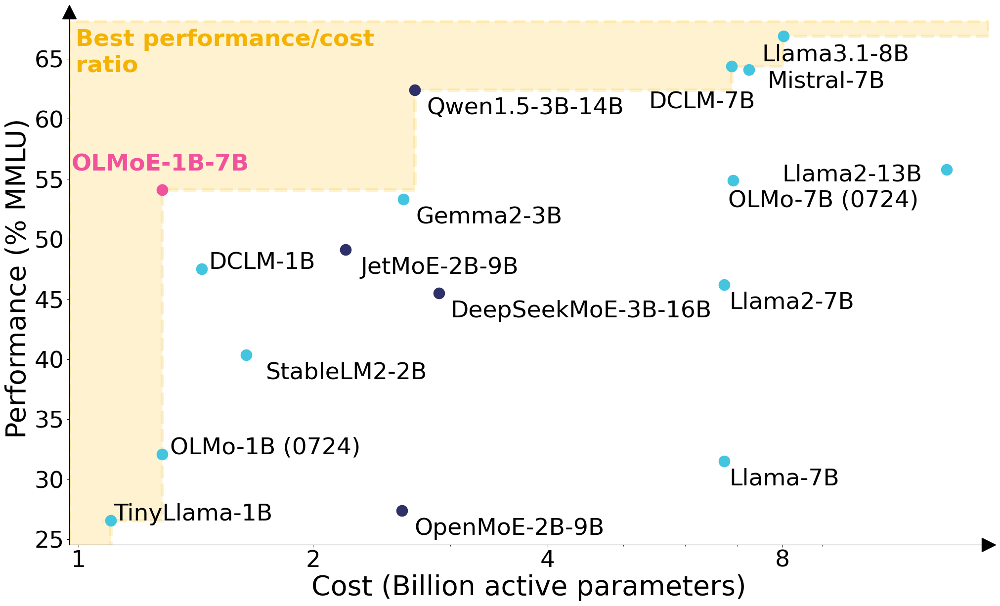

In [ ]:
"""
Less dots for tweet
"""
import json
import os
import sys

import matplotlib
import matplotlib.pyplot as plt
import numpy as np

# matplotlib.rcParams['font.sans-serif'] = "Arial"

FONTSIZE = 34

model_to_scores = {
    "OLMoE-1B-7B": [1.28, 54.1, "pink", 0.103022592],

    "JetMoE-2B-9B": [2.2, 49.1, "MoE", 0.0], # tied
    "OpenMoE-2B-9B": [2.6, 27.4, "MoE", 0.0],
    "Qwen1.5-3B-14B": [2.7, 62.4, "MoE", 0.0],
    "DeepSeekMoE-3B-16B": [2.9, 45.5, "MoE", 0.0],
#    "Jamba-12B-52B": [12.0, 67.4, "MoE"],
#    "Mixtral-13B-47B": [13.0, 70.6, "MoE"],

    "OLMo-1B (0724)": [1.28, 32.1, "Dense", 0.103022592],
#    "OLMo-7B (0424)": [6.92, 54.4, "Dense", 0.205946880],
    "OLMo-7B (0724)": [6.92, 54.89, "Dense", 0.205946880],

    "Gemma2-3B": [2.61, 53.3, "Dense", 0], # tied
#    "Gemma2-9B": [9.24, 70.61, "Dense"],

    "Mistral-7B": [7.25, 64.1, "Dense", 0.131072000],

    "Llama-7B": [6.74, 31.5, "Dense", 0.131072000],
    "Llama2-7B": [6.74, 46.2, "Dense", 0.131072000],
    "Llama2-13B": [13.0, 55.8, "Dense", 0.163840000],
    "Llama3.1-8B": [8.03, 66.9, "Dense", 0.525336576],

    "DCLM-1B": [1.44, 47.5, "Dense", 0.103284736],
    "DCLM-7B": [6.89, 64.38, "Dense", 0.206569472],

    "TinyLlama-1B": [1.1, 26.58, "Dense", 0.065536000],

#    "Falcon-7B": [7, 42.13, "Dense", 0.0],

#    "Pythia-1B": [1.08, 31.09, "Dense", 0.0],
#    "Pythia-7B": [6.9	, 37.7, "Dense", 0.0],

    "StableLM2-2B": [1.64, 40.37, "Dense", 0.205520896],

#    "MPT-7B": [6.7, 40.57, "Dense", 0.0], # 0.206569472 # unclear

    # https://huggingface.co/spaces/open-llm-leaderboard-old/open_llm_leaderboard
#    "BLOOM-7B": [7.07, 26.25, "Dense", 0.0] # tied
}

model_to_offset = {
     "OLMoE-1B-7B": [-0.3, 1.6],

     "Llama2-13B": [-5.0, -1],
     "Llama3.1-8B": [-0.5, -2.1],

     "DCLM-1B": [0.03, 0],
     "DCLM-7B": [-1.5, -3.5],

     "Pythia-1B": [0.05, -2],
     "OpenMoE-3B-9B": [0.05, 0],
     "TinyLlama-1B": [0.01, 0],

     "OLMo-1B (0724)": [0.03, 0],
#     "OLMo-7B (0424)": [-0.1, -2.2],
     "OLMo-7B (0724)": [-0.1, -2.2],

     "BLOOM-7B": [0.5, -0.1],
     "Falcon-7B": [0.5, -2],
     "MPT-7B": [0.1, -2.3],
     "Mistral-7B": [0.4, -1.5],
#     "StableLM2-2B": [-0.1, 0],
#     "StableLM2-2B": [-0.1, 0],

}

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

# https://mdigi.tools/darken-color/#google_vignette
dark_yellow = "#f4b302"

model_to_color = {
    "MoE": "#2E3168",
    "Dense": "#43C5E0", # #F4CBCC
    "OLMoE": "#F0539B",
    "black": "black",
    "pink": "#F0539B",
}

model_to_text_color = {
    "pink": "#F0539B",
}

model_to_fontweight = {
    "pink": "bold",
}


fig, ax = plt.subplots(figsize=(24, 14))

for k, v in model_to_scores.items():
    ### dot + name ###
    #"""
    color = model_to_color[v[2]]
    s = 256
    ax.scatter(
        v[0], # - v[3],
        v[1],
        label=k,
        color=color,
        s=s,
#        alpha=.5
    )
    x_offset, y_offset = model_to_offset.get(k, (0.1, -2))

    ax.text(
        v[0] + x_offset,
        v[1] + y_offset,
        k,
        fontsize=FONTSIZE,
        fontweight=model_to_fontweight.get(v[2], None),
        color=model_to_text_color.get(v[2], None),
    )
    #"""

    ### only name ###
    """
    fontweight = 'normal'
    fontsize = FONTSIZE
    if k == "SGPT2":
        fontweight = "bold"
        fontsize += 2
    ax.text(
        v[0],
        v[1],
        k,
        fontsize=FONTSIZE,
        fontweight=fontweight,
        color=model_to_color[v[-1]],
    )
    """

    # Annotate does not work with logscale, https://stackoverflow.com/questions/21140385/matplotlib-annotate-doesnt-work-on-log-scale
    #ax.annotate(
    #    MODEL_TO_NAME.get(k, k),
    #   xy=(np.log10(1000 / v["STS15"]["speed_ms"]), results_avg[k] - offset)
    #)

# Make x-axis log
ax.set_xscale('log')

ax.set_ylabel("Performance (% MMLU)", fontsize=FONTSIZE+6)
ax.set_xlabel("Cost (Billion active parameters)", fontsize=FONTSIZE+6)

ax.set_xticks([1, 2, 4, 8], ["1", "2", "4", "8"])
#ax.set_xticks([1, 1.5, 2.5, 4.5, 8.5], ["1", "1.5", "2.5", "4.5", "8.5"])
#ax.set_xlim((0 - 2, model_to_scores["GPT 4"][0] + 4))

#ax.set_yticks([0.,  20.,  40.,  60.,  80.], ["0 / N/A", "20", "40", "60", "80"])
#ax.set_ylim((EMB_MIN - 1, EMB_MAX))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

a, b = ax.get_xlim()
c, d = ax.get_ylim()

# https://stackoverflow.com/questions/44397105/how-to-draw-a-triangle-using-matplotlib-pyplot-based-on-3-dots-x-y-in-2d
"""
X = np.array([[a, 45], [a, d-0.8], [3.0, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:3,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)
"""

X = np.array([[a, 0], [1.1, 0], [1.1, 26.58], [1.28, 26.58], [1.28, 54.1], [2.7, 54.1], [2.7, 62.4], [6.89, 62.4], [6.89, 64.38], [8.03, 64.38], [8.03, 66.9], [b, 66.9], [b, d-0.8], [a, d-0.8]])
# plt.scatter(X[:, 0], X[:, 1], s=170, color="red")
t1 = plt.Polygon(X[:,:], facecolor=colors[3], alpha=0.2, zorder=-1, edgecolor=colors[3], linestyle='--', linewidth=5)
plt.gca().add_patch(t1)


ax.text(a+0.02, d-5, "Best performance/cost\nratio", fontsize=FONTSIZE, color=dark_yellow, fontweight="bold")
#ax.text(a+0.02, d-5, "Best performance/cost\n         ratio", fontsize=FONTSIZE, color=colors[3], fontweight="bold")

# change all spines
# for axis in ['bottom','left']:
#     ax.spines[axis].set_linewidth(3)
# increase tick width
# ax.tick_params(width=3)

# Add arrows at end of axis
#ax.annotate('', xy=(a+1, 65), xytext=(a+1, 65), arrowprops=dict(arrowstyle="->", color='black', linewidth=5))
# https://matplotlib.org/stable/gallery/spines/centered_spines_with_arrows.html
ax.plot(a, d, "^k", linewidth=20, markersize=20, clip_on=False)
ax.plot(b, c, ">k", linewidth=20, markersize=20, clip_on=False)
ax.set_xlim(a, b)
ax.set_ylim(c, d)

"""
ax.plot(
    [model_to_scores["SGPT2 Gen Only"][0], model_to_scores["SGPT2 Gen Only"][0]],
    [model_to_scores["SGPT2 Gen Only"][1], model_to_scores["SGPT2"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Gen'],
    dashes=(2, 5)

)

ax.plot(
    [model_to_scores["SGPT2 Emb Only"][0], model_to_scores["SGPT2"][0]],
    [model_to_scores["SGPT2 Emb Only"][1], model_to_scores["SGPT2 Emb Only"][1]],
    linestyle='--',
    lw=4.0,
    color=model_to_color['Emb'],
    dashes=(2, 5)
)
"""

#ax.grid(alpha=0.5)
# Create deduplicated Global Legend
#handles, labels = plt.gca().get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#lgnd = plt.legend(
#    by_label.values(),
#    by_label.keys(),
#    title="Base Architecture",
#    loc=(0.08,0.08), # "lower left",
#)
# Rescale bubbles to have the same size
#for handle in lgnd.legendHandles:
#    handle.set_sizes([70.0])
ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

plt.savefig('performance.pdf', dpi=300, bbox_inches='tight')
#plt.savefig('performance.svg', dpi=300, bbox_inches='tight')
plt.savefig('performance.png', dpi=300, bbox_inches='tight')
plt.show()

##### During training loss

In [ ]:
moe_runs = [
    ("qzbkmr9l", 20000),
    ("kzceol2w", 115000),
    ("plrvw4rd", 1080000),
    ("syif8df1", 1105000),
    ('hm5be7ad', 1110000),
    ("rzsn9tlc", 1200000),
]
DATA_MOE = {
    "train": [["train/CrossEntropyLoss"], []],
    "val_c4": [["eval/c4_en-validation/CrossEntropyLoss"], []],
    "val_pile": [["eval/pile-validation/CrossEntropyLoss"], []],
    "val_dolma_books": [["eval/dolma_books-validation/CrossEntropyLoss"], []],
    "val_dolma_reddit": [["eval/dolma_reddit-validation/CrossEntropyLoss"], []],
    "val_dolma_stack": [["eval/dolma_stack-validation/CrossEntropyLoss"], []],
}
#    "val_wikitext": [["eval/wikitext_103-validation/CrossEntropyLoss"], []],
#    "val_ice": [["eval/ice-validation/CrossEntropyLoss"], []],
#    "val_m2d2_s2orc": [["eval/ice-validation/CrossEntropyLoss"], []],

get_data(DATA_MOE, "_moe_loss", moe_runs, check_steps=True)
print(len(DATA_MOE["train"][1]))

Run ID: qzbkmr9l
Run ID: kzceol2w
Run ID: plrvw4rd
Run ID: syif8df1
Run ID: hm5be7ad
Run ID: rzsn9tlc
1086763


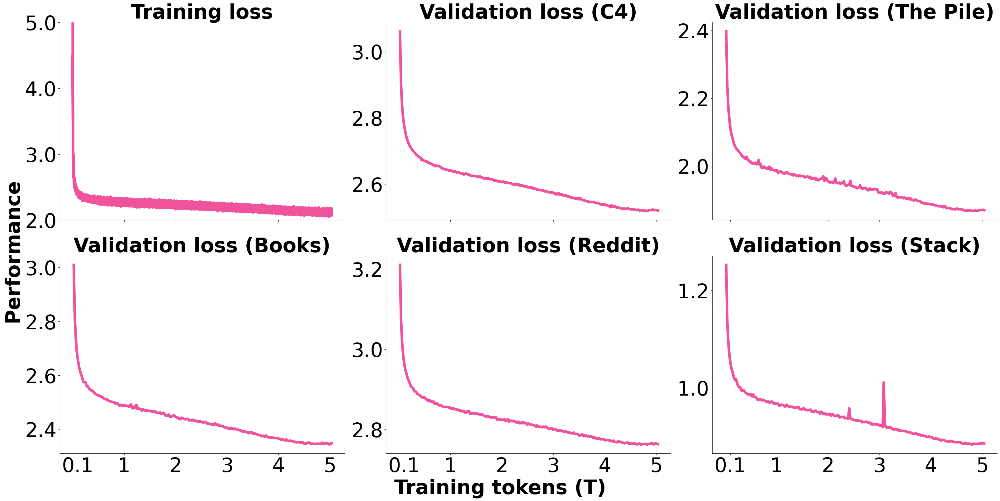

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "Validation loss (Books)",
    "Validation loss (Reddit)",
    "Validation loss (Stack)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_MOE["train"],),# DATA_FINE["train"], DATA_COARSE["train"]),
  (DATA_MOE["val_c4"],),# DATA_FINE["val_c4"], DATA_COARSE["val_c4"]),
  (DATA_MOE["val_pile"],),# DATA_FINE["val_pile"], DATA_COARSE["val_pile"]),
  (DATA_MOE["val_dolma_books"],),# DATA_FINE["down_hellaswag"], DATA_COARSE["down_hellaswag"]),
  (DATA_MOE["val_dolma_reddit"],),# DATA_FINE["down_mmlu_var"], DATA_COARSE["down_mmlu_var"]),
  (DATA_MOE["val_dolma_stack"],),# DATA_FINE["down_arcc"], DATA_COARSE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1] for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)
    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [0.1, 1, 2, 3, 4, 5]
    # Transform trillion tokens to steps
    x_ticks_loc = [x * 1e12 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 5])
    #elif i == 1:
    #    ax.set_ylim([2.6, 3.6])
    #elif i == 2:
    #    ax.set_ylim([2.0, 2.8])

# plt.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE, ncol=2)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Training tokens (T)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('loss.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
a

1.6523726344108582

##### During training

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1

if os.path.exists("down_moe_hellaswag.pkl"):
  with open("down_moe_hellaswag.pkl", "rb") as f:
      down_moe_hellaswag = pickle.load(f)

  with open("down_moe_piqa.pkl", "rb") as f:
      down_moe_piqa = pickle.load(f)

  with open("down_moe_arcc.pkl", "rb") as f:
      down_moe_arcc = pickle.load(f)

  # TODO: Maybe swap for arc-e
  with open("down_moe_winogrande.pkl", "rb") as f:
      down_moe_winogrande = pickle.load(f)

  with open("down_moe_copa.pkl", "rb") as f:
      down_moe_copa = pickle.load(f)

  with open("down_small_mmlu.pkl", "rb") as f:
      down_small_mmlu = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("qzbkmr9l", 20000),
      ("kzceol2w", 115000),
      ("plrvw4rd", 1080000),
      ("syif8df1", 1105000),
      ('hm5be7ad', 1110000),
      ("rzsn9tlc", 1200000),
      # Anneal
      ("hn0vzrmo", 1200000+20000), # https://wandb.ai/ai2-llm/olmoe/runs/hn0vzrmo/overview
  ]

  keys = [
      "eval/downstream/hellaswag_len_norm",
      "eval/downstream/mmlu_stem_mc_5shot_len_norm", # 0.215
      "eval/downstream/mmlu_humanities_mc_5shot_len_norm", # 0.335
      "eval/downstream/mmlu_social_sciences_mc_5shot_len_norm", # 0.219
      "eval/downstream/mmlu_other_mc_5shot_len_norm", # 0.231
      "eval/downstream/arc_challenge_len_norm",
      "eval/downstream/piqa_len_norm",
      "eval/downstream/copa_acc",
      "eval/downstream/winogrande_acc",
  ]

  mmlu_keys = [
      "eval/downstream/mmlu_stem_mc_5shot_len_norm", # 0.215
      "eval/downstream/mmlu_humanities_mc_5shot_len_norm", # 0.335
      "eval/downstream/mmlu_social_sciences_mc_5shot_len_norm", # 0.219
      "eval/downstream/mmlu_other_mc_5shot_len_norm", # 0.231
  ]

  down_moe_hellaswag = []
  down_moe_mmlu = []
  down_moe_arcc = []
  down_moe_piqa = []
  down_moe_copa = []
  down_moe_winogrande = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        samples = end_step // sample_every_n

        anneal = 1200000 if run_id == "hn0vzrmo" else 0

        down_moe_hellaswag += [
            (x['_step']+anneal, x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe_mmlu += [
            (x['_step']+anneal, 0.215*x['eval/downstream/mmlu_stem_mc_5shot_len_norm'] + 0.335*x['eval/downstream/mmlu_humanities_mc_5shot_len_norm'] + 0.219*x['eval/downstream/mmlu_social_sciences_mc_5shot_len_norm'] + 0.231*x['eval/downstream/mmlu_other_mc_5shot_len_norm']) for x in run.history(samples=samples, keys=mmlu_keys, x_axis="_step", pandas=False, stream="default")
        ]
        down_moe_arcc += [
            (x['_step']+anneal, x['eval/downstream/arc_challenge_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/arc_challenge_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe_piqa += [
            (x['_step']+anneal, x['eval/downstream/piqa_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/piqa_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe_copa += [
            (x['_step']+anneal, x['eval/downstream/copa_acc']) for x in run.history(samples=samples, keys=["eval/downstream/copa_acc"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe_winogrande += [
            (x['_step']+anneal, x['eval/downstream/winogrande_acc']) for x in run.history(samples=samples, keys=["eval/downstream/winogrande_acc"], x_axis="_step", pandas=False, stream="default")
        ]

print(len(down_moe_hellaswag), len(down_moe_mmlu), len(down_moe_arcc))

Run ID: qzbkmr9l
Run ID: kzceol2w
Run ID: plrvw4rd
Run ID: syif8df1
Run ID: hm5be7ad
Run ID: rzsn9tlc
Run ID: hn0vzrmo
248 248 248


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1

if os.path.exists("down_small_hellaswag.pkl"):
  with open("down_small_hellaswag.pkl", "rb") as f:
      down_small_hellaswag = pickle.load(f)

  with open("down_small_piqa.pkl", "rb") as f:
      down_small_piqa = pickle.load(f)

  with open("down_small_arcc.pkl", "rb") as f:
      down_small_arcc = pickle.load(f)

  # TODO: Maybe swap for arc-e
  with open("down_small_winogrande.pkl", "rb") as f:
      down_small_winogrande = pickle.load(f)

  with open("down_small_copa.pkl", "rb") as f:
      down_small_copa = pickle.load(f)

  with open("down_small_mmlu.pkl", "rb") as f:
      down_small_mmlu = pickle.load(f)


else:

  runs = [
      ("x79pab0t", 4500),
      ("qqlzbgws", 62000),
      ("3wrabx7h", 222100),
      ("859t5a95", 223550),
      ("w74o3btt", 224000),
      ("gfl2ydjz", 225000),
      ("o2pie67u", 228000),
      ("qp2duvgc", 229000),
      ("hrimwbz2", 254000),
      ("dayoj89m", 284000),
      ("pnfz9ep1", 419000),
      ("6okigvch", 817847),
      ("bdztvpcn", 878000),
      ("qna8fbn4", 1032000),
      ("uvl205or", 1042000),
      ("s4biui47", 1113000),
      ("7b0t2e06", 1272000),
      ("wqw4r5nf", 1273000),
      ("9bdgerkt", 1367000),
      ("bz63gpic", 1368000),
      ("98qwqyl5", 1431000),
      # Anneal
      ("k7lnslg6", 1431000+23724), # https://wandb.ai/ai2-llm/olmo-medium/runs/6wb1cksy
  ]

  mmlu_keys = [
      "eval/downstream/mmlu_stem_mc_5shot_len_norm", # 0.215
      "eval/downstream/mmlu_humanities_mc_5shot_len_norm", # 0.335
      "eval/downstream/mmlu_social_sciences_mc_5shot_len_norm", # 0.219
      "eval/downstream/mmlu_other_mc_5shot_len_norm", # 0.231
  ]

  down_small_hellaswag = []
  down_small_mmlu = []
  down_small_arcc = []
  down_small_piqa = []
  down_small_copa = []
  down_small_winogrande = []

  if sample_every_n > 0:
    for run_id, end_step in runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmo-small/{run_id}")

        samples = end_step // sample_every_n

        anneal = 1431000 if run_id == "k7lnslg6" else 0

        down_small_hellaswag += [
            (x['_step']+anneal, x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_small_mmlu += [
            (x['_step']+anneal, 0.215*x['eval/downstream/mmlu_stem_mc_5shot_len_norm'] + 0.335*x['eval/downstream/mmlu_humanities_mc_5shot_len_norm'] + 0.219*x['eval/downstream/mmlu_social_sciences_mc_5shot_len_norm'] + 0.231*x['eval/downstream/mmlu_other_mc_5shot_len_norm']) for x in run.history(samples=samples, keys=mmlu_keys, x_axis="_step", pandas=False, stream="default")
        ]
        down_small_arcc += [
            (x['_step']+anneal, x['eval/downstream/arc_challenge_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/arc_challenge_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_small_piqa += [
            (x['_step']+anneal, x['eval/downstream/piqa_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/piqa_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_small_copa += [
            (x['_step']+anneal, x['eval/downstream/copa_acc']) for x in run.history(samples=samples, keys=["eval/downstream/copa_acc"], x_axis="_step", pandas=False, stream="default")
        ]
        down_small_winogrande += [
            (x['_step']+anneal, x['eval/downstream/winogrande_acc']) for x in run.history(samples=samples, keys=["eval/downstream/winogrande_acc"], x_axis="_step", pandas=False, stream="default")
        ]

  # Save to file
  import pickle

  with open("down_small_hellaswag.pkl", "wb") as f:
      pickle.dump(down_small_hellaswag, f)

  with open("down_small_piqa.pkl", "wb") as f:
      pickle.dump(down_small_piqa, f)

  with open("down_small_arcc.pkl", "wb") as f:
      pickle.dump(down_small_arcc, f)

  with open("down_small_winogrande.pkl", "wb") as f:
      pickle.dump(down_small_winogrande, f)

  with open("down_small_copa.pkl", "wb") as f:
      pickle.dump(down_small_copa, f)

  with open("down_small_mmlu.pkl", "wb") as f:
      pickle.dump(down_small_mmlu, f)

print(len(down_small_hellaswag), len(down_small_piqa), len(down_small_arcc))

Run ID: x79pab0t
Run ID: qqlzbgws
Run ID: 3wrabx7h
Run ID: 859t5a95
Run ID: w74o3btt
Run ID: gfl2ydjz
Run ID: o2pie67u
Run ID: qp2duvgc
Run ID: hrimwbz2
Run ID: dayoj89m


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1

if os.path.exists("down_big_hellaswag.pkl"):
  with open("down_big_hellaswag.pkl", "rb") as f:
      down_big_hellaswag = pickle.load(f)

  with open("down_big_piqa.pkl", "rb") as f:
      down_big_piqa = pickle.load(f)

  with open("down_big_arcc.pkl", "rb") as f:
      down_big_arcc = pickle.load(f)

  # TODO: Maybe swap for arc-e
  with open("down_big_winogrande.pkl", "rb") as f:
      down_big_winogrande = pickle.load(f)

  with open("down_big_copa.pkl", "rb") as f:
      down_big_copa = pickle.load(f)

  with open("down_big_mmlu.pkl", "rb") as f:
      down_big_mmlu = pickle.load(f)


else:
  runs = [
      ("ucv77bvt", 14200),
      ("yvnxfxho", 14500),
      ("s9gkykls", 41400),
      ("gvf17mtk", 42200),
      ("ahhqn92q", 51450),
      ("wx1kidf5", 52300),
      ("bnzb4pmk", 73100),
#      ("7wdi29fz", 73100), # Only ran for very short, likely unused in favor of wqjq7xzw
      ("wqjq7xzw", 160500),
      ("2j6q2kz8", 160600),
      ("7lr31kjd", 212000),
      ("0g0rjkxo", 337000),
      ("d4g44zcc", 408923),
      ("50br7dzw", 504500),
      ("m22a5wug", 505550),
      ("iryle1e4", 507000),
      ("eidrl8dn", 508500),
      ("x1jigg0a", 509200),
      ("l3qs9hoe", 511350),
      ("gqph7y8y", 521000),
      ("u3obk6mj", 543350), # 544000
      ### Add 0724 runs),
      ("2t89eu1y", 548450), # https://wandb.ai/ai2-llm/olmo-medium/runs/2t89eu1y
      ("o421bml7", 561000), # https://wandb.ai/ai2-llm/olmo-medium/runs/o421bml7
      ("eopmufib", 606000), # https://wandb.ai/ai2-llm/olmo-medium/runs/eopmufib
      ("mx0qt0wr", 614000), # https://wandb.ai/ai2-llm/olmo-medium/runs/mx0qt0wr
      ("b33slso9", 639650), # 616350), # https://wandb.ai/ai2-llm/olmo-medium/runs/b33slso9
      # ("kw7yb1r5", 639650) # https://wandb.ai/ai2-llm/olmo-medium/runs/kw7yb1r5
      # Anneal
#      ("6wb1cksy", 651580), # https://wandb.ai/ai2-llm/olmo-medium/runs/6wb1cksy
      ("9ch8f4jp", 651580) # https://wandb.ai/ai2-llm/olmo-medium/runs/9ch8f4jp # This one is the public one acc to David
  ]

  mmlu_keys = [
      "eval/downstream/mmlu_stem_mc_5shot_len_norm", # 0.215
      "eval/downstream/mmlu_humanities_mc_5shot_len_norm", # 0.335
      "eval/downstream/mmlu_social_sciences_mc_5shot_len_norm", # 0.219
      "eval/downstream/mmlu_other_mc_5shot_len_norm", # 0.231
  ]

  down_big_hellaswag = []
  down_big_mmlu = []
  down_big_arcc = []
  down_big_piqa = []
  down_big_copa = []
  down_big_winogrande = []

  if sample_every_n > 0:
    for run_id, end_step in runs:
        print("Run ID:", run_id)
        proj = "olmo-medium" if end_step > 543350 else "OLMo-7B"
        run = api.run(f"ai2-llm/{proj}/{run_id}")

        samples = end_step // sample_every_n

        anneal = 639650 if run_id in ("9ch8f4jp", "6wb1cksy") else 0

        down_big_hellaswag += [
            (x['_step']+anneal, x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_big_mmlu += [
            (x['_step']+anneal, 0.215*x['eval/downstream/mmlu_stem_mc_5shot_len_norm'] + 0.335*x['eval/downstream/mmlu_humanities_mc_5shot_len_norm'] + 0.219*x['eval/downstream/mmlu_social_sciences_mc_5shot_len_norm'] + 0.231*x['eval/downstream/mmlu_other_mc_5shot_len_norm']) for x in run.history(samples=samples, keys=mmlu_keys, x_axis="_step", pandas=False, stream="default")
        ]
        down_big_arcc += [
            (x['_step']+anneal, x['eval/downstream/arc_challenge_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/arc_challenge_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_big_piqa += [
            (x['_step']+anneal, x['eval/downstream/piqa_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/piqa_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
        down_big_copa += [
            (x['_step']+anneal, x['eval/downstream/copa_acc']) for x in run.history(samples=samples, keys=["eval/downstream/copa_acc"], x_axis="_step", pandas=False, stream="default")
        ]
        down_big_winogrande += [
            (x['_step']+anneal, x['eval/downstream/winogrande_acc']) for x in run.history(samples=samples, keys=["eval/downstream/winogrande_acc"], x_axis="_step", pandas=False, stream="default")
        ]

  # Save to file
  import pickle

  with open("down_big_hellaswag.pkl", "wb") as f:
      pickle.dump(down_big_hellaswag, f)

  with open("down_big_piqa.pkl", "wb") as f:
      pickle.dump(down_big_piqa, f)

  with open("down_big_arcc.pkl", "wb") as f:
      pickle.dump(down_big_arcc, f)

  with open("down_big_winogrande.pkl", "wb") as f:
      pickle.dump(down_big_winogrande, f)

  with open("down_big_copa.pkl", "wb") as f:
      pickle.dump(down_big_copa, f)

  with open("down_big_mmlu.pkl", "wb") as f:
      pickle.dump(down_big_mmlu, f)

print(len(down_big_hellaswag), len(down_big_piqa), len(down_big_arcc))


In [ ]:
down_small_hellaswag = [(x[0]/2, x[1]) for x in down_small_hellaswag]
down_small_mmlu = [(x[0]/2, x[1]) for x in down_small_mmlu]
down_small_arcc = [(x[0]/2, x[1]) for x in down_small_arcc]
down_small_piqa = [(x[0]/2, x[1]) for x in down_small_piqa]
down_small_copa = [(x[0]/2, x[1]) for x in down_small_copa]
down_small_winogrande = [(x[0]/2, x[1]) for x in down_small_winogrande]

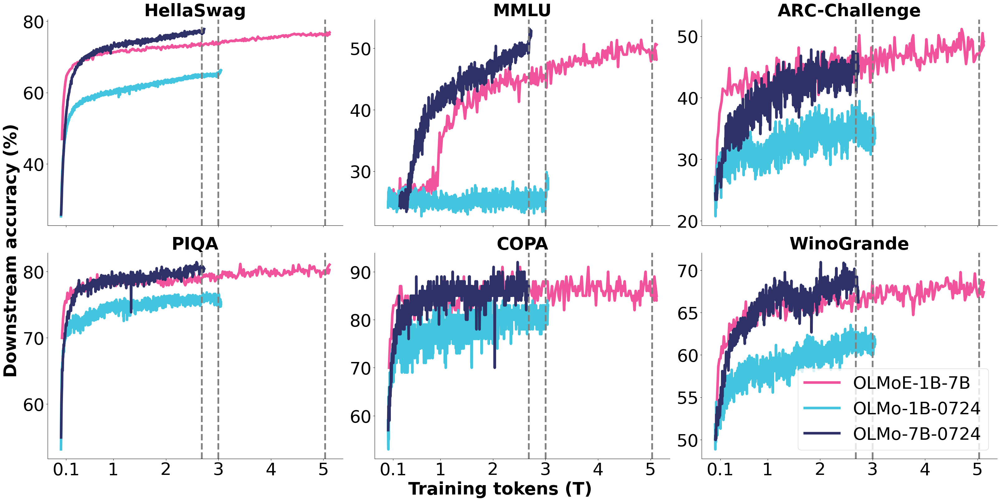

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 40
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "HellaSwag",
    "MMLU", # MC
    "ARC-Challenge",
    "PIQA",
    "COPA",
    "WinoGrande",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
]

data = [
  (down_moe_hellaswag, down_small_hellaswag, down_big_hellaswag),
  (down_moe_mmlu, down_small_mmlu, down_big_mmlu),
  (down_moe_arcc, down_small_arcc, down_big_arcc),
  (down_moe_piqa, down_small_piqa, down_big_piqa),
  (down_moe_copa, down_small_copa, down_big_copa),
  (down_moe_winogrande, down_small_winogrande, down_big_winogrande),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1]*100 for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-1B-7B",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1]*100 for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="OLMo-1B-0724",
    )
    ax.plot(
        [x[0] for x in data[i][2]],
        [x[1]*100 for x in data[i][2]],
        linewidth=6.0,
        color=colors[2],
        label="OLMo-7B-0724",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    #if i == 1:
    #ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [0.1, 1, 2, 3, 4, 5]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e12 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Draw anneal vertical lines
    ax.axvline(x=1200000, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][0][-1][1]-0.05, ymax=data[i][0][-1][1]+0.05)
    ax.axvline(x=1431000//2, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][1][-1][1]-0.05, ymax=data[i][1][-1][1]+0.05)
    ax.axvline(x=639650, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][2][-1][1]-0.05, ymax=data[i][2][-1][1]+0.05)


#    if i == 1:
#      # Legend
#      ax.legend(
#          fontsize=FONTSIZE,
#          frameon=False,
#          loc='upper center',
#      )


    # Set ylims
    """
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )
    """



plt.legend(fontsize=FONTSIZE, frameon=True)

fig.supylabel('Downstream accuracy (%)', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Training tokens (T)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('trainingevaltokens.pdf', dpi=300, bbox_inches='tight')
plt.show()

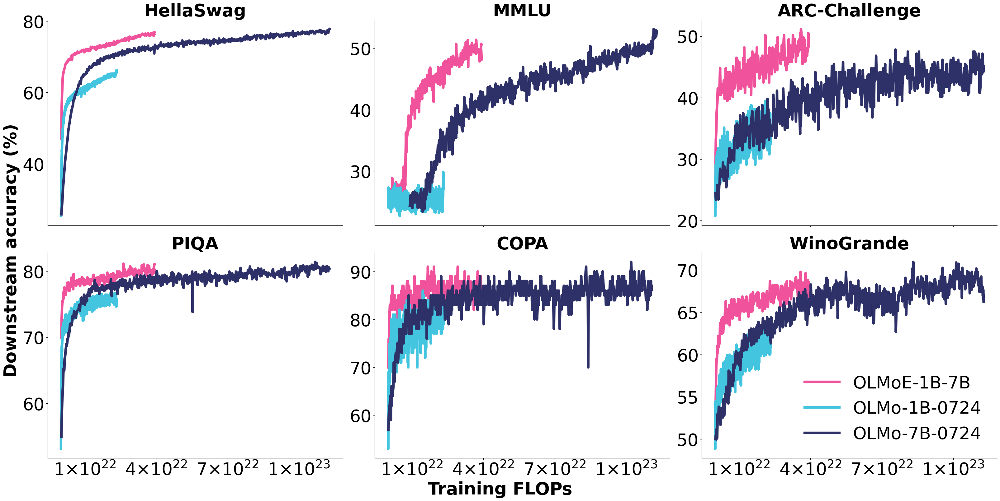

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 40
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "HellaSwag",
    "MMLU", # MC
    "ARC-Challenge",
    "PIQA",
    "COPA",
    "WinoGrande",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
]

data = [
  (down_moe_hellaswag, down_small_hellaswag, down_big_hellaswag),
  (down_moe_mmlu, down_small_mmlu, down_big_mmlu),
  (down_moe_arcc, down_small_arcc, down_big_arcc),
  (down_moe_piqa, down_small_piqa, down_big_piqa),
  (down_moe_copa, down_small_copa, down_big_copa),
  (down_moe_winogrande, down_small_winogrande, down_big_winogrande),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*1.28*1e9*6 for x in data[i][0]],
        [x[1]*100 for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-1B-7B",
    )
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*1.28*1e9*6 for x in data[i][1]],
        [x[1]*100 for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="OLMo-1B-0724",
    )
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*6.89*1e9*6 for x in data[i][2]],
        [x[1]*100 for x in data[i][2]],
        linewidth=6.0,
        color=colors[2],
        label="OLMo-7B-0724",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    #if i == 1:
    #ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    # Make logarithmic
    #ax.set_xscale("log")

    x_ticks_loc = [1e22, 4*1e22, 7*1e22, 1e23]
    # "$7 × 10^{22}$", "$3 × 10^{22}$",
    x_ticks = ["$1 × 10^{22}$", "$4 × 10^{22}$", "$7 × 10^{22}$", "$1 × 10^{23}$"]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Draw anneal vertical lines
    # ax.axvline(x=1200000, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][0][-1][1]-0.05, ymax=data[i][0][-1][1]+0.05)
    # ax.axvline(x=1431000//2, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][1][-1][1]-0.05, ymax=data[i][1][-1][1]+0.05)
    # ax.axvline(x=639650, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][2][-1][1]-0.05, ymax=data[i][2][-1][1]+0.05)

#    if i == 1:
#      # Legend
#      ax.legend(
#          fontsize=FONTSIZE,
#          frameon=False,
#          loc='upper center',
#      )

    """
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )
    """

plt.legend(fontsize=FONTSIZE, frameon=False)

# https://stackoverflow.com/questions/16150819/common-xlabel-ylabel-for-matplotlib-subplots
#fig.add_subplot(111, frameon=False)
# hide tick and tick label of the big axis
#plt.tick_params(labelcolor='none', which='both', top=False, bottom=False, left=False, right=False)
#plt.xlabel("common X", fontsize=FONTSIZE)
#plt.ylabel("common Y", fontsize=FONTSIZE)

fig.supylabel('Downstream accuracy (%)', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Training FLOPs', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('trainingevalflops.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# https://stackoverflow.com/questions/42281844/what-is-the-mathematics-behind-the-smoothing-parameter-in-tensorboards-scalar
def smooth(scalars, weight: float):  # Weight between 0 and 1
    last = scalars[0]  # First value in the plot (first timestep)
    smoothed = list()
    for point in scalars:
        smoothed_val = last * weight + (1 - weight) * point  # Calculate smoothed value
        smoothed.append(smoothed_val)                        # Save it
        last = smoothed_val                                  # Anchor the last smoothed value

    return smoothed

FONTSIZE = 40
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "HellaSwag",
    "MMLU", # MC
    "ARC-Challenge",
    "PIQA",
    "COPA",
    "WinoGrande",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
]

data = [
  (down_moe_hellaswag, down_small_hellaswag, down_big_hellaswag),
  (down_moe_mmlu, down_small_mmlu, down_big_mmlu),
  (down_moe_arcc, down_small_arcc, down_big_arcc),
  (down_moe_piqa, down_small_piqa, down_big_piqa),
  (down_moe_copa, down_small_copa, down_big_copa),
  (down_moe_winogrande, down_small_winogrande, down_big_winogrande),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*1.28*1e9*6 for x in data[i][0]],
        smooth([x[1]*100 for x in data[i][0]], 0.9),
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-1B-7B",
    )
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*1.28*1e9*6 for x in data[i][1]],
        smooth([x[1]*100 for x in data[i][1]], 0.9),
        linewidth=6.0,
        color=colors[1],
        label="OLMo-1B (0724)",
    )
    ax.plot(
        [(x[0]*TOKENS_PER_STEP)*6.89*1e9*6 for x in data[i][2]],
        smooth([x[1]*100 for x in data[i][2]], 0.9),
        linewidth=6.0,
        color=colors[2],
        label="OLMo-7B (0724)",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    #if i == 1:
    #ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    # Make logarithmic
    #ax.set_xscale("log")

    x_ticks_loc = [1e22, 4*1e22, 7*1e22, 1e23]
    # "$7 × 10^{22}$", "$3 × 10^{22}$",
    x_ticks = ["$1 × 10^{22}$", "$4 × 10^{22}$", "$7 × 10^{22}$", "$1 × 10^{23}$"]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Draw anneal vertical lines
    # ax.axvline(x=1200000, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][0][-1][1]-0.05, ymax=data[i][0][-1][1]+0.05)
    # ax.axvline(x=1431000//2, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][1][-1][1]-0.05, ymax=data[i][1][-1][1]+0.05)
    # ax.axvline(x=639650, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][2][-1][1]-0.05, ymax=data[i][2][-1][1]+0.05)

#    if i == 1:
#      # Legend
#      ax.legend(
#          fontsize=FONTSIZE,
#          frameon=False,
#          loc='upper center',
#      )

    """
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )
    """

plt.legend(fontsize=FONTSIZE, frameon=False)

# https://stackoverflow.com/questions/16150819/common-xlabel-ylabel-for-matplotlib-subplots
#fig.add_subplot(111, frameon=False)
# hide tick and tick label of the big axis
#plt.tick_params(labelcolor='none', which='both', top=False, bottom=False, left=False, right=False)
#plt.xlabel("common X", fontsize=FONTSIZE)
#plt.ylabel("common Y", fontsize=FONTSIZE)

fig.supylabel('Downstream accuracy (%)', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Training FLOPs', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('trainingevalflops.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 40
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "HellaSwag",
    "MMLU", # MC
    "ARC-Challenge",
    "PIQA",
    "COPA",
    "WinoGrande",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
]

data = [
  (down_moe_hellaswag, down_small_hellaswag, down_big_hellaswag),
  (down_moe_mmlu, down_small_mmlu, down_big_mmlu),
  (down_moe_arcc, down_small_arcc, down_big_arcc),
  (down_moe_piqa, down_small_piqa, down_big_piqa),
  (down_moe_copa, down_small_copa, down_big_copa),
  (down_moe_winogrande, down_small_winogrande, down_big_winogrande),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        smooth([x[1]*100 for x in data[i][0]], 0.9),
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-1B-7B",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        smooth([x[1]*100 for x in data[i][1]], 0.9),
        linewidth=6.0,
        color=colors[1],
        label="OLMo-1B (0724)",
    )
    ax.plot(
        [x[0] for x in data[i][2]],
        smooth([x[1]*100 for x in data[i][2]], 0.9),
        linewidth=6.0,
        color=colors[2],
        label="OLMo-7B (0724)",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    #if i == 1:
    #ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [0.1, 1, 2, 3, 4, 5]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e12 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Draw anneal vertical lines
    ax.axvline(x=1200000, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][0][-1][1]-0.05, ymax=data[i][0][-1][1]+0.05)
    ax.axvline(x=1431000//2, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][1][-1][1]-0.05, ymax=data[i][1][-1][1]+0.05)
    ax.axvline(x=639650, color='grey', linestyle='--', linewidth=4)#, ymin=data[i][2][-1][1]-0.05, ymax=data[i][2][-1][1]+0.05)


#    if i == 1:
#      # Legend
#      ax.legend(
#          fontsize=FONTSIZE,
#          frameon=False,
#          loc='upper center',
#      )


    # Set ylims
    """
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )
    """



plt.legend(fontsize=FONTSIZE, frameon=True)

fig.supylabel('Downstream accuracy (%)', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Training tokens (T)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('trainingevaltokens.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### MoE vs Dense v2

In [ ]:
DATA_MOE = copy.deepcopy(DATA)
get_data(DATA_MOE, "_moe_cx5", [("3f30yxub", 5000), ("f2f4y0md", 35000),])
print(len(DATA_MOE["train"][1]))

Run ID: 3f30yxub
Run ID: f2f4y0md
15000


In [ ]:
DATA_DENSE = copy.deepcopy(DATA)
get_data(DATA_DENSE, "_dense_cx5", [("viysqf9q", 10000), ("de8xt7jl", 35000),])
print(len(DATA_DENSE["train"][1]))

Run ID: viysqf9q
Run ID: de8xt7jl
20000


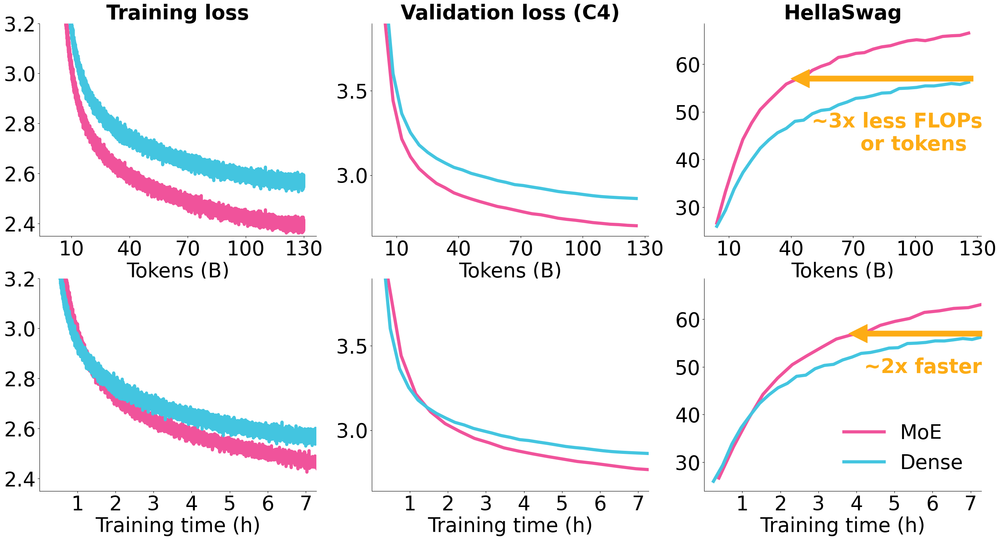

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 38
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2)

titles = [
    "Training loss",
    "Validation loss (C4)",
    "HellaSwag",# (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

dark_yellow = "#fdac15"#"#fdb415"

data = [
  (DATA_MOE["train"], DATA_DENSE["train"]),
  (DATA_MOE["val_c4"], DATA_DENSE["val_c4"]),
#  (DATA_NEWDS["val_pile"], DATA_OLDDS["val_pile"]),
  (DATA_MOE["down_hellaswag"], DATA_DENSE["down_hellaswag"]),
#  (DATA_NEWDS["down_mmlu_var"], DATA_OLDDS["down_mmlu_var"]),
#  (DATA_NEWDS["down_arcc"], DATA_OLDDS["down_arcc"]),
]


for i, ax in enumerate(axes[0].flatten()):
    mult = 100 if i == 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="MoE",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Dense",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    if i == 1:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.35, 3.2])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.64, 3.9])
    if i == 2:
        ax.annotate(
            '',
            xy=(40e9/TOKENS_PER_STEP, 57),
            xycoords='data',
            xytext=(128e9/TOKENS_PER_STEP, 57),
            textcoords='data',
            va='top', ha='left',
            fontsize=FONTSIZE,
            arrowprops=dict(width=10, headwidth=35, headlength=35, color=dark_yellow),
            # color=colors[3]
            #, shrink=0.0),
            #arrowprops=dict(mutation_scale=1000, color=colors[3])#, shrink=0.05)#arrowstyle='->, head_width=10',
            #arrowprops=dict(arrowstyle='->,head_width=10,width=10', mutation_scale=100, color=colors[3])#, shrink=0.05)#arrowstyle='->, head_width=10',
            # Increase head size
            #arrowprops=dict(arrowstyle='->, head_length=.4, head_width=.4, tail_width=.4'), #head_width=10
        )

        ax.annotate(
            '~3x less FLOPs\n       or tokens',
            xy=(50e9/TOKENS_PER_STEP, 50),
            xycoords='data',
            xytext=(50e9/TOKENS_PER_STEP, 50),
            textcoords='data',
            color=dark_yellow,
            va='top', ha='left',
            fontsize=FONTSIZE,
            fontweight='bold',
        )

TOKENS_PER_STEP = 4096 * 1024
TOKS_PER_D_PER_S_MOE = 23600
TOKS_PER_D_PER_S_D = 37500

NUM_GPUS = 16 * 8

losses_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_MOE["train"][1]]
losses_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_DENSE["train"][1]]

val_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_MOE["val_c4"][1]]
val_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_DENSE["val_c4"][1]]

down_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_MOE["down_hellaswag"][1]]
down_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in DATA_DENSE["down_hellaswag"][1]]

data = [
  (losses_moe_adj, losses_d_adj),
  (val_moe_adj, val_d_adj),
  ([(x, y*100) for (x, y) in down_moe_adj], [(x, y*100) for (x, y) in down_d_adj]),
]

for i, ax in enumerate(axes[1].flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="MoE",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Dense",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Training time (h)", fontsize=FONTSIZE)
    # Round yticks
    if i == 1:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    #ax.set_title(titles[i], fontsize=FONTSIZE)

    # If only showing up to where dense finishes; if want to show full, then comment this out
    x_ticks = [1, 2, 3, 4, 5, 6, 7]
    x_ticks_loc = [x for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)
    ax.set_xlim([0, 7.28])

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.35, 3.2])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.64, 3.9])

    #if i == 1:
    #  ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 2:
        ax.annotate(
            '',
            xy=(3.8, 57),
            xycoords='data',
            xytext=(7.3, 57),
            textcoords='data',
            va='top', ha='left',
            fontsize=FONTSIZE,
            arrowprops=dict(width=10, headwidth=35, headlength=35, color=dark_yellow),#'black'),
        )

        ax.annotate(
            '~2x faster',
            xy=(4.2, 52),
            xycoords='data',
            xytext=(4.2, 52),
            textcoords='data',
            color=dark_yellow,#colors[3],
            va='top', ha='left',
            fontsize=FONTSIZE,
            fontweight='bold',
        )

plt.legend(fontsize=FONTSIZE, frameon=False)

plt.savefig('moevsdense.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### New vs Old Dataset

In [ ]:
DATA_OLDDS = copy.deepcopy(DATA)
get_data(DATA_OLDDS, "_oldds_cx5", [("qpymu2us", 35000)])
print(len(DATA_OLDDS["train"][1]))

Run ID: qpymu2us
10000


In [ ]:
DATA_NEWDS = copy.deepcopy(DATA)
get_data(DATA_NEWDS, "_newds_cx5", [("e4apaebs", 35000)])
print(len(DATA_NEWDS["train"][1]))

Run ID: e4apaebs
10000


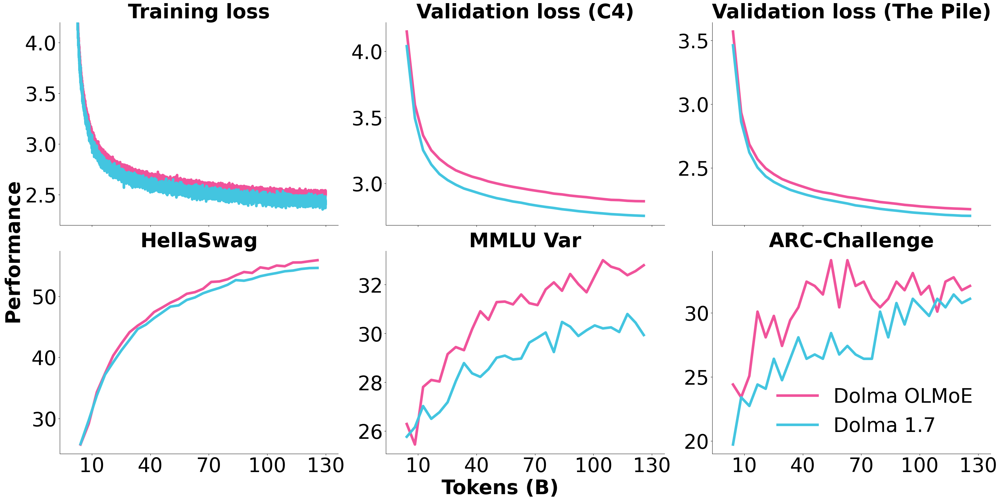

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag",
    "MMLU Var",
    "ARC-Challenge",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NEWDS["train"], DATA_OLDDS["train"]),
  (DATA_NEWDS["val_c4"], DATA_OLDDS["val_c4"]),
  (DATA_NEWDS["val_pile"], DATA_OLDDS["val_pile"]),
  (DATA_NEWDS["down_hellaswag"], DATA_OLDDS["down_hellaswag"]),
  (DATA_NEWDS["down_mmlu_var"], DATA_OLDDS["down_mmlu_var"]),
  (DATA_NEWDS["down_arcc"], DATA_OLDDS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-Mix",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Dolma 1.7",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    elif i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 4.2])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('dataset.pdf', dpi=300, bbox_inches='tight')
plt.show()

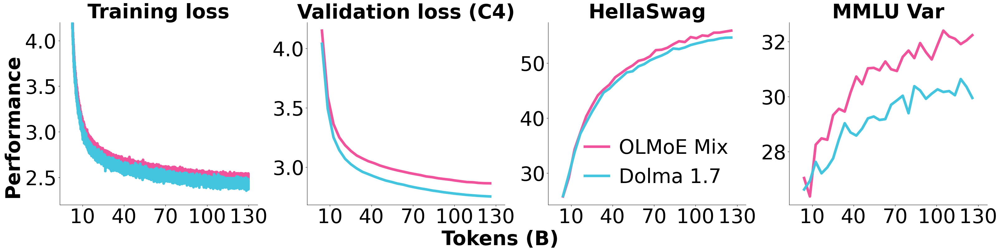

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "HellaSwag",
    "MMLU Var",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NEWDS["train"], DATA_OLDDS["train"]),
  (DATA_NEWDS["val_c4"], DATA_OLDDS["val_c4"]),
#  (DATA_NEWDS["val_pile"], DATA_OLDDS["val_pile"]),
  (DATA_NEWDS["down_hellaswag"], DATA_OLDDS["down_hellaswag"]),
  (DATA_NEWDS["down_mmlu_var"], DATA_OLDDS["down_mmlu_var"]),
#  (DATA_NEWDS["down_arcc"], DATA_OLDDS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-Mix",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Dolma 1.7",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 2:
        ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    elif i >= 2:
        ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
        ax.legend(fontsize=FONTSIZE, frameon=False, handletextpad=0.5, handlelength=1.2)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 4.2])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('dataset.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
#    "Validation loss (C4)",
    "HellaSwag",
    "MMLU Var",
    "ARC-Challenge",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NEWDS["train"], DATA_OLDDS["train"]),
#  (DATA_NEWDS["val_c4"], DATA_OLDDS["val_c4"]),
#  (DATA_NEWDS["val_pile"], DATA_OLDDS["val_pile"]),
  (DATA_NEWDS["down_hellaswag"], DATA_OLDDS["down_hellaswag"]),
  (DATA_NEWDS["down_mmlu_var"], DATA_OLDDS["down_mmlu_var"]),
  (DATA_NEWDS["down_arcc"], DATA_OLDDS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-Mix",
        #alpha=0.7,
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Dolma 1.7",
        #alpha=0.7,
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 2:
        ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    elif i >= 2:
        ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 1:
        ax.legend(fontsize=FONTSIZE, frameon=False, handletextpad=0.5, handlelength=1.2)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 4.2])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('dataset.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Adding Reddit / FLAN to data

In [ ]:
DATA_MORE = {
    "train": [["train/CrossEntropyLoss"], []],
    "val_c4": [["eval/c4_en-validation/CrossEntropyLoss"], []],
    "val_pile": [["eval/pile-validation/CrossEntropyLoss"], []],
    "down_hellaswag": [["eval/downstream/hellaswag_len_norm"], []],
    "down_mmlu_var": [mmlu_keys_var, []],
    "down_arcc": [["eval/downstream/arc_challenge_len_norm"], []],
    "down_arce": [["eval/downstream/arc_easy_acc"], []],
    "down_piqa": [["eval/downstream/piqa_len_norm"], []],
    "down_winogrande": [["eval/downstream/winogrande_acc"], []],
    "down_boolq": [["eval/downstream/boolq_acc"], []],
    "down_copa": [["eval/downstream/copa_acc"], []],
    "down_siqa": [["eval/downstream/social_iqa_len_norm"], []],
}

In [ ]:
DATA_NEWDS = copy.deepcopy(DATA_MORE)
get_data(DATA_NEWDS, "_newds_cx5", [("e4apaebs", 35000)], check_steps=True)
print(len(DATA_NEWDS["train"][1]))

Run ID: e4apaebs
10000


In [ ]:
DATA_NEWDS_REDDIT = copy.deepcopy(DATA_MORE)
get_data(DATA_NEWDS_REDDIT, "_newds_cx5_reddit", [("h7trt4e5", 5000), ("p1jnerfu", 35000)], check_steps=True)
print(len(DATA_NEWDS_REDDIT["train"][1]))

Run ID: h7trt4e5
Run ID: p1jnerfu
13110


In [ ]:
DATA_NEWDS_FLAN = copy.deepcopy(DATA_MORE)
get_data(DATA_NEWDS_FLAN, "_newds_cx5_flan", [("qbxsuybn", 20000), ("t6ss2mls", 35000)], check_steps=True)
print(len(DATA_NEWDS_FLAN["train"][1]))

Run ID: qbxsuybn
Run ID: t6ss2mls
18865


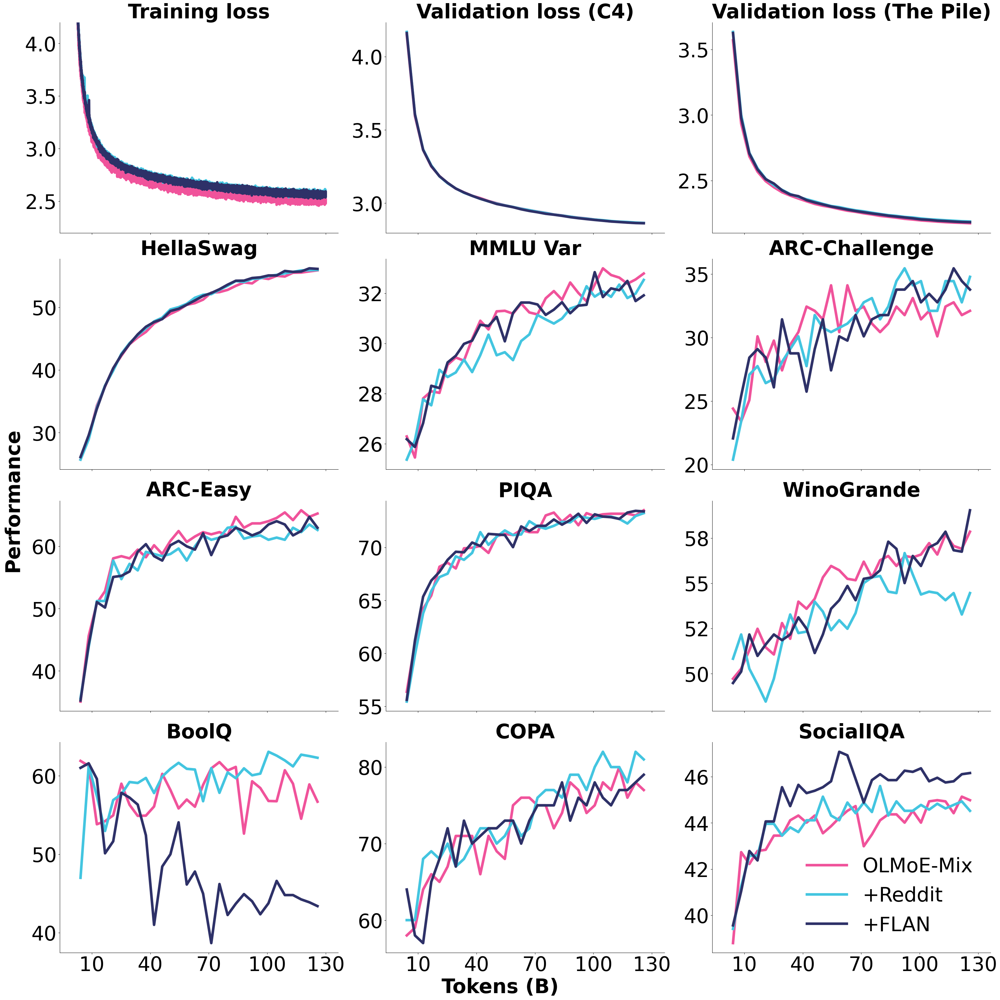

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 32), ncols=3, nrows=4, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag",
    "MMLU Var",
    "ARC-Challenge",
    "ARC-Easy",
    "PIQA",
    "WinoGrande",
    "BoolQ",
    "COPA",
    "SocialIQA",

]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NEWDS["train"], DATA_NEWDS_REDDIT["train"], DATA_NEWDS_FLAN["train"]),
  (DATA_NEWDS["val_c4"], DATA_NEWDS_REDDIT["val_c4"], DATA_NEWDS_FLAN["val_c4"]),
  (DATA_NEWDS["val_pile"], DATA_NEWDS_REDDIT["val_pile"], DATA_NEWDS_FLAN["val_pile"]),
  (DATA_NEWDS["down_hellaswag"], DATA_NEWDS_REDDIT["down_hellaswag"], DATA_NEWDS_FLAN["down_hellaswag"]),
  (DATA_NEWDS["down_mmlu_var"], DATA_NEWDS_REDDIT["down_mmlu_var"], DATA_NEWDS_FLAN["down_mmlu_var"]),
  (DATA_NEWDS["down_arcc"], DATA_NEWDS_REDDIT["down_arcc"], DATA_NEWDS_FLAN["down_arcc"]),
  (DATA_NEWDS["down_arce"], DATA_NEWDS_REDDIT["down_arce"], DATA_NEWDS_FLAN["down_arce"]),
  (DATA_NEWDS["down_piqa"], DATA_NEWDS_REDDIT["down_piqa"], DATA_NEWDS_FLAN["down_piqa"]),
  (DATA_NEWDS["down_winogrande"], DATA_NEWDS_REDDIT["down_winogrande"], DATA_NEWDS_FLAN["down_winogrande"]),
  (DATA_NEWDS["down_boolq"], DATA_NEWDS_REDDIT["down_boolq"], DATA_NEWDS_FLAN["down_boolq"]),
  (DATA_NEWDS["down_copa"], DATA_NEWDS_REDDIT["down_copa"], DATA_NEWDS_FLAN["down_copa"]),
  (DATA_NEWDS["down_siqa"], DATA_NEWDS_REDDIT["down_siqa"], DATA_NEWDS_FLAN["down_siqa"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="OLMoE-Mix",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="+Reddit",
    )
    ax.plot(
        [x[0] for x in data[i][2][1]],
        [x[1]*mult for x in data[i][2][1]],
        linewidth=6.0,
        color=colors[2],
        label="+FLAN",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    elif i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 4.2])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('datasetredditflan.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Granularity

In [ ]:
# mlp_ratio = 1
DATA_FINEONE = copy.deepcopy(DATA)
get_data(DATA_FINEONE, "_fine1_cx5", [("3f30yxub", 5000), ("f2f4y0md", 35000)])
print(len(DATA_FINEONE["train"][1]))

Run ID: 3f30yxub
Run ID: f2f4y0md
15000


In [ ]:
# mlp_ratio = 2
DATA_FINE = copy.deepcopy(DATA)
get_data(DATA_FINE, "_fine_cx5", [("xpi5ggdl", 20000), ("1vc8456a", 35000)], check_steps=True)
print(len(DATA_FINE["train"][1]))

Run ID: xpi5ggdl
Run ID: 1vc8456a
18426


In [ ]:
# mlp_ratio = 8
DATA_COARSE = copy.deepcopy(DATA)
get_data(DATA_COARSE, "_coarse_cx5", [("rqx4vr1l", 35000)])
print(len(DATA_COARSE["train"][1]))

Run ID: rqx4vr1l
10000


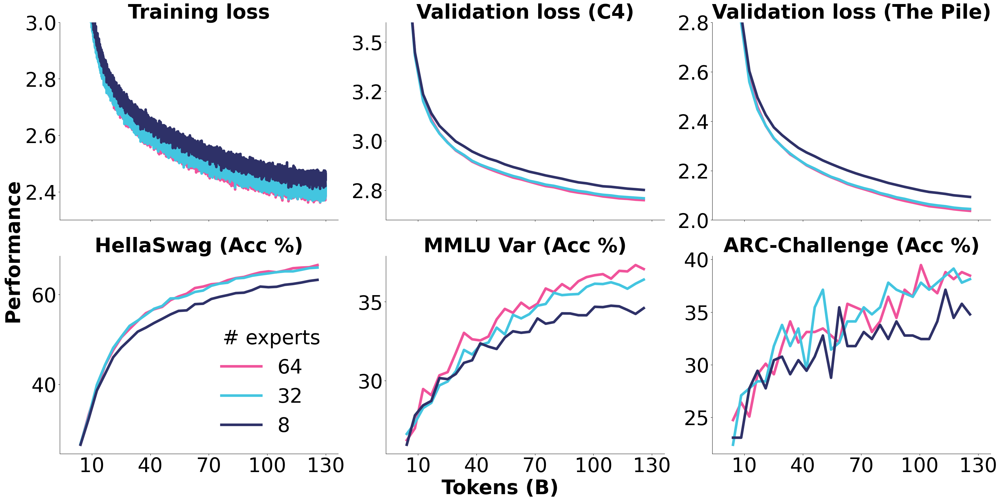

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_FINEONE["train"], DATA_FINE["train"], DATA_COARSE["train"]),
  (DATA_FINEONE["val_c4"], DATA_FINE["val_c4"], DATA_COARSE["val_c4"]),
  (DATA_FINEONE["val_pile"], DATA_FINE["val_pile"], DATA_COARSE["val_pile"]),
  (DATA_FINEONE["down_hellaswag"], DATA_FINE["down_hellaswag"], DATA_COARSE["down_hellaswag"]),
  (DATA_FINEONE["down_mmlu_var"], DATA_FINE["down_mmlu_var"], DATA_COARSE["down_mmlu_var"]),
  (DATA_FINEONE["down_arcc"], DATA_FINE["down_arcc"], DATA_COARSE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="64",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="32",
    )
    ax.plot(
        [x[0] for x in data[i][2][1]],
        [x[1]*mult for x in data[i][2][1]],
        linewidth=6.0,
        color=colors[2],
        label="8",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)
    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE)

    if i == 0:
        ax.set_ylim([2.3, 3])
    elif i == 1:
        ax.set_ylim([2.6, 3.6])
    elif i == 2:
        ax.set_ylim([2.0, 2.8])

# plt.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE, ncol=2)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('granularity.pdf', dpi=300, bbox_inches='tight')
plt.show()

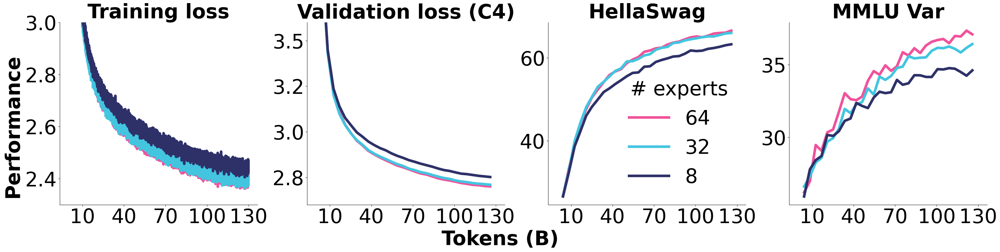

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_FINEONE["train"], DATA_FINE["train"], DATA_COARSE["train"]),
  (DATA_FINEONE["val_c4"], DATA_FINE["val_c4"], DATA_COARSE["val_c4"]),
#  (DATA_FINEONE["val_pile"], DATA_FINE["val_pile"], DATA_COARSE["val_pile"]),
  (DATA_FINEONE["down_hellaswag"], DATA_FINE["down_hellaswag"], DATA_COARSE["down_hellaswag"]),
  (DATA_FINEONE["down_mmlu_var"], DATA_FINE["down_mmlu_var"], DATA_COARSE["down_mmlu_var"]),
#  (DATA_FINEONE["down_arcc"], DATA_FINE["down_arcc"], DATA_COARSE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="64",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="32",
    )
    ax.plot(
        [x[0] for x in data[i][2][1]],
        [x[1]*mult for x in data[i][2][1]],
        linewidth=6.0,
        color=colors[2],
        label="8",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)
    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE)

    if i == 0:
        ax.set_ylim([2.3, 3])
    elif i == 1:
        ax.set_ylim([2.6, 3.6])
#    elif i == 2:
#        ax.set_ylim([2.0, 2.8])

# plt.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE, ncol=2)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('granularity.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Shared

In [ ]:
DATA_FINE = copy.deepcopy(DATA)
get_data(DATA_FINE, "_fine_cx5", [("xpi5ggdl", 20000), ("1vc8456a", 35000)], check_steps=True)
print(len(DATA_FINE["train"][1]))

Run ID: xpi5ggdl
Run ID: 1vc8456a
18423


In [ ]:
DATA_SHARED = copy.deepcopy(DATA)
get_data(DATA_SHARED, "_shared_cx5", [("ej1wq9l2", 10000), ("2wnf30xq" , 15000), ("578o89ur", 20000), ("cx5yfoul", 35000)], check_steps=True)
print(len(DATA_SHARED["train"][1]))

Run ID: ej1wq9l2
Run ID: 2wnf30xq
Run ID: 578o89ur
Run ID: cx5yfoul
27647


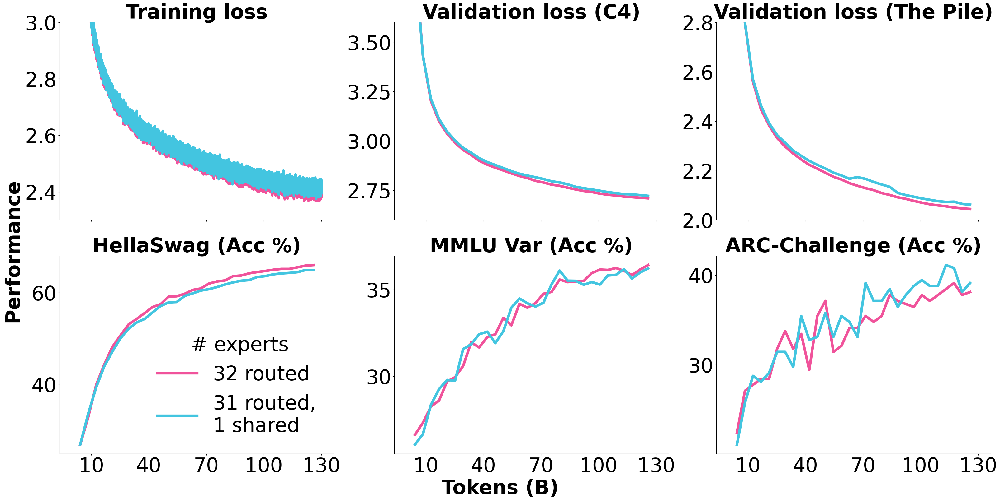

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_FINE["train"], DATA_SHARED["train"]),
  (DATA_FINE["val_c4"], DATA_SHARED["val_c4"]),
  (DATA_FINE["val_pile"], DATA_SHARED["val_pile"]),
  (DATA_FINE["down_hellaswag"], DATA_SHARED["down_hellaswag"]),
  (DATA_FINE["down_mmlu_var"], DATA_SHARED["down_mmlu_var"]),
  (DATA_FINE["down_arcc"], DATA_SHARED["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="32 routed",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="31 routed,\n1 shared",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    #x_ticks = [str(x) for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False, title=" # experts", title_fontsize=FONTSIZE)

    if i == 0:
        ax.set_ylim([2.3, 3])
    elif i == 1:
        ax.set_ylim([2.6, 3.6])
    elif i == 2:
        ax.set_ylim([2.0, 2.8])

#plt.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('shared.pdf', dpi=300, bbox_inches='tight')
plt.show()

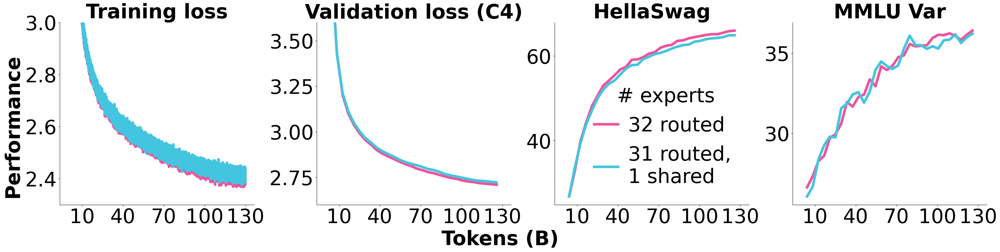

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_FINE["train"], DATA_SHARED["train"]),
  (DATA_FINE["val_c4"], DATA_SHARED["val_c4"]),
#  (DATA_FINE["val_pile"], DATA_SHARED["val_pile"]),
  (DATA_FINE["down_hellaswag"], DATA_SHARED["down_hellaswag"]),
  (DATA_FINE["down_mmlu_var"], DATA_SHARED["down_mmlu_var"]),
#  (DATA_FINE["down_arcc"], DATA_SHARED["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="32 routed",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="31 routed,\n1 shared",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    #x_ticks = [str(x) for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, title=" # experts", title_fontsize=FONTSIZE, handletextpad=0.5, handlelength=1.2)

    if i == 0:
        ax.set_ylim([2.3, 3])
    elif i == 1:
        ax.set_ylim([2.6, 3.6])
#    elif i == 2:
#        ax.set_ylim([2.0, 2.8])

#plt.legend(fontsize=FONTSIZE, frameon=False, title="   # experts", title_fontsize=FONTSIZE)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('shared.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### EC vs TC

In [ ]:
DATA_EC = copy.deepcopy(DATA)
get_data(DATA_EC, "_ec", [("cwrpsgdk", 5000), ("9217flhv", 97000)], check_steps=True)
print(len(DATA_EC["train"][1]))

Run ID: cwrpsgdk
Run ID: 9217flhv
11868


In [ ]:
DATA_TC = copy.deepcopy(DATA)
get_data(DATA_TC, "_tc", [("5qig08r2", 97000)], check_steps=True)
print(len(DATA_TC["train"][1]))

Run ID: 5qig08r2
10000


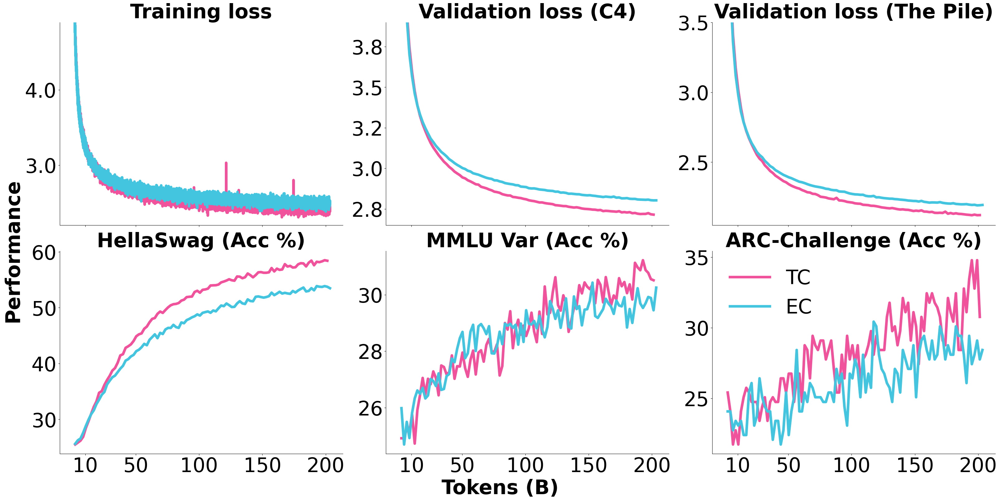

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_TC["train"], DATA_EC["train"]),
  (DATA_TC["val_c4"], DATA_EC["val_c4"]),
  (DATA_TC["val_pile"], DATA_EC["val_pile"]),
  (DATA_TC["down_hellaswag"], DATA_EC["down_hellaswag"]),
  (DATA_TC["down_mmlu_var"], DATA_EC["down_mmlu_var"]),
  (DATA_TC["down_arcc"], DATA_EC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="TC",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="EC",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 50, 100, 150, 200]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      ax.legend(fontsize=FONTSIZE, frameon=False, loc='upper center')

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 4.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.65, 3.9])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([2.05, 3.5])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('expertchoice.pdf', dpi=300, bbox_inches='tight')
plt.show()

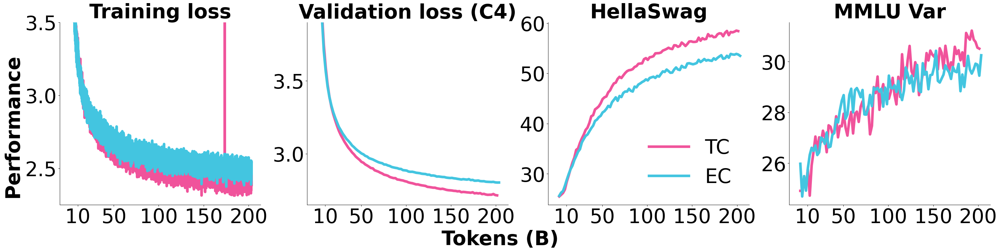

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_TC["train"], DATA_EC["train"]),
  (DATA_TC["val_c4"], DATA_EC["val_c4"]),
#  (DATA_TC["val_pile"], DATA_EC["val_pile"]),
  (DATA_TC["down_hellaswag"], DATA_EC["down_hellaswag"]),
  (DATA_TC["down_mmlu_var"], DATA_EC["down_mmlu_var"]),
#  (DATA_TC["down_arcc"], DATA_EC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="TC",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="EC",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 50, 100, 150, 200]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.25, 3.5])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.65, 3.9])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([2.05, 3.5])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('expertchoice.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Router z-Loss

In [ ]:
DATA_ZLOSS = copy.deepcopy(DATA)
moe_runs = [
    ("1g5c71j1", 30000),
    ("dd87de7e", 35000),
    ("xyfqy137", 45000),
    ("fac91t6s", 360000),
]
get_data(DATA_ZLOSS, "_zloss", moe_runs, check_steps=True)
print(len(DATA_ZLOSS["train"][1]))

Run ID: 1g5c71j1
Run ID: dd87de7e
Run ID: xyfqy137
Run ID: fac91t6s
30117


In [ ]:
DATA_NOZLOSS = copy.deepcopy(DATA)
get_data(DATA_NOZLOSS, "_nozloss", [("aq2us82x", 360000),], check_steps=True)
print(len(DATA_NOZLOSS["train"][1]))

Run ID: aq2us82x
10000


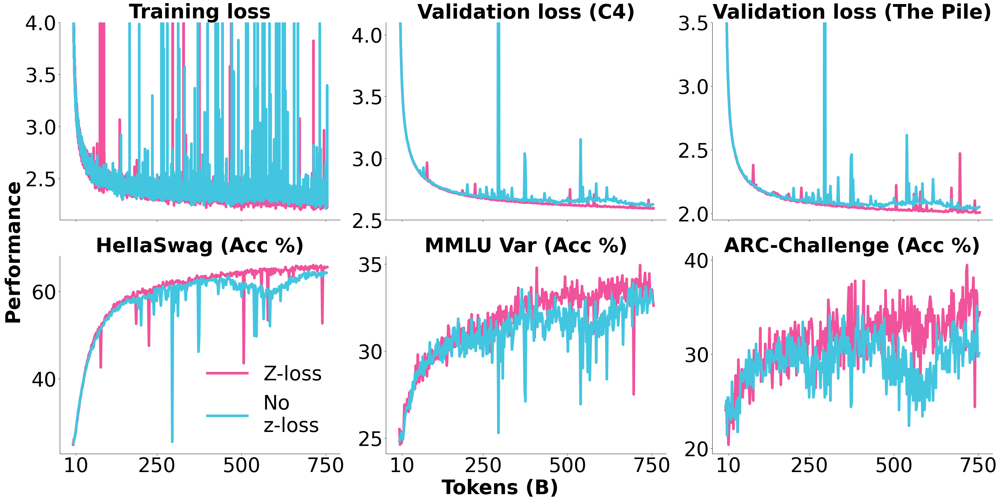

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_ZLOSS["train"], DATA_NOZLOSS["train"]),
  (DATA_ZLOSS["val_c4"], DATA_NOZLOSS["val_c4"]),
  (DATA_ZLOSS["val_pile"], DATA_NOZLOSS["val_pile"]),
  (DATA_ZLOSS["down_hellaswag"], DATA_NOZLOSS["down_hellaswag"]),
  (DATA_ZLOSS["down_mmlu_var"], DATA_NOZLOSS["down_mmlu_var"]),
  (DATA_ZLOSS["down_arcc"], DATA_NOZLOSS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Z-loss",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No\nz-loss",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 4.0])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.5, 4.1])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([1.95, 3.5])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('zloss.pdf', dpi=300, bbox_inches='tight')
plt.show()

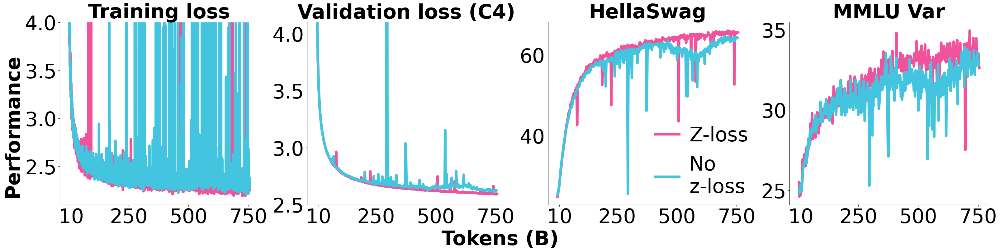

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_ZLOSS["train"], DATA_NOZLOSS["train"]),
  (DATA_ZLOSS["val_c4"], DATA_NOZLOSS["val_c4"]),
#  (DATA_ZLOSS["val_pile"], DATA_NOZLOSS["val_pile"]),
  (DATA_ZLOSS["down_hellaswag"], DATA_NOZLOSS["down_hellaswag"]),
  (DATA_ZLOSS["down_mmlu_var"], DATA_NOZLOSS["down_mmlu_var"]),
#  (DATA_ZLOSS["down_arcc"], DATA_NOZLOSS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Z-loss",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No\nz-loss",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, handletextpad=0.5, handlelength=1.2, loc=(0.5,0.0001))

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 4.0])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.5, 4.1])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([1.95, 3.5])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('zloss.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Init

In [ ]:
DATA_TRUNCINIT = copy.deepcopy(DATA)
get_data(DATA_TRUNCINIT, "_truncinit", [("rrfxe3i7", 287341),], check_steps=True)
print(len(DATA_TRUNCINIT["train"][1]))

Run ID: rrfxe3i7
9988


In [ ]:
DATA_NORMALINIT = copy.deepcopy(DATA)
get_data(DATA_NORMALINIT, "_normalinit", [("aq2us82x", 287341)], check_steps=True)
print(len(DATA_NORMALINIT["train"][1]))

Run ID: aq2us82x
7984


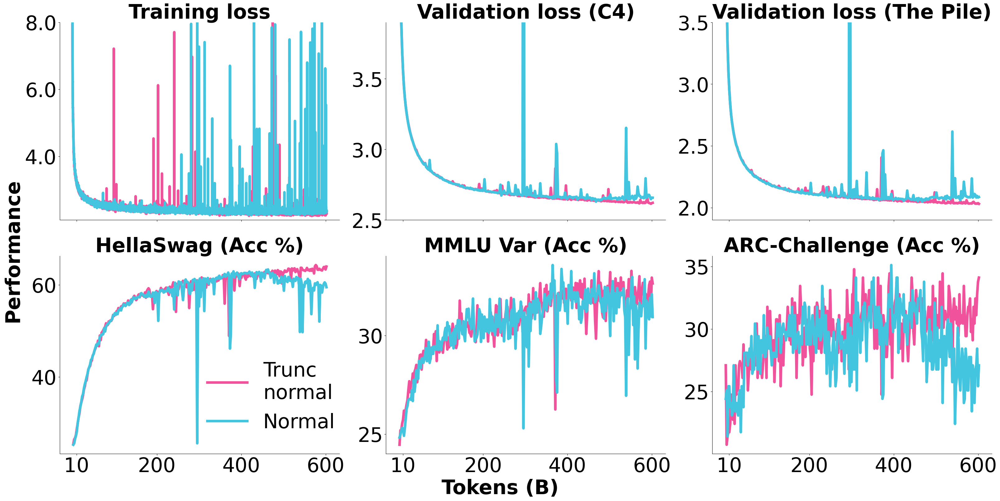

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_TRUNCINIT["train"], DATA_NORMALINIT["train"]),
  (DATA_TRUNCINIT["val_c4"], DATA_NORMALINIT["val_c4"]),
  (DATA_TRUNCINIT["val_pile"], DATA_NORMALINIT["val_pile"]),
  (DATA_TRUNCINIT["down_hellaswag"], DATA_NORMALINIT["down_hellaswag"]),
  (DATA_TRUNCINIT["down_mmlu_var"], DATA_NORMALINIT["down_mmlu_var"]),
  (DATA_TRUNCINIT["down_arcc"], DATA_NORMALINIT["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Trunc\nnormal",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Normal",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 200, 400, 600]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.5, 0.07))

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 8.0])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.5, 3.9])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([1.9, 3.5])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('init.pdf', dpi=300, bbox_inches='tight')
plt.show()

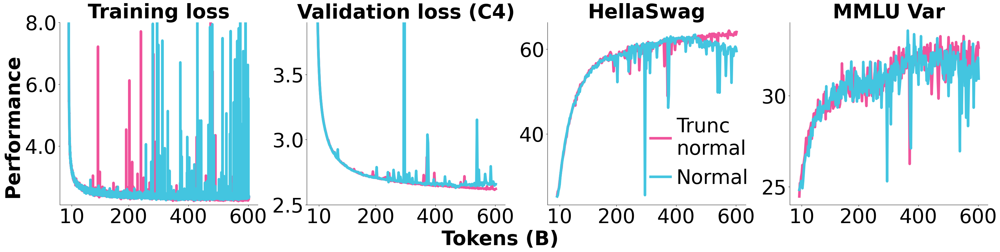

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    #"Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
    #"ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_TRUNCINIT["train"], DATA_NORMALINIT["train"]),
  (DATA_TRUNCINIT["val_c4"], DATA_NORMALINIT["val_c4"]),
#  (DATA_TRUNCINIT["val_pile"], DATA_NORMALINIT["val_pile"]),
  (DATA_TRUNCINIT["down_hellaswag"], DATA_NORMALINIT["down_hellaswag"]),
  (DATA_TRUNCINIT["down_mmlu_var"], DATA_NORMALINIT["down_mmlu_var"]),
#  (DATA_TRUNCINIT["down_arcc"], DATA_NORMALINIT["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Trunc\nnormal",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Normal",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 200, 400, 600]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.48, 0.05), handletextpad=0.3, handlelength=1.0)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 8.0])
        #ax.set_ylim([2.1, 3.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.5, 3.9])
#    elif i == 2:
#        a, b = ax.get_ylim()
#       ax.set_ylim([1.9, 3.5])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('init.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### QK Norm

In [ ]:
DATA_NOQKNORM = copy.deepcopy(DATA)
get_data(DATA_NOQKNORM, "_noqknorm", [("rrfxe3i7", 157221),], check_steps=True)
print(len(DATA_NOQKNORM["train"][1]))

Run ID: rrfxe3i7
5377


In [ ]:
DATA_QKNORM = copy.deepcopy(DATA)
get_data(DATA_QKNORM, "_qknorm", [("bjlwpyk8", 5000), ("fccwk197", 10000), ("8c3bsjbd", 157221)], check_steps=True)
print(len(DATA_QKNORM["train"][1]))

Run ID: bjlwpyk8
Run ID: fccwk197
Run ID: 8c3bsjbd
19865


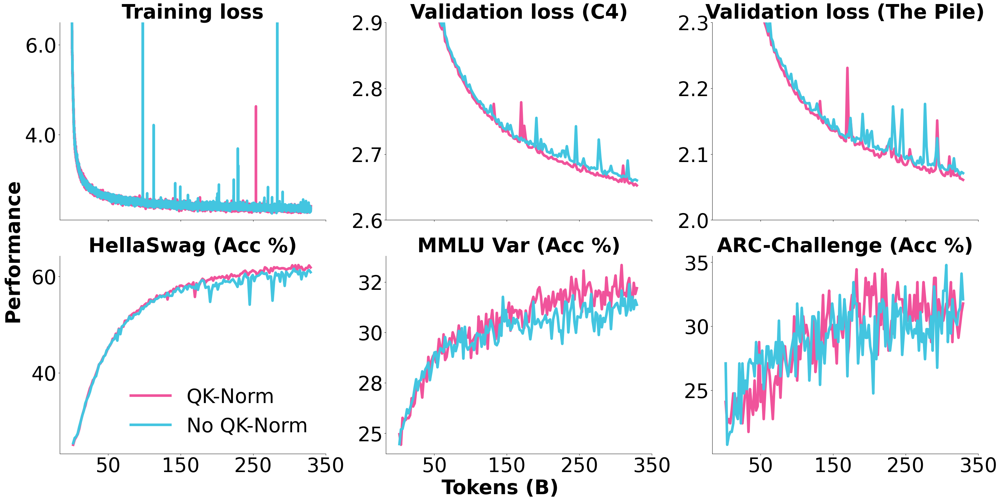

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_QKNORM["train"], DATA_NOQKNORM["train"]),
  (DATA_QKNORM["val_c4"], DATA_NOQKNORM["val_c4"]),
  (DATA_QKNORM["val_pile"], DATA_NOQKNORM["val_pile"]),
  (DATA_QKNORM["down_hellaswag"], DATA_NOQKNORM["down_hellaswag"]),
  (DATA_QKNORM["down_mmlu_var"], DATA_NOQKNORM["down_mmlu_var"]),
  (DATA_QKNORM["down_arcc"], DATA_NOQKNORM["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="QK-Norm",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No QK-Norm",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [50, 150, 250, 350]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        #ax.set_ylim([2.1, 2.9])
        ax.set_ylim([2.1, 6.5])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.6, 2.9])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 2.3])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('qknorm.pdf', dpi=300, bbox_inches='tight')
plt.show()

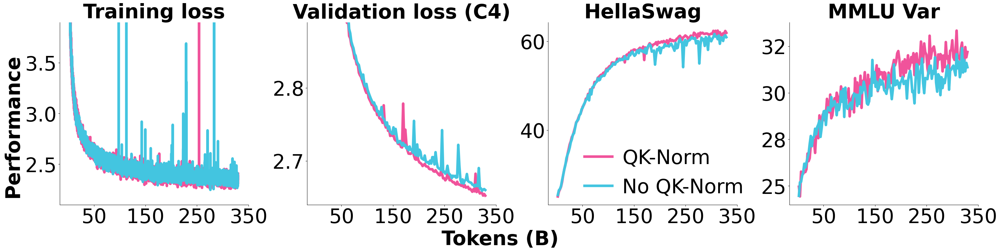

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_QKNORM["train"], DATA_NOQKNORM["train"]),
  (DATA_QKNORM["val_c4"], DATA_NOQKNORM["val_c4"]),
#  (DATA_QKNORM["val_pile"], DATA_NOQKNORM["val_pile"]),
  (DATA_QKNORM["down_hellaswag"], DATA_NOQKNORM["down_hellaswag"]),
  (DATA_QKNORM["down_mmlu_var"], DATA_NOQKNORM["down_mmlu_var"]),
#  (DATA_QKNORM["down_arcc"], DATA_NOQKNORM["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="QK-Norm",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No QK-Norm",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [50, 150, 250, 350]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.15, 0), handletextpad=0.5, handlelength=1.4)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 3.9])
        #ax.set_ylim([2.1, 6.5])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.64, 2.89])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([2.0, 2.3])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('qknorm.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### LayerNorm

In [ ]:
DATA_RMSNORM = copy.deepcopy(DATA)
get_data(DATA_RMSNORM, "_rmsnorm", [("so1ovllx", 35000), ("cgl34bsd", 52706),], check_steps=True)
print(len(DATA_RMSNORM["train"][1]))

Run ID: so1ovllx
Run ID: cgl34bsd
18999


In [ ]:
DATA_NPNORM = copy.deepcopy(DATA)
get_data(DATA_NPNORM, "_npnorm", [("pxpd0scj", 52706),], check_steps=True)
print(len(DATA_NPNORM["train"][1]))

Run ID: pxpd0scj
3584


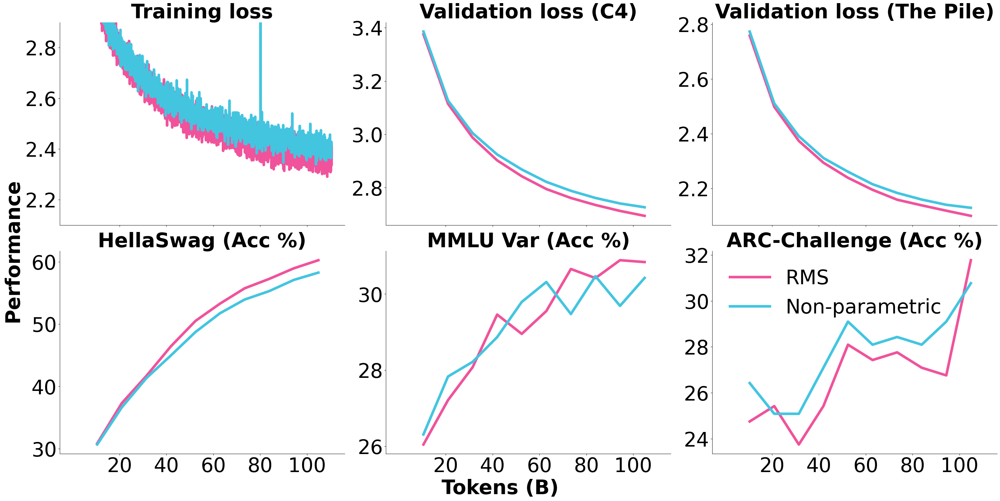

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM["train"], DATA_NPNORM["train"]),
  (DATA_RMSNORM["val_c4"], DATA_NPNORM["val_c4"]),
  (DATA_RMSNORM["val_pile"], DATA_NPNORM["val_pile"]),
  (DATA_RMSNORM["down_hellaswag"], DATA_NPNORM["down_hellaswag"]),
  (DATA_RMSNORM["down_mmlu_var"], DATA_NPNORM["down_mmlu_var"]),
  (DATA_RMSNORM["down_arcc"], DATA_NPNORM["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="RMS",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Non-parametric",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 2.9])
        #ax.set_ylim([2.1, 7.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.6, 2.9])
    #elif i == 2:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.0, 2.3])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('ln.pdf', dpi=300, bbox_inches='tight')
plt.show()

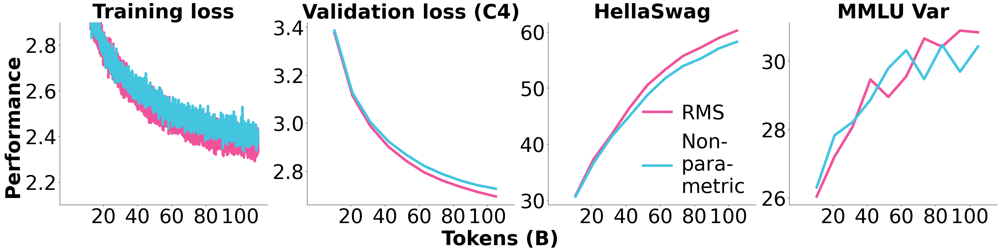

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM["train"], DATA_NPNORM["train"]),
  (DATA_RMSNORM["val_c4"], DATA_NPNORM["val_c4"]),
#  (DATA_RMSNORM["val_pile"], DATA_NPNORM["val_pile"]),
  (DATA_RMSNORM["down_hellaswag"], DATA_NPNORM["down_hellaswag"]),
  (DATA_RMSNORM["down_mmlu_var"], DATA_NPNORM["down_mmlu_var"]),
#  (DATA_RMSNORM["down_arcc"], DATA_NPNORM["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="RMS",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Non-\npara-\nmetric",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)#, width=8, length=8)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
        ax.legend(fontsize=FONTSIZE, frameon=False, handletextpad=0.5, handlelength=1.4, loc=(0.42, 0))

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.1, 2.9])
        #ax.set_ylim([2.1, 7.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.6, 2.9])
    #elif i == 2:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.0, 2.3])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('ln.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
DATA_RMSNORM_GRADNORM = {"gradnorm": [["optim/total_grad_norm"], []],}
get_data(DATA_RMSNORM_GRADNORM, "_rmsnorm_gradnorm", [("so1ovllx", 35000), ("cgl34bsd", 52706),], check_steps=True)
print(len(DATA_RMSNORM_GRADNORM["gradnorm"][1]))

Run ID: so1ovllx
Run ID: cgl34bsd
1805


In [ ]:
DATA_NPNORM_GRADNORM = {"gradnorm": [["optim/total_grad_norm"], []],}
get_data(DATA_NPNORM_GRADNORM, "_npnorm_gradnorm", [("pxpd0scj", 52706),], check_steps=True)
print(len(DATA_NPNORM_GRADNORM["gradnorm"][1]))

Run ID: pxpd0scj
3642


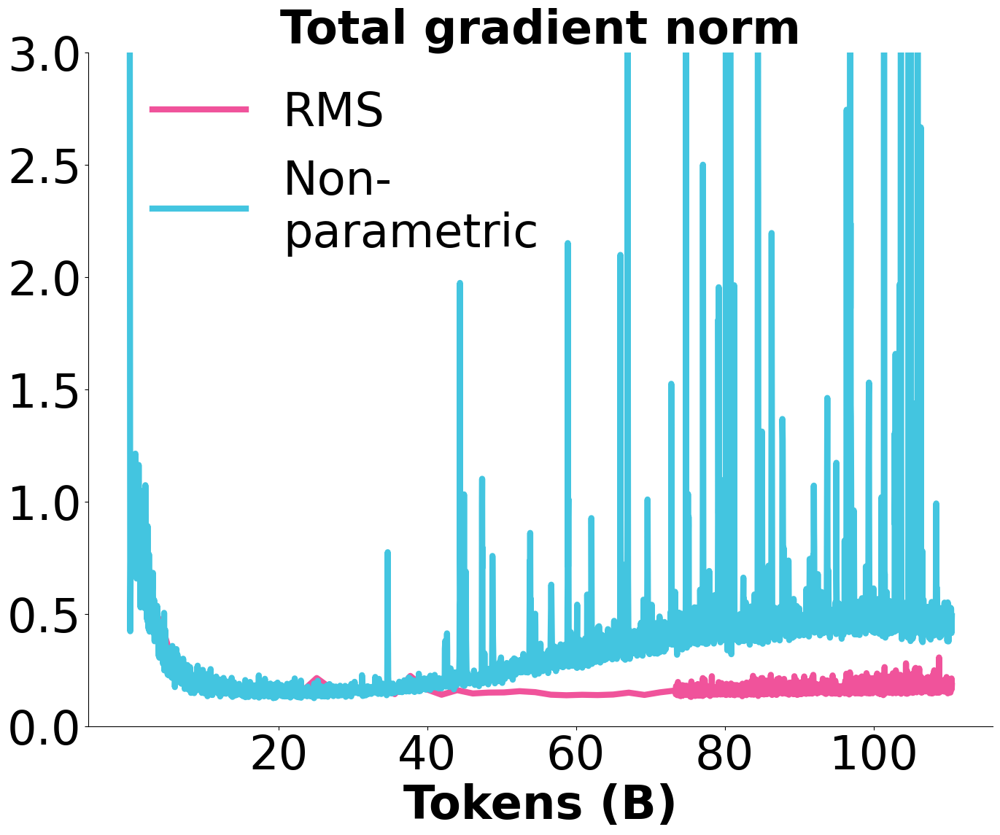

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(16, 12), ncols=1)

titles = [
    "Total gradient norm",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM_GRADNORM["gradnorm"], DATA_NPNORM_GRADNORM["gradnorm"]),
]

for i, ax in enumerate([axes]):
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1] for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="RMS",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1] for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Non-\nparametric",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([0, 3.0])

plt.legend(fontsize=FONTSIZE, frameon=False, loc=(0.05, 0.67))

plt.savefig('lngradnorm.pdf', dpi=300, bbox_inches='tight')
plt.show()

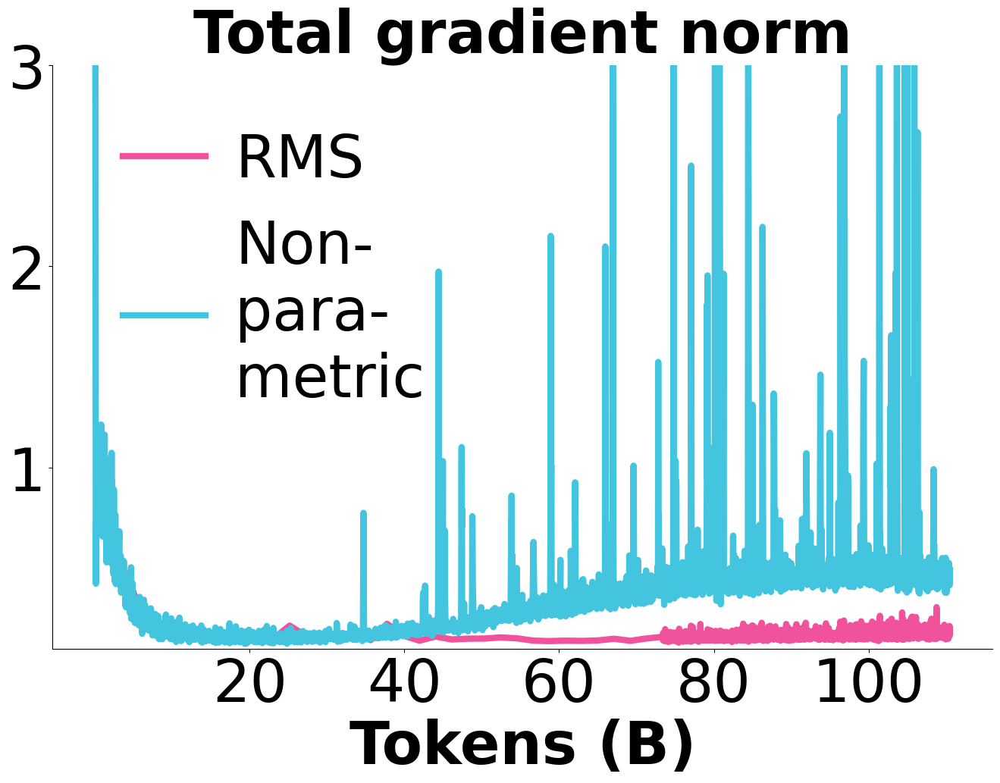

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 56
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(16, 10), ncols=1)

titles = [
    "Total gradient norm",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM_GRADNORM["gradnorm"], DATA_NPNORM_GRADNORM["gradnorm"]),
]

for i, ax in enumerate([axes]):
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1] for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="RMS",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1] for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Non-\npara-\nmetric",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([0.1, 3.0])

plt.legend(fontsize=FONTSIZE, frameon=False, loc=(0.05, 0.37), handletextpad=0.5, handlelength=1.4)

plt.savefig('lngradnorm.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Decay LayerNorm

In [ ]:
DATA_RMSNORM_DEC = copy.deepcopy(DATA)
get_data(DATA_RMSNORM_DEC, "_rmsnormdecay", [("pijx97sz", 5000), ("cfc4m3pd", 16000),], check_steps=True)
print(len(DATA_RMSNORM_DEC["train"][1]))

Run ID: pijx97sz
Run ID: cfc4m3pd
12858


In [ ]:
DATA_RMSNORM_NODEC = copy.deepcopy(DATA)
get_data(DATA_RMSNORM_NODEC, "_rmsnormnodecay", [("oyuyl7jz", 16000),], check_steps=True)
print(len(DATA_RMSNORM_NODEC["train"][1]))

Run ID: oyuyl7jz
7379


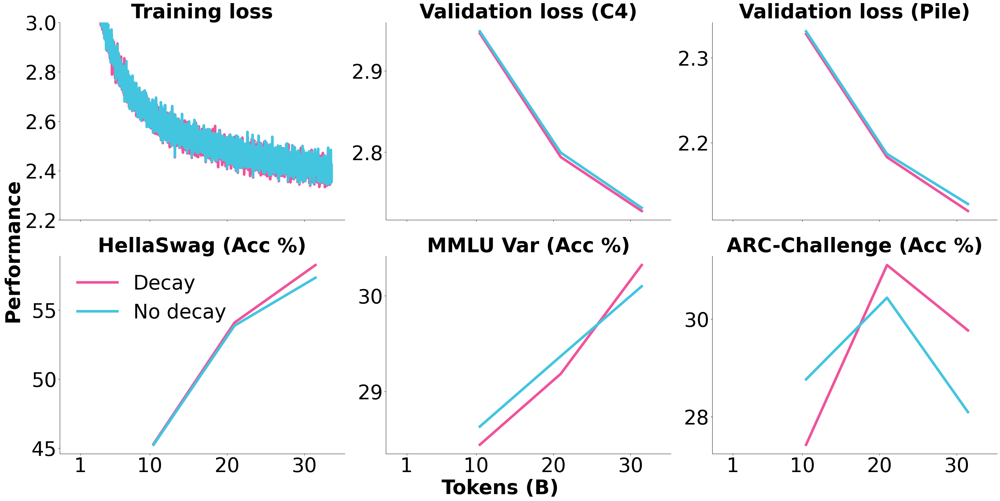

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM_DEC["train"], DATA_RMSNORM_NODEC["train"]),
  (DATA_RMSNORM_DEC["val_c4"], DATA_RMSNORM_NODEC["val_c4"]),
  (DATA_RMSNORM_DEC["val_pile"], DATA_RMSNORM_NODEC["val_pile"]),
  (DATA_RMSNORM_DEC["down_hellaswag"], DATA_RMSNORM_NODEC["down_hellaswag"]),
  (DATA_RMSNORM_DEC["down_mmlu_var"], DATA_RMSNORM_NODEC["down_mmlu_var"]),
  (DATA_RMSNORM_DEC["down_arcc"], DATA_RMSNORM_NODEC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Decay",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No decay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [1, 10, 20, 30]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 3.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lndecay.pdf', dpi=300, bbox_inches='tight')
plt.show()

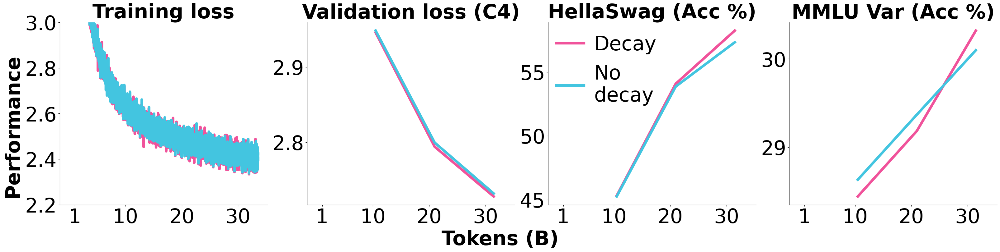

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_RMSNORM_DEC["train"], DATA_RMSNORM_NODEC["train"]),
  (DATA_RMSNORM_DEC["val_c4"], DATA_RMSNORM_NODEC["val_c4"]),
#  (DATA_RMSNORM_DEC["val_pile"], DATA_RMSNORM_NODEC["val_pile"]),
  (DATA_RMSNORM_DEC["down_hellaswag"], DATA_RMSNORM_NODEC["down_hellaswag"]),
  (DATA_RMSNORM_DEC["down_mmlu_var"], DATA_RMSNORM_NODEC["down_mmlu_var"]),
#  (DATA_RMSNORM_DEC["down_arcc"], DATA_RMSNORM_NODEC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Decay",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No\ndecay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')

    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [1, 10, 20, 30]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0, 0.5), handletextpad=0.5, handlelength=1.4)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.2, 3.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lndecay.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Decay Embedding

In [ ]:
DATA_EMB_DEC = copy.deepcopy(DATA)
get_data(DATA_EMB_DEC, "_embdecay", [("mhzp4nqe", 5000), ("fmjwqgmw", 33138),], check_steps=True)
print(len(DATA_EMB_DEC["train"][1]))

Run ID: mhzp4nqe
Run ID: fmjwqgmw
14332


In [ ]:
DATA_EMB_NODEC = copy.deepcopy(DATA)
get_data(DATA_EMB_NODEC, "_embnodecay", [("so1ovllx", 33138)], check_steps=True)
print(len(DATA_EMB_NODEC["train"][1]))

Run ID: so1ovllx
8594


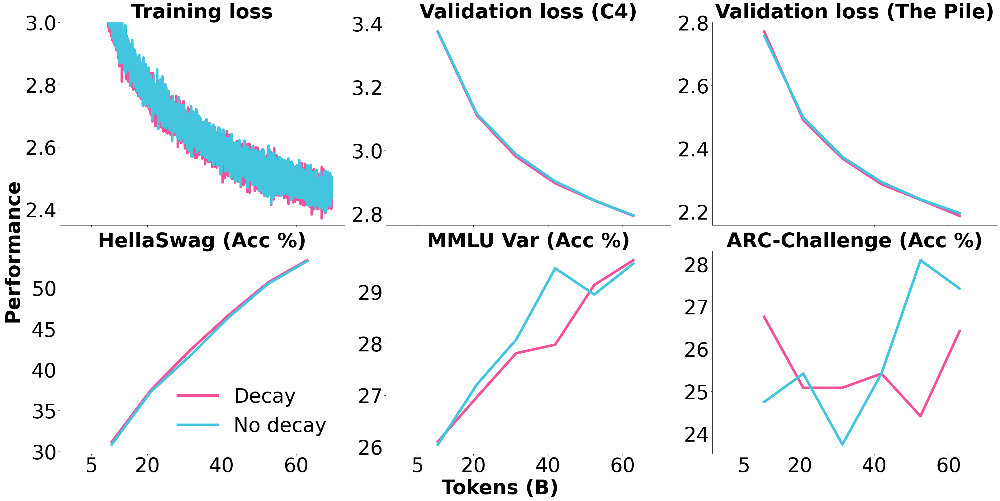

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_EMB_DEC["train"], DATA_EMB_NODEC["train"]),
  (DATA_EMB_DEC["val_c4"], DATA_EMB_NODEC["val_c4"]),
  (DATA_EMB_DEC["val_pile"], DATA_EMB_NODEC["val_pile"]),
  (DATA_EMB_DEC["down_hellaswag"], DATA_EMB_NODEC["down_hellaswag"]),
  (DATA_EMB_DEC["down_mmlu_var"], DATA_EMB_NODEC["down_mmlu_var"]),
  (DATA_EMB_DEC["down_arcc"], DATA_EMB_NODEC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Decay",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No decay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [5, 20, 40, 60]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
        ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.35, 3.0])
        #ax.set_ylim([2.1, 7.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.6, 2.9])
    #elif i == 2:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.0, 2.3])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('embdecay.pdf', dpi=300, bbox_inches='tight')
plt.show()

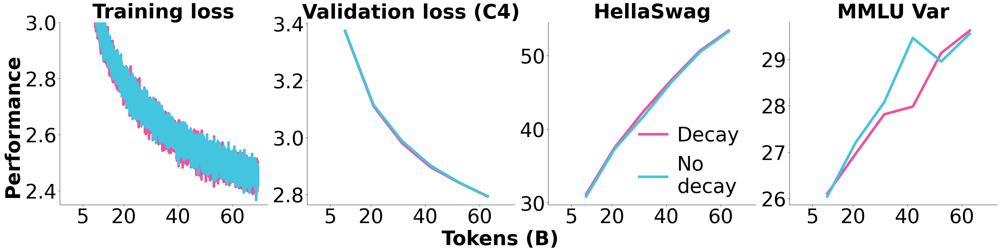

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_EMB_DEC["train"], DATA_EMB_NODEC["train"]),
  (DATA_EMB_DEC["val_c4"], DATA_EMB_NODEC["val_c4"]),
#  (DATA_EMB_DEC["val_pile"], DATA_EMB_NODEC["val_pile"]),
  (DATA_EMB_DEC["down_hellaswag"], DATA_EMB_NODEC["down_hellaswag"]),
  (DATA_EMB_DEC["down_mmlu_var"], DATA_EMB_NODEC["down_mmlu_var"]),
#  (DATA_EMB_DEC["down_arcc"], DATA_EMB_NODEC["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Decay",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No\ndecay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [5, 20, 40, 60]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
        ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.4, 0), handletextpad=0.5, handlelength=1.4)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.35, 3.0])
        #ax.set_ylim([2.1, 7.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.6, 2.9])
    #elif i == 2:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.0, 2.3])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('embdecay.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### AdamW eps

In [ ]:
DATA_LOW_EPS = copy.deepcopy(DATA)
get_data(DATA_LOW_EPS, "_loweps", [("pijx97sz", 5000), ("cfc4m3pd", 15926),], check_steps=True)
print(len(DATA_LOW_EPS["train"][1]))

Run ID: pijx97sz
Run ID: cfc4m3pd
12858


In [ ]:
DATA_HIGH_EPS = copy.deepcopy(DATA)
get_data(DATA_HIGH_EPS, "_higheps", [("mhzp4nqe", 5000), ("fmjwqgmw", 15926),], check_steps=True)
print(len(DATA_HIGH_EPS["train"][1]))

Run ID: mhzp4nqe
Run ID: fmjwqgmw
8261


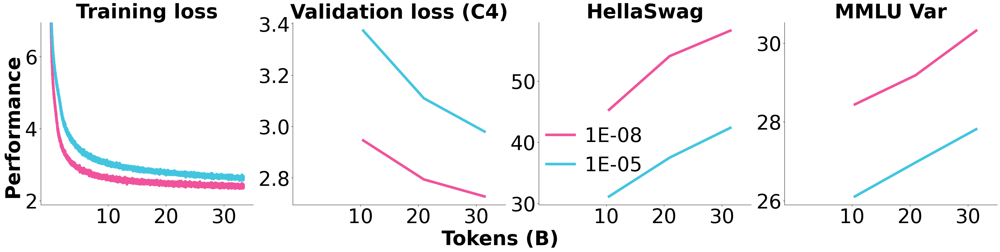

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_LOW_EPS["train"], DATA_HIGH_EPS["train"]),
  (DATA_LOW_EPS["val_c4"], DATA_HIGH_EPS["val_c4"]),
#  (DATA_LOW_EPS["val_pile"], DATA_HIGH_EPS["val_pile"]),
  (DATA_LOW_EPS["down_hellaswag"], DATA_HIGH_EPS["down_hellaswag"]),
  (DATA_LOW_EPS["down_mmlu_var"], DATA_HIGH_EPS["down_mmlu_var"]),
#  (DATA_LOW_EPS["down_arcc"], DATA_HIGH_EPS["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="1E-08",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="1E-05",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 20, 30]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
        ax.legend(fontsize=FONTSIZE, frameon=False, handletextpad=0.5, handlelength=1.4, loc=(0,0.12),)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([a, 6.95])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('adamweps.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Upcycle v Scratch

In [ ]:
DATA_SCRATCH = copy.deepcopy(DATA)
runs = [
    ("1g5c71j1", 30000),
    ("dd87de7e", 35000),
    ("xyfqy137", 45000),
    ("fac91t6s", 291436),
]
get_data(DATA_SCRATCH, "_scratch", runs, check_steps=True)
print(len(DATA_SCRATCH["train"][1]))

Run ID: 1g5c71j1
Run ID: dd87de7e
Run ID: xyfqy137
Run ID: fac91t6s
28673


In [ ]:
DATA_UPCYCLE = copy.deepcopy(DATA)
runs = [
    ("1w3srbb3", 5000),
    ("upvag6sw", 40000),
    ("n82uid74", 120000),
    ("leq6x4wa", 160000),
    ("wb2g00d2", 205000),
    ("r7tzdufe", 291436),
]
get_data(DATA_UPCYCLE, "_upcycle", runs, check_steps=True)
print(len(DATA_UPCYCLE["train"][1]))

Run ID: 1w3srbb3
Run ID: upvag6sw
Run ID: n82uid74
Run ID: leq6x4wa
Run ID: wb2g00d2
Run ID: r7tzdufe
54275


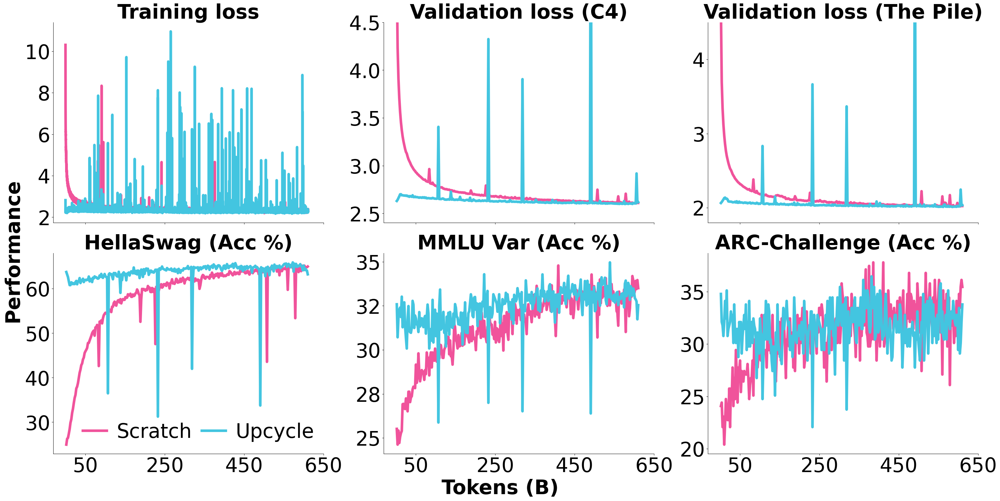

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_SCRATCH["train"], DATA_UPCYCLE["train"]),
  (DATA_SCRATCH["val_c4"], DATA_UPCYCLE["val_c4"]),
  (DATA_SCRATCH["val_pile"], DATA_UPCYCLE["val_pile"]),
  (DATA_SCRATCH["down_hellaswag"], DATA_UPCYCLE["down_hellaswag"]),
  (DATA_SCRATCH["down_mmlu_var"], DATA_UPCYCLE["down_mmlu_var"]),
  (DATA_SCRATCH["down_arcc"], DATA_UPCYCLE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Scratch",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Upcycle",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [50, 250, 450, 650]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
        ax.legend(fontsize=FONTSIZE, frameon=False, ncol=2, columnspacing=0.5, handletextpad=0.5, handlelength=1.2, loc=(0.08, 0.02))


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([a, b])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([a, 4.5])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([a, 4.5])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('upcycle.pdf', dpi=300, bbox_inches='tight')
plt.show()

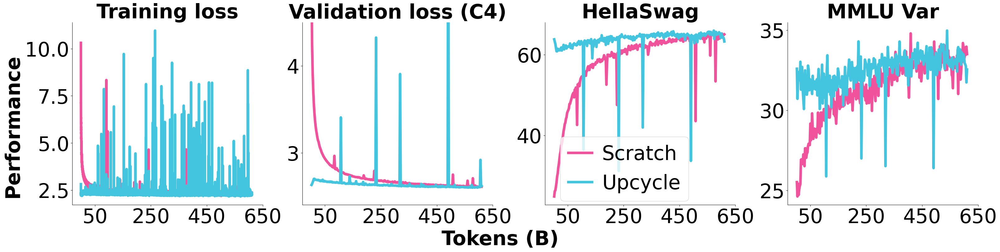

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_SCRATCH["train"], DATA_UPCYCLE["train"]),
  (DATA_SCRATCH["val_c4"], DATA_UPCYCLE["val_c4"]),
#  (DATA_SCRATCH["val_pile"], DATA_UPCYCLE["val_pile"]),
  (DATA_SCRATCH["down_hellaswag"], DATA_UPCYCLE["down_hellaswag"]),
  (DATA_SCRATCH["down_mmlu_var"], DATA_UPCYCLE["down_mmlu_var"]),
#  (DATA_SCRATCH["down_arcc"], DATA_UPCYCLE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Scratch",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Upcycle",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [50, 250, 450, 650]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
        ax.legend(fontsize=FONTSIZE, frameon=True, ncol=1, columnspacing=0.5, handletextpad=0.5, handlelength=1.2, loc=(0.08, 0.02))


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([a, b])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([a, 4.5])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([a, 4.5])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('upcycle.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### LBL FP32

In [ ]:
DATA_LBLFP = copy.deepcopy(DATA)
get_data(DATA_LBLFP, "_lblfp32", [("ijr033ki", 10000), ("zffa9pb8", 15000), ("hbw9j03r", 65394)], check_steps=True)
print(len(DATA_LBLFP["train"][1]))

Run ID: ijr033ki
Run ID: zffa9pb8
Run ID: hbw9j03r
23553


In [ ]:
DATA_LBLBF = copy.deepcopy(DATA)
get_data(DATA_LBLBF, "_lblbf16", [("l1jue9r2", 65394),], check_steps=True)
print(len(DATA_LBLBF["train"][1]))

Run ID: l1jue9r2
6163


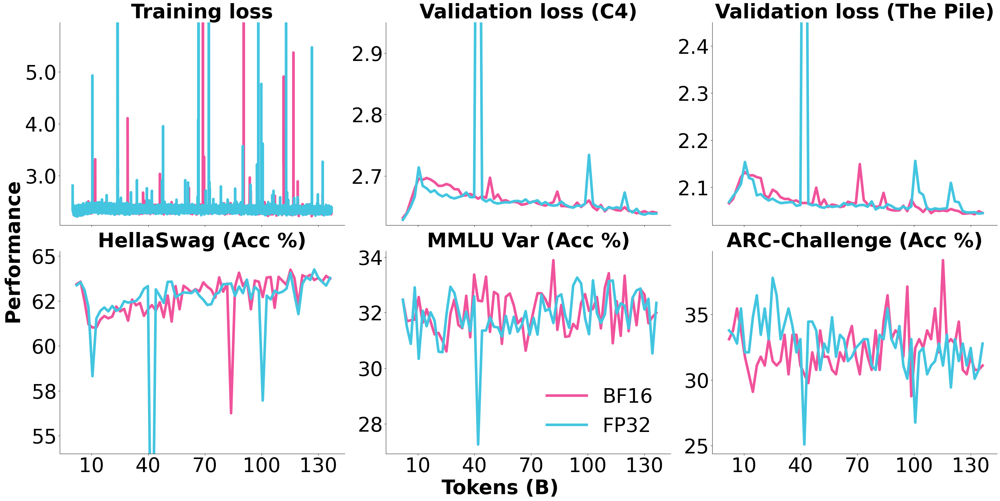

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_LBLBF["train"], DATA_LBLFP["train"]),
  (DATA_LBLBF["val_c4"], DATA_LBLFP["val_c4"]),
  (DATA_LBLBF["val_pile"], DATA_LBLFP["val_pile"]),
  (DATA_LBLBF["down_hellaswag"], DATA_LBLFP["down_hellaswag"]),
  (DATA_LBLBF["down_mmlu_var"], DATA_LBLFP["down_mmlu_var"]),
  (DATA_LBLBF["down_arcc"], DATA_LBLFP["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="BF16",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="FP32",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 4:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.05, 5.95])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.62, 2.95])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([2.02, 2.45])
    elif i == 3:
        a, b = ax.get_ylim()
        ax.set_ylim([54, b])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lblprecision.pdf', dpi=300, bbox_inches='tight')
plt.show()

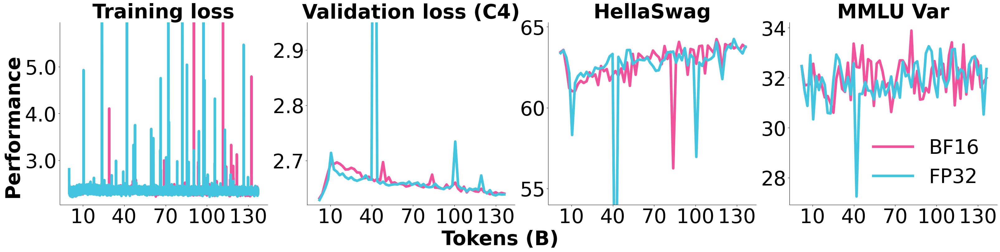

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_LBLBF["train"], DATA_LBLFP["train"]),
  (DATA_LBLBF["val_c4"], DATA_LBLFP["val_c4"]),
#  (DATA_LBLBF["val_pile"], DATA_LBLFP["val_pile"]),
  (DATA_LBLBF["down_hellaswag"], DATA_LBLFP["down_hellaswag"]),
  (DATA_LBLBF["down_mmlu_var"], DATA_LBLFP["down_mmlu_var"]),
#  (DATA_LBLBF["down_arcc"], DATA_LBLFP["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="BF16",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="FP32",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i < 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.05, 5.95])
        #ax.set_ylim([2.2, 2.65])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.62, 2.95])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([2.02, 2.45])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([54, b])

#plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lblprecision.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Upcycling Noise

In [ ]:
DATA_NOISE = copy.deepcopy(DATA)
runs = [
    ("ev3im2xc", 5000),
    ("uvgolkfo", 200000),
    ("ykts8yhp", 205000),
    ("9grm1t8z", 210000),
    ("qdc8k9iy", 250000),
    ("h1xeukpz", 255000),
    ("ailiyisi", 330155), # 350000
    ("v05aawp4", 500000),
]
get_data(DATA_NOISE, "_noise", runs, check_steps=True)
print(len(DATA_NOISE["train"][1]))

Run ID: ev3im2xc
Run ID: uvgolkfo
Run ID: ykts8yhp
Run ID: 9grm1t8z
Run ID: qdc8k9iy
Run ID: h1xeukpz
Run ID: ailiyisi
Run ID: v05aawp4
54844


In [ ]:
DATA_NONOISE = copy.deepcopy(DATA)
runs = [
    ("l1jue9r2", 105000),
    ("whpjhwq3", 180000),
    ("ptmlceov", 330155),
]
get_data(DATA_NONOISE, "_nonoise", runs, check_steps=True)
print(len(DATA_NONOISE["train"][1]))

Run ID: l1jue9r2
Run ID: whpjhwq3
Run ID: ptmlceov
29903


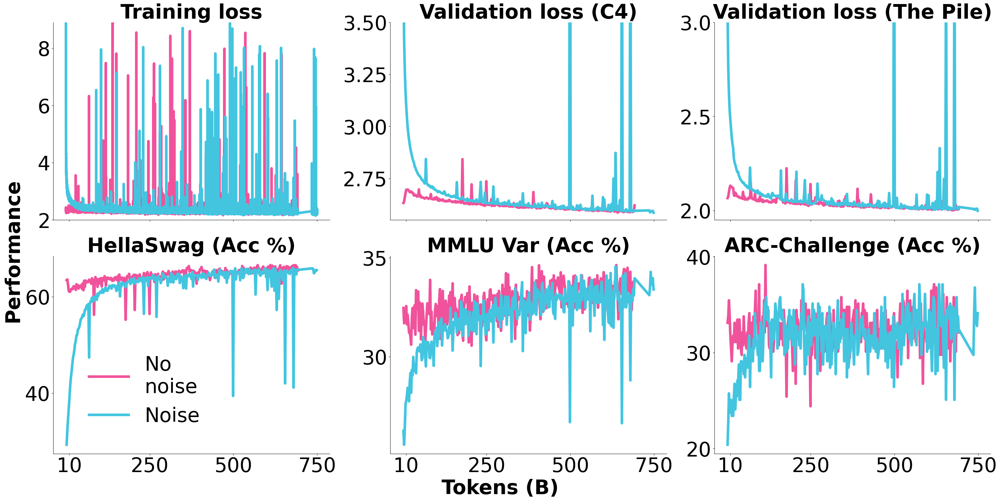

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NONOISE["train"], DATA_NOISE["train"]),
  (DATA_NONOISE["val_c4"], DATA_NOISE["val_c4"]),
  (DATA_NONOISE["val_pile"], DATA_NOISE["val_pile"]),
  (DATA_NONOISE["down_hellaswag"], DATA_NOISE["down_hellaswag"]),
  (DATA_NONOISE["down_mmlu_var"], DATA_NOISE["down_mmlu_var"]),
  (DATA_NONOISE["down_arcc"], DATA_NOISE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="No\nnoise",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Noise",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.1, 0.1))

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 8.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.55, 3.5])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([1.95, 3.0])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('noise.pdf', dpi=300, bbox_inches='tight')
plt.show()

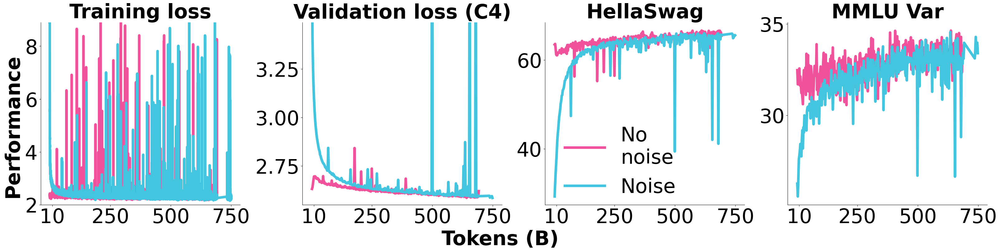

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NONOISE["train"], DATA_NOISE["train"]),
  (DATA_NONOISE["val_c4"], DATA_NOISE["val_c4"]),
#  (DATA_NONOISE["val_pile"], DATA_NOISE["val_pile"]),
  (DATA_NONOISE["down_hellaswag"], DATA_NOISE["down_hellaswag"]),
  (DATA_NONOISE["down_mmlu_var"], DATA_NOISE["down_mmlu_var"]),
#  (DATA_NONOISE["down_arcc"], DATA_NOISE["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="No\nnoise",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Noise",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, loc=(0.06, 0))

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 8.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.55, 3.49])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([1.95, 3.0])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('noise.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Layer sharing

In [ ]:
DATA_NOLAYERSHARING = copy.deepcopy(DATA)
get_data(DATA_NOLAYERSHARING, "_layersharing", [("1mi38klx", 109847),], check_steps=True)
print(len(DATA_NOLAYERSHARING["train"][1]))

Run ID: 1mi38klx
9818


In [ ]:
DATA_LAYERSHARING = copy.deepcopy(DATA)
get_data(DATA_LAYERSHARING, "_nolayersharing", [("m97414yw", 109847),], check_steps=True)
print(len(DATA_LAYERSHARING["train"][1]))

Run ID: m97414yw
7141


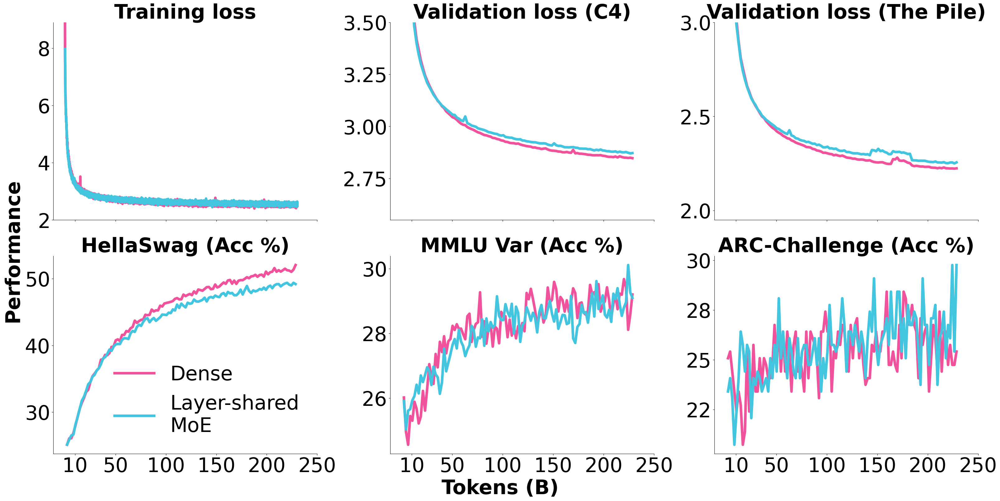

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "HellaSwag (Acc %)",
    "MMLU Var (Acc %)",
    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NOLAYERSHARING["train"], DATA_LAYERSHARING["train"]),
  (DATA_NOLAYERSHARING["val_c4"], DATA_LAYERSHARING["val_c4"]),
  (DATA_NOLAYERSHARING["val_pile"], DATA_LAYERSHARING["val_pile"]),
  (DATA_NOLAYERSHARING["down_hellaswag"], DATA_LAYERSHARING["down_hellaswag"]),
  (DATA_NOLAYERSHARING["down_mmlu_var"], DATA_LAYERSHARING["down_mmlu_var"]),
  (DATA_NOLAYERSHARING["down_arcc"], DATA_LAYERSHARING["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >=3 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Layer-shared\nMoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 3:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [10, 50, 100, 150, 200, 250]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 3:
      ax.legend(fontsize=FONTSIZE, frameon=False)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 8.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.55, 3.5])
    elif i == 2:
        a, b = ax.get_ylim()
        ax.set_ylim([1.95, 3.0])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('layersharing.pdf', dpi=300, bbox_inches='tight')
plt.show()

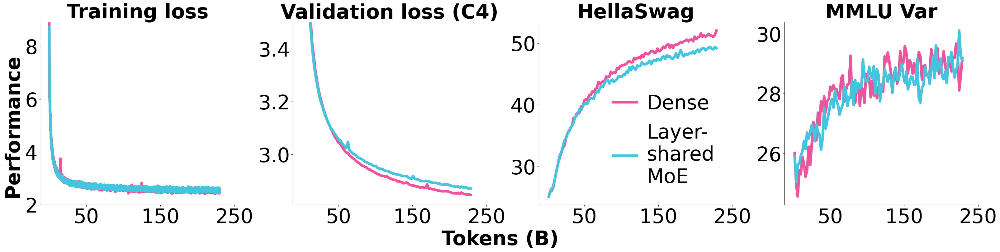

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Validation loss (C4)",
#    "Validation loss (The Pile)",
    "HellaSwag",# (Acc %)",
    "MMLU Var",# (Acc %)",
#    "ARC-Challenge (Acc %)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_NOLAYERSHARING["train"], DATA_LAYERSHARING["train"]),
  (DATA_NOLAYERSHARING["val_c4"], DATA_LAYERSHARING["val_c4"]),
#  (DATA_NOLAYERSHARING["val_pile"], DATA_LAYERSHARING["val_pile"]),
  (DATA_NOLAYERSHARING["down_hellaswag"], DATA_LAYERSHARING["down_hellaswag"]),
  (DATA_NOLAYERSHARING["down_mmlu_var"], DATA_LAYERSHARING["down_mmlu_var"]),
#  (DATA_NOLAYERSHARING["down_arcc"], DATA_LAYERSHARING["down_arcc"]),
]

for i, ax in enumerate(axes.flatten()):
    mult = 100 if i >= 2 else 1
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1]*mult for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1]*mult for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="Layer-\nshared\nMoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    if i >= 2:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.0f'))

    x_ticks = [50, 150, 250]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 2:
      ax.legend(fontsize=FONTSIZE, frameon=False, columnspacing=0.5, handletextpad=0.5, handlelength=1.2)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([2.0, 8.9])
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim([2.81, 3.5])
#    elif i == 2:
#        a, b = ax.get_ylim()
#        ax.set_ylim([1.95, 3.0])

# plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('layersharing.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Load balancing loss

In [ ]:
DATA_SPEC = {
    "train": [["train/CrossEntropyLoss"], []],
    "train_lbl": [["train/LoadBalancingLoss"], []],
    "val_c4": [["eval/v3-small-c4_en-validation/CrossEntropyLoss"], []],
    "val_pile": [["eval/v3-small-pile-validation/CrossEntropyLoss"], []],
    "val_books": [["eval/v3-small-dolma_books-validation/CrossEntropyLoss"], []],
    "val_reddit": [["eval/v3-small-dolma_reddit-validation/CrossEntropyLoss"], []],
#    "val_stack": [["eval/v3-small-dolma_stack-validation/CrossEntropyLoss"], []],
}

In [ ]:
DATA_LBL = copy.deepcopy(DATA_SPEC)
get_data(DATA_LBL, "_lbl", [("xzq6s5u1", 20000),])
print(len(DATA_LBL["train"][1]))

Run ID: xzq6s5u1
10000


In [ ]:
DATA_NLBL = copy.deepcopy(DATA_SPEC)
get_data(DATA_NLBL, "_nlbl", [("gdo27ww3", 20000),])
print(len(DATA_NLBL["train"][1]))

Run ID: gdo27ww3
10000


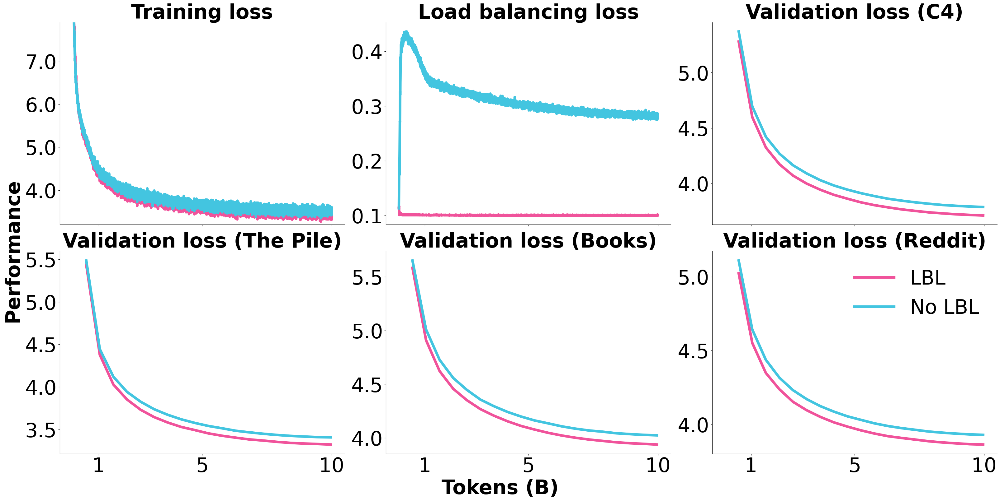

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 2048 * 256

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Load balancing loss",
    "Validation loss (C4)",
    "Validation loss (The Pile)",
    "Validation loss (Books)",
    "Validation loss (Reddit)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_LBL["train"], DATA_NLBL["train"]),
  (DATA_LBL["train_lbl"], DATA_NLBL["train_lbl"]),
  (DATA_LBL["val_c4"], DATA_NLBL["val_c4"]),
  (DATA_LBL["val_pile"], DATA_NLBL["val_pile"]),
  (DATA_LBL["val_books"], DATA_NLBL["val_books"]),
  (DATA_LBL["val_reddit"], DATA_NLBL["val_reddit"]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1] for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="LBL",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1] for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No LBL",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim([3.2, 7.9])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lbl.pdf', dpi=300, bbox_inches='tight')
plt.show()

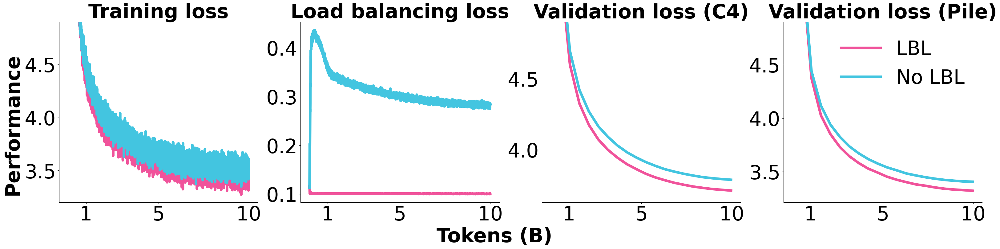

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 2048 * 256

fig, axes = plt.subplots(figsize=(32, 8), ncols=4, nrows=1, sharex=True, layout='constrained')

titles = [
    "Training loss",
    "Load balancing loss",
    "Validation loss (C4)",
    "Validation loss (Pile)",
#    "Validation loss (Books)",
#    "Validation loss (Reddit)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (DATA_LBL["train"], DATA_NLBL["train"]),
  (DATA_LBL["train_lbl"], DATA_NLBL["train_lbl"]),
  (DATA_LBL["val_c4"], DATA_NLBL["val_c4"]),
  (DATA_LBL["val_pile"], DATA_NLBL["val_pile"]),
#  (DATA_LBL["val_books"], DATA_NLBL["val_books"]),
#  (DATA_LBL["val_reddit"], DATA_NLBL["val_reddit"]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0][1]],
        [x[1] for x in data[i][0][1]],
        linewidth=6.0,
        color=colors[0],
        label="LBL",
    )
    ax.plot(
        [x[0] for x in data[i][1][1]],
        [x[1] for x in data[i][1][1]],
        linewidth=6.0,
        color=colors[1],
        label="No LBL",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
#        ax.set_ylim([3.2, 7.9])
        ax.set_ylim([3.2, 4.9])
    if i == 2:
        a, b = ax.get_ylim()
#        ax.set_ylim([3.2, 7.9])
        ax.set_ylim([a, 4.9])
    if i == 3:
        a, b = ax.get_ylim()
#        ax.set_ylim([3.2, 7.9])
        ax.set_ylim([a, 4.9])

plt.legend(fontsize=FONTSIZE, frameon=False)

fig.supylabel('Performance', fontsize=FONTSIZE, fontweight='bold')
fig.supxlabel('Tokens (B)', fontsize=FONTSIZE, fontweight='bold')

plt.savefig('lbl.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
DATA_SPEC = {
    "train_toks00": [["train/TokensPercentage/layer0/expert0"], []],
    "train_toks01": [["train/TokensPercentage/layer0/expert1"], []],
    "train_toks02": [["train/TokensPercentage/layer0/expert2"], []],
    "train_toks03": [["train/TokensPercentage/layer0/expert3"], []],
    "train_toks04": [["train/TokensPercentage/layer0/expert4"], []],
    "train_toks05": [["train/TokensPercentage/layer0/expert5"], []],
    "train_toks06": [["train/TokensPercentage/layer0/expert6"], []],
    "train_toks07": [["train/TokensPercentage/layer0/expert7"], []],
}

In [ ]:
DATA_LBL_TOKS = copy.deepcopy(DATA_SPEC)
get_data(DATA_LBL_TOKS, "_lbl_toks", [("xzq6s5u1", 20000),])
print(len(DATA_LBL_TOKS["train_toks00"][1]))

Run ID: xzq6s5u1
10000


In [ ]:
DATA_NLBL_TOKS = copy.deepcopy(DATA_SPEC)
get_data(DATA_NLBL_TOKS, "_nlbl_toks", [("gdo27ww3", 20000),])
print(len(DATA_NLBL_TOKS["train_toks00"][1]))

Run ID: gdo27ww3
10000


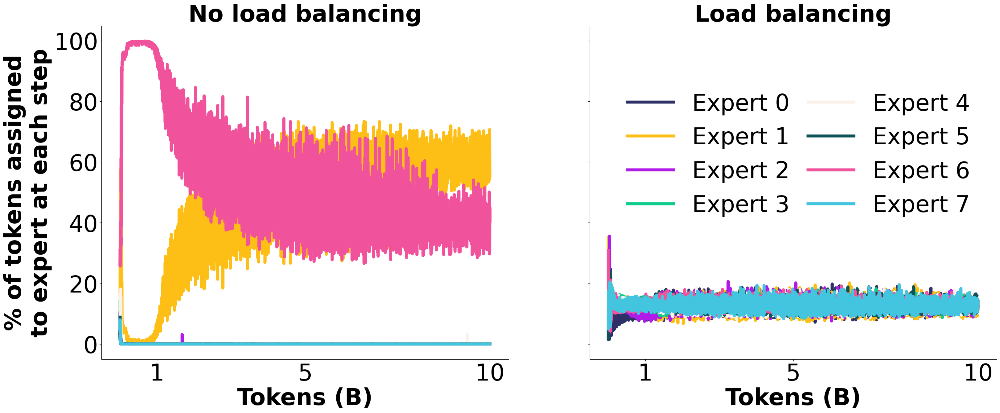

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 2048 * 256

fig, axes = plt.subplots(figsize=(32, 12), ncols=2, sharey=True)

titles = [
    "Expert assignment",
]

# Colors partly from https://allenai.org/downloads/Ai2%20Brand%20Toolkit.pdf
colors = [
    "#2E3168",
    "#FDBE15",
    "#B11BE8",
    "#0FCB8C",
    "#FAF2E9",
    "#105257",
    "#F0539B",
    "#43C5E0",
]


for i, ax in enumerate([axes[0]]):
    for j in range(0, 8):
      data = DATA_NLBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_ylabel("% of tokens assigned\nto expert at each step", fontsize=FONTSIZE, fontweight='bold')

    ax.set_title("No load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)


for i, ax in enumerate([axes[1]]):
    for j in range(0, 8):
      data = DATA_LBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_title("Load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 0:
#        a, b = ax.get_ylim()
#        ax.set_ylim([0, 3.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

# set loc in xy
plt.legend(fontsize=FONTSIZE, frameon=False, ncol=2, columnspacing=0.8, loc=(0.07, 0.4))

plt.savefig('lbltoks.pdf', dpi=300, bbox_inches='tight')
plt.show()

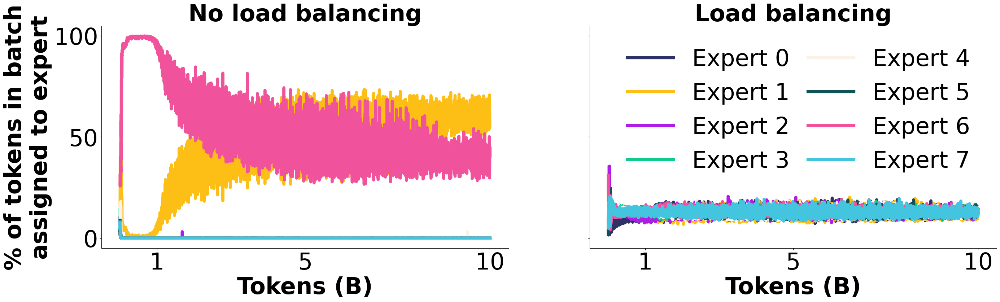

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 2048 * 256

fig, axes = plt.subplots(figsize=(32, 8), ncols=2, sharey=True)

titles = [
    "Expert assignment",
]

# Colors partly from https://allenai.org/downloads/Ai2%20Brand%20Toolkit.pdf
colors = [
    "#2E3168",
    "#FDBE15",
    "#B11BE8",
    "#0FCB8C",
    "#FAF2E9",
    "#105257",
    "#F0539B",
    "#43C5E0",
]


for i, ax in enumerate([axes[0]]):
    for j in range(0, 8):
      data = DATA_NLBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_ylabel("% of tokens in batch\nassigned to expert", fontsize=FONTSIZE, fontweight='bold')

    ax.set_title("No load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)


for i, ax in enumerate([axes[1]]):
    for j in range(0, 8):
      data = DATA_LBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_title("Load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 0:
#        a, b = ax.get_ylim()
#        ax.set_ylim([0, 3.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

# set loc in xy
plt.legend(fontsize=FONTSIZE, frameon=False, ncol=2, columnspacing=0.8, loc=(0.07, 0.3))

plt.savefig('lbltoks.pdf', dpi=300, bbox_inches='tight')
plt.show()

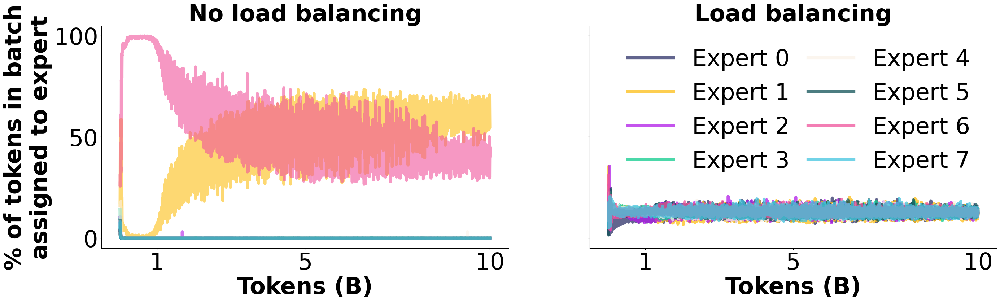

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 46
TOKENS_PER_STEP = 2048 * 256

fig, axes = plt.subplots(figsize=(32, 8), ncols=2, sharey=True)

titles = [
    "Expert assignment",
]

# Colors partly from https://allenai.org/downloads/Ai2%20Brand%20Toolkit.pdf
colors = [
    "#2E3168",
    "#FDBE15",
    "#B11BE8",
    "#0FCB8C",
    "#FAF2E9",
    "#105257",
    "#F0539B",
    "#43C5E0",
]


for i, ax in enumerate([axes[0]]):
    for j in range(0, 8):
      data = DATA_NLBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
          alpha=0.6,
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_ylabel("% of tokens in batch\nassigned to expert", fontsize=FONTSIZE, fontweight='bold')

    ax.set_title("No load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)


for i, ax in enumerate([axes[1]]):
    for j in range(0, 8):
      data = DATA_LBL_TOKS[f"train_toks0{j}"][1]
      ax.plot(
          [x[0] for x in data],
          [x[1] for x in data],
          linewidth=6.0,
          color=colors[j],
          label=f"Expert {j}",
          alpha=0.75,
      )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE, fontweight='bold')
    ax.set_title("Load balancing", fontsize=FONTSIZE, fontweight='bold')

    x_ticks = [1, 5, 10]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 0:
#        a, b = ax.get_ylim()
#        ax.set_ylim([0, 3.0])
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim([2.5, 3.9])

# set loc in xy
plt.legend(fontsize=FONTSIZE, frameon=False, ncol=2, columnspacing=0.8, loc=(0.07, 0.3))

plt.savefig('lbltoks.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Interleaving

In [ ]:
32831
32030
32153

### Old Plots

##### EC v TC

In [ ]:
# Load files if exist
import os
import pickle

if os.path.exists("losses_ec.pkl"):
  with open("losses_ec.pkl", "rb") as f:
      losses_ec = pickle.load(f)
  with open("val_ec.pkl", "rb") as f:
      val_ec = pickle.load(f)
  with open("down_ec.pkl", "rb") as f:
      down_ec = pickle.load(f)
  with open("losses_tc.pkl", "rb") as f:
      losses_tc = pickle.load(f)
  with open("val_tc.pkl", "rb") as f:
      val_tc = pickle.load(f)
  with open("down_tc.pkl", "rb") as f:
      down_tc = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  # Run: 32018
  run = api.run("ai2-llm/olmoe/cwrpsgdk")
  losses_ec = []
  val_ec = []
  down_ec = []
  for i, row in enumerate(run.scan_history()):
      if i == 0: continue
      if i > 5000: break
      if i % 100 == 0:
        losses_ec.append(row["train/CrossEntropyLoss"])
      if i % 1000 == 0:
        val_ec.append(row["eval/c4_en-validation/CrossEntropyLoss"])
        down_ec.append(row["eval/downstream/hellaswag_len_norm"])

  # Run: 32830 ; Started at 5000 steps from 32018
  # losses = [row["train/CrossEntropyLoss"] for row in history]
  run = api.run("ai2-llm/olmoe/9217flhv")
  for i, row in enumerate(run.scan_history()):
      if i == 0: continue
      if i % 100 == 0:
        losses_ec.append(row["train/CrossEntropyLoss"])
      if i % 1000 == 0:
        val_ec.append(row["eval/c4_en-validation/CrossEntropyLoss"])
        down_ec.append(row["eval/downstream/hellaswag_len_norm"])

  # Run: 32153
  run = api.run("ai2-llm/olmoe/5qig08r2")
  losses_tc = []
  val_tc = []
  down_tc = []
  for i, row in enumerate(run.scan_history()):
      if i == 0: continue
      if i % 100 == 0:
        losses_tc.append(row["train/CrossEntropyLoss"])
      if i % 1000 == 0:
        val_tc.append(row["eval/c4_en-validation/CrossEntropyLoss"])
        down_tc.append(row["eval/downstream/hellaswag_len_norm"])

  # Save
  import pickle

  with open("losses_ec.pkl", "wb") as f:
      pickle.dump(losses_ec, f)

  with open("val_ec.pkl", "wb") as f:
      pickle.dump(val_ec, f)

  with open("down_ec.pkl", "wb") as f:
      pickle.dump(down_ec, f)

  with open("losses_tc.pkl", "wb") as f:
      pickle.dump(losses_tc, f)

  with open("val_tc.pkl", "wb") as f:
      pickle.dump(val_tc, f)

  with open("down_tc.pkl", "wb") as f:
      pickle.dump(down_tc, f)

In [ ]:
max_len = min(len(losses_ec), len(losses_tc))

losses_tc = losses_tc[:max_len]
losses_ec = losses_ec[:max_len]

max_len = min(len(val_ec), len(val_tc))

val_tc = val_tc[:max_len]
val_ec = val_ec[:max_len]

max_len = min(len(down_ec), len(down_tc))

down_tc = down_tc[:max_len]
down_ec = down_ec[:max_len]

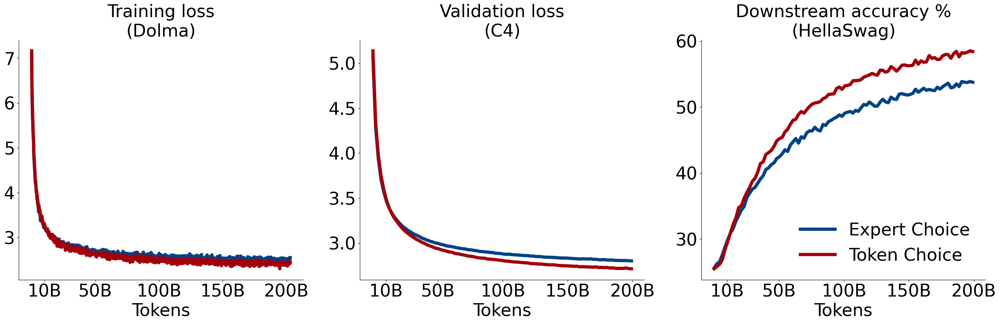

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
]

data = [
  (losses_ec, losses_tc, [x * 100 for x in range(len(losses_tc))]),
  (val_ec, val_tc, [x * 1000 for x in range(len(val_tc))]),
  ([x*100 for x in down_ec], [x*100 for x in down_tc], [x * 1000 for x in range(len(down_tc))]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        data[i][2],
        data[i][0],
        linewidth=6.0,
        color=colors[0],
        label="Expert Choice",
    )
    ax.plot(
        data[i][2],
        data[i][1],
        linewidth=6.0,
        color=colors[1],
        label="Token Choice",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)
#ax.set_xscale(
#    "log"
#)
    x_ticks = [10, 50, 100, 150, 200]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

#ax.set_xscale(
#    "log"
#)



#plt.ylim(
#    [2.26, 4]
#)

#plt.xlim(
#    [-10, 1260]
#)

plt.legend(
#    loc="upper right",
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('ectc.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### MoE vs Dense

###### Billion Tokens

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_moe_cx5.pkl"):
  with open("losses_moe_cx5.pkl", "rb") as f:
      losses_moe = pickle.load(f)

  with open("val_moe_cx5.pkl", "rb") as f:
      val_moe = pickle.load(f)

  with open("down_moe_cx5.pkl", "rb") as f:
      down_moe = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("3f30yxub", 5000),
      ("f2f4y0md", 35000),
  ]

  losses_moe = []
  val_moe = []
  down_moe = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_moe += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_moe += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_moe.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_moe.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_moe.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_moe_cx5.pkl", "wb") as f:
      pickle.dump(losses_moe, f)

  with open("val_moe_cx5.pkl", "wb") as f:
      pickle.dump(val_moe, f)

  with open("down_moe_cx5.pkl", "wb") as f:
      pickle.dump(down_moe, f)

print(len(losses_moe), len(val_moe), len(down_moe))



Run ID: 3f30yxub
Run ID: f2f4y0md
15000 30 30


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_d_cx5.pkl"):
  with open("losses_d_cx5.pkl", "rb") as f:
      losses_d = pickle.load(f)

  with open("val_d_cx5.pkl", "rb") as f:
      val_d = pickle.load(f)

  with open("down_d_cx5.pkl", "rb") as f:
      down_d = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("viysqf9q", 10000),
      ("de8xt7jl", 35000),
  ]

  losses_d = []
  val_d = []
  down_d = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_d += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_d += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_d += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_d.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_d.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_d.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_d_cx5.pkl", "wb") as f:
      pickle.dump(losses_d, f)

  with open("val_d_cx5.pkl", "wb") as f:
      pickle.dump(val_d, f)

  with open("down_d_cx5.pkl", "wb") as f:
      pickle.dump(down_d, f)

print(len(losses_d), len(val_d), len(down_d))



Run ID: viysqf9q
Run ID: de8xt7jl
20000 30 30


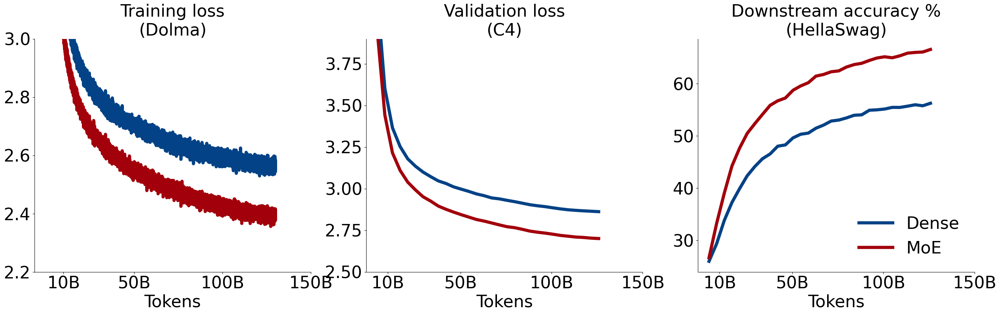

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_d, losses_moe),
  (val_d, val_moe),
  ([(x, y*100) for (x, y) in down_d], [(x, y*100) for (x, y) in down_moe]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [10, 50, 100, 150]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('moe.pdf', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
TOKENS_PER_STEP = 4096 * 1024
TOKS_PER_D_PER_S_MOE = 23600
TOKS_PER_D_PER_S_D = 37500

NUM_GPUS = 16 * 8

losses_moe = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in losses_moe]
losses_d = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in losses_d]

val_moe = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in val_moe]
val_d = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in val_d]

down_moe = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in down_moe]
down_d = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in down_d]


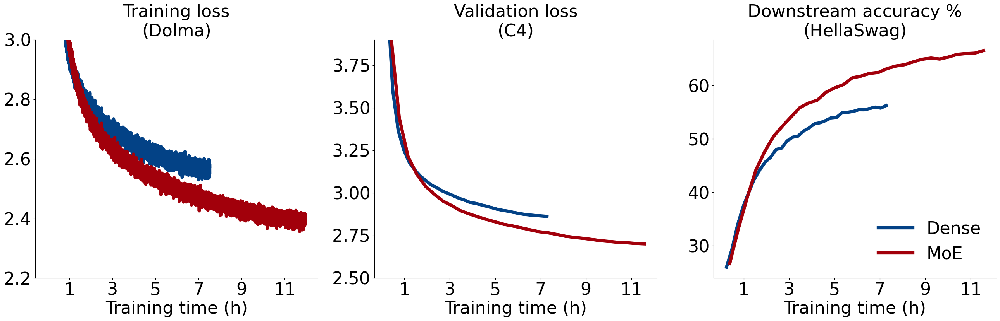

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32


fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_d, losses_moe),
  (val_d, val_moe),
  ([(x, y*100) for (x, y) in down_d], [(x, y*100) for (x, y) in down_moe]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Training time (h)", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [1, 3, 5, 7, 9, 11]
    # Transform billion tokens to steps
    x_ticks_loc = [x for x in x_ticks]
    #x_ticks = [str(x) + "h" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('moe.pdf', dpi=300, bbox_inches='tight')
plt.show()

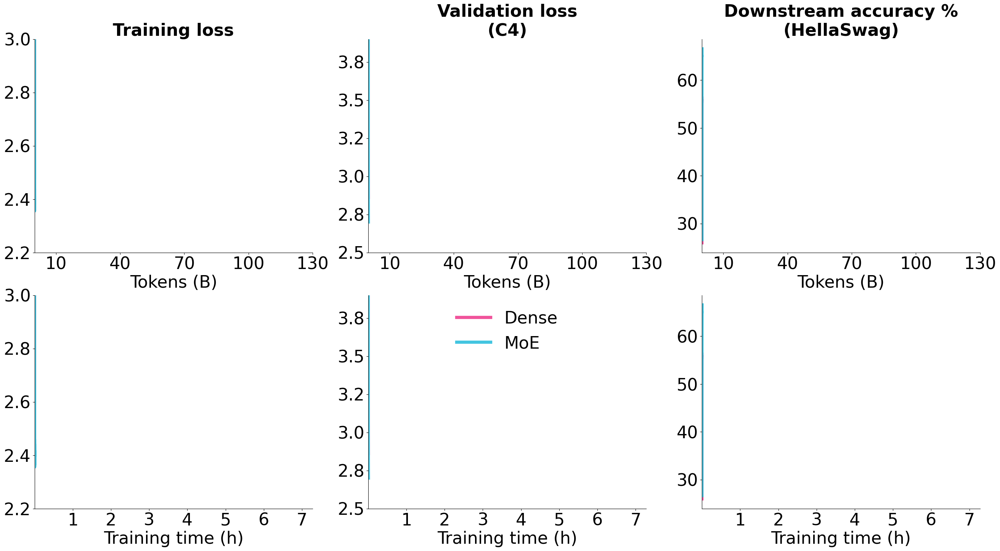

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 1024

fig, axes = plt.subplots(figsize=(32, 16), ncols=3, nrows=2)

titles = [
    "Training loss",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#F0539B",
    "#43C5E0",
    "#2E3168",
    "#FDBE15",
]

data = [
  (losses_d, losses_moe),
  (val_d, val_moe),
  ([(x, y*100) for (x, y) in down_d], [(x, y*100) for (x, y) in down_moe]),
]

for i, ax in enumerate(axes[0].flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens (B)", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE, fontweight='bold')
    # Round yticks
    if i == 1:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

#    if i == 1:
#      # Legend
#      ax.legend(
#          fontsize=FONTSIZE,
#          frameon=False,
#          loc='upper center',
#      )


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

TOKENS_PER_STEP = 4096 * 1024
TOKS_PER_D_PER_S_MOE = 23600
TOKS_PER_D_PER_S_D = 37500

NUM_GPUS = 16 * 8

losses_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in losses_moe]
losses_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in losses_d]

val_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in val_moe]
val_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in val_d]

down_moe_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_MOE * NUM_GPUS) ) / 60 / 60, y) for (x,y) in down_moe]
down_d_adj = [((x * TOKENS_PER_STEP / (TOKS_PER_D_PER_S_D * NUM_GPUS) ) / 60 / 60, y) for (x,y) in down_d]

data = [
  (losses_d_adj, losses_moe_adj),
  (val_d_adj, val_moe_adj),
  ([(x, y*100) for (x, y) in down_d_adj], [(x, y*100) for (x, y) in down_moe_adj]),
]

for i, ax in enumerate(axes[1].flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Training time (h)", fontsize=FONTSIZE)
    # Round yticks
    if i == 1:
      ax.yaxis.set_major_formatter(plt.FormatStrFormatter('%.1f'))

    #ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [1, 3, 5, 7, 9, 11]
    x_ticks_loc = [x for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)

    # If only showing up to where dense finishes; if want to show full, then comment this out
    x_ticks = [1, 2, 3, 4, 5, 6, 7]
    x_ticks_loc = [x for x in x_ticks]
    ax.set_xticks(x_ticks_loc, x_ticks)
    ax.set_xlim(
        [0, 7.28]
    )

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

    if i == 1:
      # Legend
      ax.legend(
          fontsize=FONTSIZE,
          frameon=False,
          loc='upper center',
      )

#plt.legend(
#    fontsize=FONTSIZE,
#    frameon=False
#)

plt.savefig('moe.pdf', dpi=300, bbox_inches='tight')
plt.show()

###### Trillion Tokens

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_moe.pkl"):
  with open("losses_moe.pkl", "rb") as f:
      losses_moe = pickle.load(f)

  with open("val_moe.pkl", "rb") as f:
      val_moe = pickle.load(f)

  with open("down_moe.pkl", "rb") as f:
      down_moe = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("1g5c71j1", 30000),
      ("dd87de7e", 35000),
      ("xyfqy137", 45000),
      ("fac91t6s", 4500000),
  ]

  losses_moe = []
  val_moe = []
  down_moe = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_moe += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_moe += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_moe.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_moe.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_moe.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_moe.pkl", "wb") as f:
      pickle.dump(losses_moe, f)

  with open("val_moe.pkl", "wb") as f:
      pickle.dump(val_moe, f)

  with open("down_moe.pkl", "wb") as f:
      pickle.dump(down_moe, f)

print(len(losses_moe), len(val_moe), len(down_moe))

Run ID: 1g5c71j1
Run ID: dd87de7e
Run ID: xyfqy137
Run ID: fac91t6s
11100 508 508


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_d.pkl"):
  with open("losses_d.pkl", "rb") as f:
      losses_d = pickle.load(f)

  with open("val_d.pkl", "rb") as f:
      val_d = pickle.load(f)

  with open("down_d.pkl", "rb") as f:
      down_d = pickle.load(f)

else:

  runs_d = [
      ("x79pab0t", 4500),
      ("qqlzbgws", 62000),
      ("3wrabx7h", 222100),
      ("859t5a95", 223550),
      ("w74o3btt", 224000),
      ("gfl2ydjz", 225000),
      ("o2pie67u", 228000),
      ("qp2duvgc", 229000),
      ("hrimwbz2", 254000),
      ("dayoj89m", 284000),
      ("pnfz9ep1", 419000),
      ("6okigvch", 817847),
      ("bdztvpcn", 878000),
      ("qna8fbn4", 1032000),
      ("uvl205or", 1042000),
      ("s4biui47", 1113000),
      ("7b0t2e06", 1272000),
      ("wqw4r5nf", 1273000),
      ("9bdgerkt", 1367000),
      ("bz63gpic", 1368000),
      ("98qwqyl5", 13680000),
  ]



  losses_d = []
  val_d = []
  down_d = []

  if sample_every_n > 0:
    for run_id, end_step in runs_d:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmo-small/{run_id}")

        samples = end_step // sample_every_n

        losses_d += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_d += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_d += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in runs_d:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmo-small/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_d.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_d.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_d.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_d.pkl", "wb") as f:
      pickle.dump(losses_d, f)

  with open("val_d.pkl", "wb") as f:
      pickle.dump(val_d, f)

  with open("down_d.pkl", "wb") as f:
      pickle.dump(down_d, f)

print(len(losses_d), len(val_d), len(down_d))

Run ID: x79pab0t
Run ID: qqlzbgws
Run ID: 3wrabx7h
Run ID: 859t5a95
Run ID: w74o3btt
Run ID: gfl2ydjz
Run ID: o2pie67u
Run ID: qp2duvgc
Run ID: hrimwbz2
Run ID: dayoj89m
Run ID: pnfz9ep1
Run ID: 6okigvch
Run ID: bdztvpcn
Run ID: qna8fbn4
Run ID: uvl205or
Run ID: s4biui47
Run ID: 7b0t2e06
Run ID: wqw4r5nf
Run ID: 9bdgerkt
Run ID: bz63gpic
Run ID: 98qwqyl5
97773 1427 1427


In [ ]:
# https://stackoverflow.com/questions/42281844/what-is-the-mathematics-behind-the-smoothing-parameter-in-tensorboards-scalar
def smooth(scalars, weight: float):  # Weight between 0 and 1
    last = scalars[0]  # First value in the plot (first timestep)
    smoothed = list()
    for point in scalars:
        smoothed_val = last * weight + (1 - weight) * point  # Calculate smoothed value
        smoothed.append(smoothed_val)                        # Save it
        last = smoothed_val                                  # Anchor the last smoothed value

    return smoothed

losses_moe = [(x[0],y) for x,y in zip(losses_moe, smooth([x[1] for x in losses_moe], weight=0.9))]
losses_d = [(x[0],y) for x,y in zip(losses_d, smooth([x[1] for x in losses_d], weight=0.9))]

val_moe = [(x[0],y) for x,y in zip(val_moe, smooth([x[1] for x in val_moe], weight=0.9))]
val_d = [(x[0],y) for x,y in zip(val_d, smooth([x[1] for x in val_d], weight=0.9))]

down_moe = [(x[0],y) for x,y in zip(down_moe, smooth([x[1] for x in down_moe], weight=0.9))]
down_d = [(x[0],y) for x,y in zip(down_d, smooth([x[1] for x in down_d], weight=0.9))]

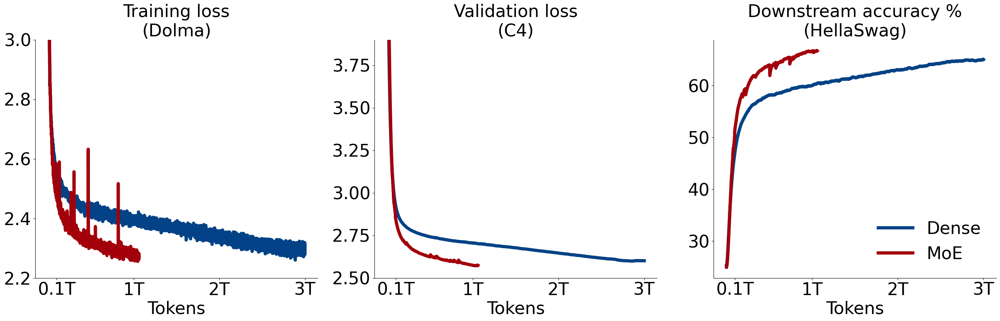

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_d, losses_moe),
  (val_d, val_moe),
  ([(x, y*100) for (x, y) in down_d], [(x, y*100) for (x, y) in down_moe]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [0.1, 1, 2, 3]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e12 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "T" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('moe.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Sharing

In [ ]:
# Load files if exist
import os
import pickle

if os.path.exists("losses_ns.pkl"):
  with open("losses_ns.pkl", "rb") as f:
      losses_ns = pickle.load(f)
  with open("val_ns.pkl", "rb") as f:
      val_ns = pickle.load(f)
  with open("down_ns.pkl", "rb") as f:
      down_ns = pickle.load(f)
  with open("losses_s.pkl", "rb") as f:
      losses_s = pickle.load(f)
  with open("val_s.pkl", "rb") as f:
      val_s = pickle.load(f)
  with open("down_s.pkl", "rb") as f:
      down_s = pickle.load(f)

else:

  import wandb
  api = wandb.Api()

  # Run: 32030 - 2 routed
  run = api.run("ai2-llm/olmoe/egktddq6")
  losses_ns = []
  val_ns = []
  down_ns = []
  for i, row in enumerate(run.scan_history()):
      if i == 0: continue
      if i % 100 == 0:
        losses_ns.append(row["train/CrossEntropyLoss"])
      if i % 1000 == 0:
        val_ns.append(row["eval/c4_en-validation/CrossEntropyLoss"])
        down_ns.append(row["eval/downstream/hellaswag_len_norm"])

  # Run: 32035 - 1 shared & 1 routed
  run = api.run("ai2-llm/olmoe/t35wm5qk")
  losses_s = []
  val_s = []
  down_s = []
  for i, row in enumerate(run.scan_history()):
      if i == 0: continue
      if i % 100 == 0:
        losses_s.append(row["train/CrossEntropyLoss"])
      if i % 1000 == 0:
        val_s.append(row["eval/c4_en-validation/CrossEntropyLoss"])
        down_s.append(row["eval/downstream/hellaswag_len_norm"])


  # Save
  import pickle

  with open("losses_ns.pkl", "wb") as f:
      pickle.dump(losses_ns, f)

  with open("val_ns.pkl", "wb") as f:
      pickle.dump(val_ns, f)

  with open("down_ns.pkl", "wb") as f:
      pickle.dump(down_ns, f)

  with open("losses_s.pkl", "wb") as f:
      pickle.dump(losses_s, f)

  with open("val_s.pkl", "wb") as f:
      pickle.dump(val_s, f)

  with open("down_s.pkl", "wb") as f:
      pickle.dump(down_s, f)


In [ ]:
max_len = min(len(losses_s), len(losses_ns))

losses_ns = losses_ns[:max_len]
losses_s = losses_s[:max_len]

max_len = min(len(val_s), len(val_ns))

val_ns = val_ns[:max_len]
val_s = val_s[:max_len]

max_len = min(len(down_s), len(down_ns))

down_ns = down_ns[:max_len]
down_s = down_s[:max_len]

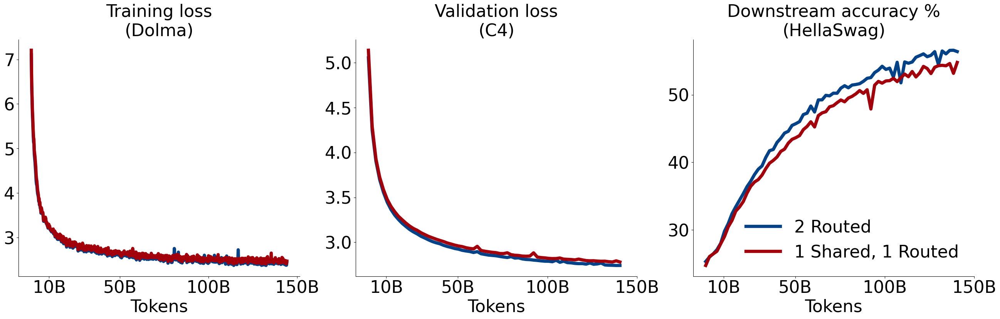

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_ns, losses_s, [x * 100 for x in range(len(losses_ns))]),
  (val_ns, val_s, [x * 1000 for x in range(len(val_ns))]),
  ([x*100 for x in down_ns], [x*100 for x in down_s], [x * 1000 for x in range(len(down_ns))]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        data[i][2],
        data[i][0],
        linewidth=6.0,
        color=colors[0],
        label="2 Routed",
    )
    ax.plot(
        data[i][2],
        data[i][1],
        linewidth=6.0,
        color=colors[1],
        label="1 Shared, 1 Routed",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)
#ax.set_xscale(
#    "log"
#)
    x_ticks = [10, 50, 100, 150]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('shared.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Layer sharing

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all
end_step = 5000000

if os.path.exists("losses_nls.pkl"):
  with open("losses_nls.pkl", "rb") as f:
      losses_nls = pickle.load(f)
  with open("val_nls.pkl", "rb") as f:
      val_nls = pickle.load(f)
  with open("down_nls.pkl", "rb") as f:
      down_nls = pickle.load(f)
  with open("losses_ls.pkl", "rb") as f:
      losses_ls = pickle.load(f)
  with open("val_ls.pkl", "rb") as f:
      val_ls = pickle.load(f)
  with open("down_ls.pkl", "rb") as f:
      down_ls = pickle.load(f)

else:

  import wandb
  api = wandb.Api()

  # Run: 23520 - Dense
  run = api.run("ai2-llm/olmoe/1mi38klx")
  losses_nls = []
  val_nls = []
  down_nls = []
  if sample_every_n > 0:
    samples = end_step // sample_every_n

    losses_nls += [
        (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
    ]
    val_nls += [
        (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
    ]
    down_nls += [
        (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
    ]
  else:
    for i, row in enumerate(run.scan_history()):
        if i == 0: continue
        if i % 100 == 0:
          losses_nls.append(row["train/CrossEntropyLoss"])
        if i % 1000 == 0:
          val_nls.append(row["eval/c4_en-validation/CrossEntropyLoss"])
          down_nls.append(row["eval/downstream/hellaswag_len_norm"])

  # Run: 23515 - Layer shared
  run = api.run("ai2-llm/olmoe/m97414yw")
  losses_ls = []
  val_ls = []
  down_ls = []
  if sample_every_n > 0:

    samples = end_step // sample_every_n

    losses_ls += [
        (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
    ]
    val_ls += [
        (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
    ]
    down_ls += [
        (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
    ]

  else:
    for i, row in enumerate(run.scan_history()):
        if i == 0: continue
        if i % 100 == 0:
          losses_ls.append(row["train/CrossEntropyLoss"])
        if i % 1000 == 0:
          val_ls.append(row["eval/c4_en-validation/CrossEntropyLoss"])
          down_ls.append(row["eval/downstream/hellaswag_len_norm"])


  # Save
  import pickle

  with open("losses_nls.pkl", "wb") as f:
      pickle.dump(losses_nls, f)

  with open("val_nls.pkl", "wb") as f:
      pickle.dump(val_nls, f)

  with open("down_nls.pkl", "wb") as f:
      pickle.dump(down_nls, f)

  with open("losses_ls.pkl", "wb") as f:
      pickle.dump(losses_ls, f)

  with open("val_ls.pkl", "wb") as f:
      pickle.dump(val_ls, f)

  with open("down_ls.pkl", "wb") as f:
      pickle.dump(down_ls, f)


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
last_step = min(losses_ls[-1][0], losses_nls[-1][0])

losses_nls = [(x[0],x[1]) for x in losses_nls if x[0] <= last_step]
losses_ls = [(x[0],x[1]) for x in losses_ls if x[0] <= last_step]


max_len = min(len(val_ls), len(val_nls))

val_nls = val_nls[:max_len]
val_ls = val_ls[:max_len]

max_len = min(len(down_ls), len(down_nls))

down_nls = down_nls[:max_len]
down_ls = down_ls[:max_len]


print(losses_nls[-1], losses_ls[-1], len(losses_nls), len(losses_ls))
print(val_nls[-1], val_ls[-1], len(val_nls), len(val_ls))
print(down_nls[-1], down_ls[-1], len(down_nls), len(down_ls))

(111989, 2.5693044662475586) (111989, 2.593932867050171) 10000 7308
(111000, 2.845559597015381) (111000, 2.8720719814300537) 111 111
(111000, 0.5126468539237976) (111000, 0.49372634291648865) 111 111


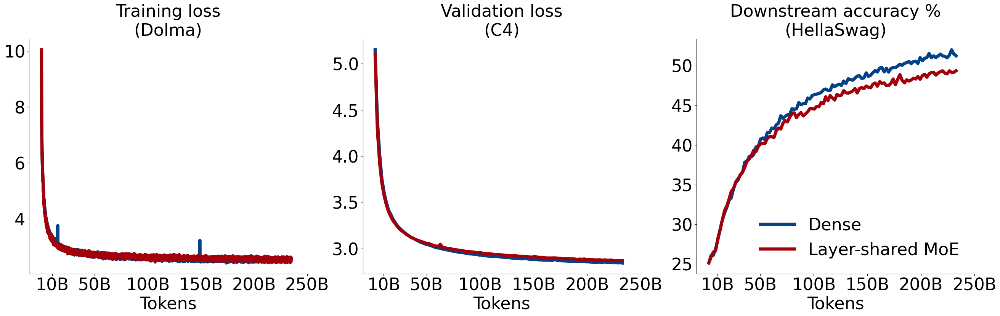

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

#data = [
#  (losses_nls, losses_ls, [x * 100 for x in range(len(losses_nls))]),
#  (val_nls, val_ls, [x * 1000 for x in range(len(val_nls))]),
#  ([x*100 for x in down_nls], [x*100 for x in down_ls], [x * 1000 for x in range(len(down_nls))]),
#]

data = [
  (losses_nls, losses_ls),
  (val_nls, val_ls),
  ([(x, y*100) for (x, y) in down_nls], [(x, y*100) for (x, y) in down_ls]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        # data[i][2],
        # data[i][0],
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Dense",
    )
    ax.plot(
        # data[i][2],
        # data[i][1],
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Layer-shared MoE",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)
    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)
    ax.set_title(titles[i], fontsize=FONTSIZE)
#ax.set_xscale(
#    "log"
#)
    x_ticks = [10, 50, 100, 150, 200, 250]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('layershared.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Noise

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_n.pkl"):
  with open("losses_n.pkl", "rb") as f:
      losses_n = pickle.load(f)

  with open("val_n.pkl", "rb") as f:
      val_n = pickle.load(f)

  with open("down_n.pkl", "rb") as f:
      down_n = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("ev3im2xc", 5000),
      ("uvgolkfo", 200000),
      ("ykts8yhp", 205000),
      ("9grm1t8z", 210000),
      ("qdc8k9iy", 250000),
      ("h1xeukpz", 255000),
      ("ailiyisi", 350000),
      ("v05aawp4", 500000),
  ]

  losses_n = []
  val_n = []
  down_n = []


  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_n += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_n += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_n += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_n.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_n.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_n.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_n.pkl", "wb") as f:
      pickle.dump(losses_n, f)

  with open("val_n.pkl", "wb") as f:
      pickle.dump(val_n, f)

  with open("down_n.pkl", "wb") as f:
      pickle.dump(down_n, f)

print(len(losses_n), len(val_n), len(down_n))

19750 364 364


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_up.pkl"):
  with open("losses_up.pkl", "rb") as f:
      losses_up = pickle.load(f)

  with open("val_up.pkl", "rb") as f:
      val_up = pickle.load(f)

  with open("down_up.pkl", "rb") as f:
      down_up = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("l1jue9r2", 105000),
      ("whpjhwq3", 180000),
      ("ptmlceov", 500000),
  ]

  losses_up = []
  val_up = []
  down_up = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_up += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_up += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_up += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_up.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_up.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_up.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_up.pkl", "wb") as f:
      pickle.dump(losses_up, f)

  with open("val_up.pkl", "wb") as f:
      pickle.dump(val_up, f)

  with open("down_up.pkl", "wb") as f:
      pickle.dump(down_up, f)

print(len(losses_up), len(val_up), len(down_up))

7850 330 330


In [ ]:
# https://stackoverflow.com/questions/42281844/what-is-the-mathematics-behind-the-smoothing-parameter-in-tensorboards-scalar
def smooth(scalars, weight: float):  # Weight between 0 and 1
    last = scalars[0]  # First value in the plot (first timestep)
    smoothed = list()
    for point in scalars:
        smoothed_val = last * weight + (1 - weight) * point  # Calculate smoothed value
        smoothed.append(smoothed_val)                        # Save it
        last = smoothed_val                                  # Anchor the last smoothed value

    return smoothed

weight = 0.5

losses_up = [(x[0],y) for x,y in zip(losses_up, smooth([x[1] for x in losses_up], weight=weight))]
losses_n = [(x[0],y) for x,y in zip(losses_n, smooth([x[1] for x in losses_n], weight=weight))]

val_up = [(x[0],y) for x,y in zip(val_up, smooth([x[1] for x in val_up], weight=weight))]
val_n = [(x[0],y) for x,y in zip(val_n, smooth([x[1] for x in val_n], weight=weight))]

down_up = [(x[0],y) for x,y in zip(down_up, smooth([x[1] for x in down_up], weight=weight))]
down_n = [(x[0],y) for x,y in zip(down_n, smooth([x[1] for x in down_n], weight=weight))]

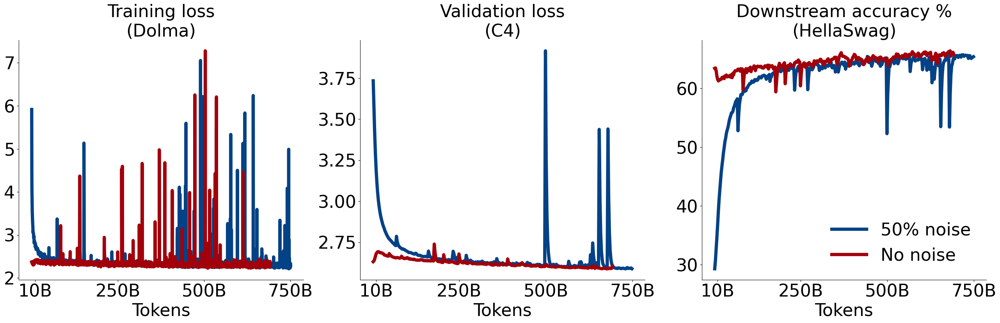

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_n, losses_up),
  (val_n, val_up),
  ([(x, y*100) for x, y in down_n], [(x, y*100) for x, y in down_up]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="50% noise",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="No noise",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('noise.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Upcycle vs Scratch

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_upz.pkl"):
  with open("losses_upz.pkl", "rb") as f:
      losses_upz = pickle.load(f)

  with open("val_upz.pkl", "rb") as f:
      val_upz = pickle.load(f)

  with open("down_upz.pkl", "rb") as f:
      down_upz = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("1w3srbb3", 5000),
      ("upvag6sw", 40000),
      ("n82uid74", 120000),
      ("leq6x4wa", 160000),
      ("wb2g00d2", 205000),
      ("r7tzdufe", 292000),
  ]

  losses_upz = []
  val_upz = []
  down_upz = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_upz += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_upz += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_upz += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_upz.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_upz.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_upz.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_upz.pkl", "wb") as f:
      pickle.dump(losses_upz, f)

  with open("val_upz.pkl", "wb") as f:
      pickle.dump(val_upz, f)

  with open("down_upz.pkl", "wb") as f:
      pickle.dump(down_upz, f)

print(len(losses_upz), len(val_upz), len(down_upz))

8220 289 289


In [ ]:
last_step = min(losses_upz[-1][0], losses_moe[-1][0])

losses_upz = [(x[0],x[1]) for x in losses_upz if x[0] <= last_step]
losses_moe = [(x[0],x[1]) for x in losses_moe if x[0] <= last_step]

max_len = min(len(val_upz), len(val_moe))

val_upz = val_upz[:max_len]
val_moe = val_moe[:max_len]

max_len = min(len(down_upz), len(down_moe))

down_upz = down_upz[:max_len]
down_moe = down_moe[:max_len]

print(losses_upz[-1], losses_moe[-1], len(losses_upz), len(losses_moe))
print(val_upz[-1], val_moe[-1], len(val_upz), len(val_moe))
print(down_upz[-1], down_moe[-1], len(down_upz), len(down_moe))

(291550, 2.3304197788238525) (291531, 2.306606584092531) 8220 6389
(291000, 2.6183297634124756) (287000, 2.6163217666991767) 289 289
(291000, 0.632344126701355) (287000, 0.6428260516749129) 289 289


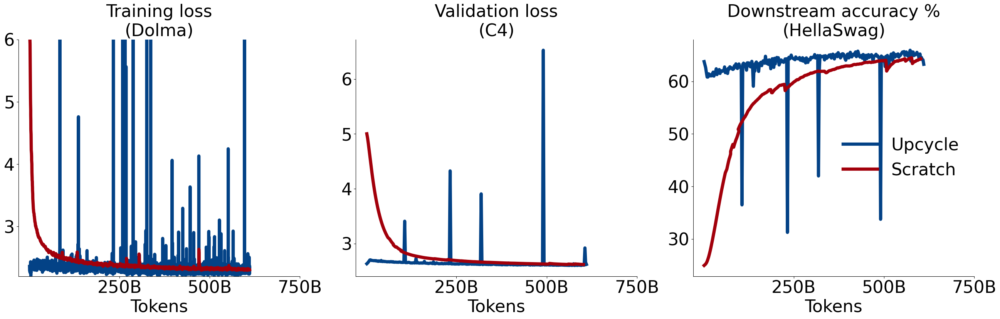

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

#data = [
#  (losses_nls, losses_ls, [x * 100 for x in range(len(losses_nls))]),
#  (val_nls, val_ls, [x * 1000 for x in range(len(val_nls))]),
#  ([x*100 for x in down_nls], [x*100 for x in down_ls], [x * 1000 for x in range(len(down_nls))]),
#]

data = [
  (losses_upz, losses_moe),
  (val_upz, val_moe),
  ([(x, y*100) for (x, y) in down_upz], [(x, y*100) for (x, y) in down_moe]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        # data[i][2],
        # data[i][0],
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Upcycle",
    )
    ax.plot(
        # data[i][2],
        # data[i][1],
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Scratch",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 6.0]
        )
    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.63, 3.0]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False,
)

# Put legend on middle plot which has more space

# Deduplicate legend
#handles, labels = ax.get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#axes.flatten()[1].legend(by_label.values(), by_label.keys(), fontsize=FONTSIZE, frameon=False)

#fig.legend(
    #loc="upper center",
#    fontsize=FONTSIZE,
#    frameon=False
#)

plt.savefig('upcycle.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Z Loss

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_moe.pkl"):
  with open("losses_moe.pkl", "rb") as f:
      losses_moe = pickle.load(f)

  with open("val_moe.pkl", "rb") as f:
      val_moe = pickle.load(f)

  with open("down_moe.pkl", "rb") as f:
      down_moe = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("1g5c71j1", 30000),
      ("dd87de7e", 35000),
      ("xyfqy137", 45000),
      ("fac91t6s", 4500000),
  ]

  losses_moe = []
  val_moe = []
  down_moe = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_moe += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_moe += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_moe += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_moe.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_moe.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_moe.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_moe.pkl", "wb") as f:
      pickle.dump(losses_moe, f)

  with open("val_moe.pkl", "wb") as f:
      pickle.dump(val_moe, f)

  with open("down_moe.pkl", "wb") as f:
      pickle.dump(down_moe, f)

print(len(losses_moe), len(val_moe), len(down_moe))





Run ID: 1g5c71j1
Run ID: dd87de7e
Run ID: xyfqy137
Run ID: fac91t6s
11100 508 508


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 100 # Set to -1 for all

if os.path.exists("losses_noz.pkl"):
  with open("losses_noz.pkl", "rb") as f:
      losses_noz = pickle.load(f)

  with open("val_noz.pkl", "rb") as f:
      val_noz = pickle.load(f)

  with open("down_noz.pkl", "rb") as f:
      down_noz = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("aq2us82x", 4500000),
  ]

  losses_noz = []
  val_noz = []
  down_noz = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_noz += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_noz += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_noz += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_noz.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_noz.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_noz.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_noz.pkl", "wb") as f:
      pickle.dump(losses_noz, f)

  with open("val_noz.pkl", "wb") as f:
      pickle.dump(val_noz, f)

  with open("down_noz.pkl", "wb") as f:
      pickle.dump(down_noz, f)

print(len(losses_noz), len(val_noz), len(down_noz))



10000 359 359


In [ ]:
max_len = min(len(losses_moe), len(losses_noz))

losses_noz = losses_noz[:max_len]
losses_moe = losses_moe[:max_len]

last_step = min(losses_moe[-1][0], losses_noz[-1][0])

losses_moe = [(x[0],x[1]) for x in losses_moe if x[0] <= last_step]
losses_noz = [(x[0],x[1]) for x in losses_noz if x[0] <= last_step]

max_len = min(len(val_moe), len(val_noz))

val_noz = val_noz[:max_len]
val_moe = val_moe[:max_len]

max_len = min(len(down_moe), len(down_noz))

down_noz = down_noz[:max_len]
down_moe = down_moe[:max_len]


print(losses_noz[-1], losses_moe[-1], len(losses_noz), len(losses_moe))
print(val_noz[-1], val_moe[-1], len(val_noz), len(val_moe))
print(down_noz[-1], down_moe[-1], len(down_noz), len(down_moe))

(359947, 2.447252035140991) (359923, 2.2881319522857666) 10000 7974
(359000, 2.626100540161133) (357000, 2.594125747680664) 359 359
(359000, 0.6422027349472046) (357000, 0.6527584195137024) 359 359


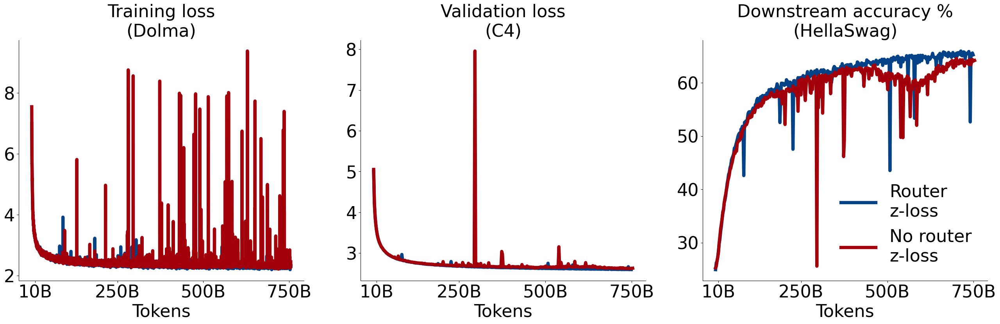

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

#data = [
#  (losses_nls, losses_ls, [x * 100 for x in range(len(losses_nls))]),
#  (val_nls, val_ls, [x * 1000 for x in range(len(val_nls))]),
#  ([x*100 for x in down_nls], [x*100 for x in down_ls], [x * 1000 for x in range(len(down_nls))]),
#]

data = [
  (losses_moe, losses_noz),
  (val_moe, val_noz),
  ([(x, y*100) for (x, y) in down_moe], [(x, y*100) for (x, y) in down_noz]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        # data[i][2],
        # data[i][0],
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Router\nz-loss",
    )
    ax.plot(
        # data[i][2],
        # data[i][1],
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="No router\nz-loss",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [10, 250, 500, 750]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

plt.legend(
    fontsize=FONTSIZE,
    frameon=False,
)

# Put legend on middle plot which has more space

# Deduplicate legend
#handles, labels = ax.get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#axes.flatten()[1].legend(by_label.values(), by_label.keys(), fontsize=FONTSIZE, frameon=False)

#fig.legend(
    #loc="upper center",
#    fontsize=FONTSIZE,
#    frameon=False
#)

plt.savefig('zloss.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Init

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_init.pkl"):
  with open("losses_init.pkl", "rb") as f:
      losses_init = pickle.load(f)

  with open("val_init.pkl", "rb") as f:
      val_init = pickle.load(f)

  with open("down_init.pkl", "rb") as f:
      down_init = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("rrfxe3i7", 4500000),
  ]

  losses_init = []
  val_init = []
  down_init = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_init += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_init += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_init += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_init.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_init.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_init.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_init.pkl", "wb") as f:
      pickle.dump(losses_init, f)

  with open("val_init.pkl", "wb") as f:
      pickle.dump(val_init, f)

  with open("down_init.pkl", "wb") as f:
      pickle.dump(down_init, f)

print(len(losses_init), len(val_init), len(down_init))



Run ID: rrfxe3i7
10000 287 287


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_noz.pkl"):
  with open("losses_noz.pkl", "rb") as f:
      losses_noz = pickle.load(f)

  with open("val_noz.pkl", "rb") as f:
      val_noz = pickle.load(f)

  with open("down_noz.pkl", "rb") as f:
      down_noz = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("aq2us82x", 4500000),
  ]

  losses_noz = []
  val_noz = []
  down_noz = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_noz += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_noz += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_noz += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_noz.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_noz.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_noz.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_noz.pkl", "wb") as f:
      pickle.dump(losses_noz, f)

  with open("val_noz.pkl", "wb") as f:
      pickle.dump(val_noz, f)

  with open("down_noz.pkl", "wb") as f:
      pickle.dump(down_noz, f)

print(len(losses_noz), len(val_noz), len(down_noz))



Run ID: aq2us82x
10000 359 359


In [ ]:
last_step = min(losses_init[-1][0], losses_noz[-1][0])

losses_init = [(x[0],x[1]) for x in losses_init if x[0] <= last_step]
losses_noz = [(x[0],x[1]) for x in losses_noz if x[0] <= last_step]

max_len = min(len(val_init), len(val_noz))

val_noz = val_noz[:max_len]
val_init = val_init[:max_len]

max_len = min(len(down_init), len(down_noz))

down_noz = down_noz[:max_len]
down_init = down_init[:max_len]


print(losses_noz[-1], losses_init[-1], len(losses_noz), len(losses_init))
print(val_noz[-1], val_init[-1], len(val_noz), len(val_init))
print(down_noz[-1], down_init[-1], len(down_noz), len(down_init))

(287476, 2.3696343898773193) (287504, 2.2967967987060547) 7947 10000
(287000, 2.6578636169433594) (287000, 2.6216068267822266) 287 287
(287000, 0.5951005816459656) (287000, 0.6399123668670654) 287 287


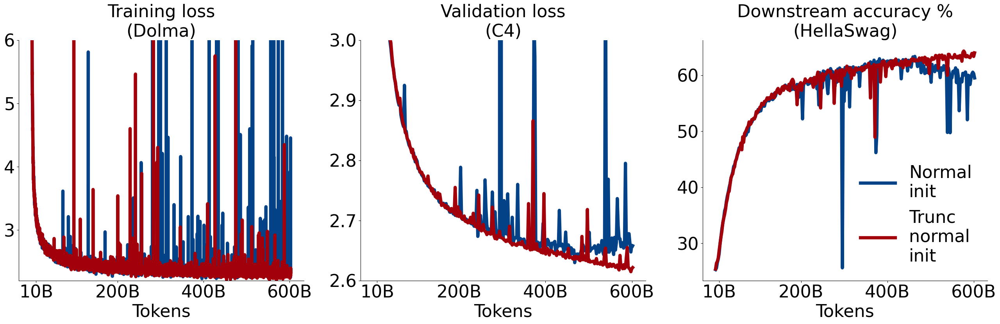

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

#data = [
#  (losses_nls, losses_ls, [x * 100 for x in range(len(losses_nls))]),
#  (val_nls, val_ls, [x * 1000 for x in range(len(val_nls))]),
#  ([x*100 for x in down_nls], [x*100 for x in down_ls], [x * 1000 for x in range(len(down_nls))]),
#]

data = [
  (losses_noz, losses_init),
  (val_noz, val_init),
  ([(x, y*100) for (x, y) in down_noz], [(x, y*100) for (x, y) in down_init]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        # data[i][2],
        # data[i][0],
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Normal\ninit",
    )
    ax.plot(
        # data[i][2],
        # data[i][1],
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Trunc\nnormal\ninit",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [10, 200, 400, 600]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 6.0]
        )
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.6, 3.0]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False,
)

# Put legend on middle plot which has more space

# Deduplicate legend
#handles, labels = ax.get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#axes.flatten()[1].legend(by_label.values(), by_label.keys(), fontsize=FONTSIZE, frameon=False)

#fig.legend(
    #loc="upper center",
#    fontsize=FONTSIZE,
#    frameon=False
#)

plt.savefig('init.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### LBL

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_lblfp32.pkl"):
  with open("losses_lblfp32.pkl", "rb") as f:
      losses_lblfp32 = pickle.load(f)

  with open("val_lblfp32.pkl", "rb") as f:
      val_lblfp32 = pickle.load(f)

  with open("down_lblfp32.pkl", "rb") as f:
      down_lblfp32 = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("ijr033ki", 10000),
      ("zffa9pb8", 15000),
      ("hbw9j03r", 70000),
  ]

  losses_lblfp32 = []
  val_lblfp32 = []
  down_lblfp32 = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_lblfp32 += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_lblfp32 += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_lblfp32 += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_n.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_n.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_n.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_lblfp32.pkl", "wb") as f:
      pickle.dump(losses_lblfp32, f)

  with open("val_lblfp32.pkl", "wb") as f:
      pickle.dump(val_lblfp32, f)

  with open("down_lblfp32.pkl", "wb") as f:
      pickle.dump(down_lblfp32, f)

print(len(losses_lblfp32), len(val_lblfp32), len(down_lblfp32))

24999 65 65


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_lblbf16.pkl"):
  with open("losses_lblbf16.pkl", "rb") as f:
      losses_lblbf16 = pickle.load(f)

  with open("val_lblbf16.pkl", "rb") as f:
      val_lblbf16 = pickle.load(f)

  with open("down_lblbf16.pkl", "rb") as f:
      down_lblbf16 = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("l1jue9r2", 65000),
  ]

  losses_lblbf16 = []
  val_lblbf16 = []
  down_lblbf16 = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_lblbf16 += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default") if x['_step'] <= end_step
        ]
        val_lblbf16 += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")  if x['_step'] <= end_step
        ]
        down_lblbf16 += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")  if x['_step'] <= end_step
        ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_n.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_n.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_n.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_lblbf16.pkl", "wb") as f:
      pickle.dump(losses_lblbf16, f)

  with open("val_lblbf16.pkl", "wb") as f:
      pickle.dump(val_lblbf16, f)

  with open("down_lblbf16.pkl", "wb") as f:
      pickle.dump(down_lblbf16, f)

print(len(losses_lblbf16), len(val_lblbf16), len(down_lblbf16))

Run ID: l1jue9r2
6193 65 65


In [ ]:
len(losses_lblbf16), len(losses_lblfp32)

(6193, 24999)

In [ ]:
max_len = min(len(losses_lblbf16), len(losses_lblfp32))

losses_lblfp32 = losses_lblfp32[:max_len]
losses_lblbf16 = losses_lblbf16[:max_len]

max_len = min(len(val_lblbf16), len(val_lblfp32))

val_lblfp32 = val_lblfp32[:max_len]
val_lblbf16 = val_lblbf16[:max_len]

max_len = min(len(down_lblbf16), len(down_lblfp32))

down_lblfp32 = down_lblfp32[:max_len]
down_lblbf16 = down_lblbf16[:max_len]


print(losses_lblfp32[-1], losses_lblbf16[-1], len(losses_lblfp32), len(losses_lblbf16))
print(val_lblfp32[-1], val_lblbf16[-1], len(val_lblfp32), len(val_lblbf16))
print(down_lblfp32[-1], down_lblbf16[-1], len(down_lblfp32), len(down_lblbf16))

(11693, 2.332883358001709) (105840, 2.245231866836548) 10000 10000
(65000, 2.638763904571533) (65000, 2.6401326656341553) 65 65
(65000, 0.6378211379051208) (65000, 0.637323260307312) 65 65


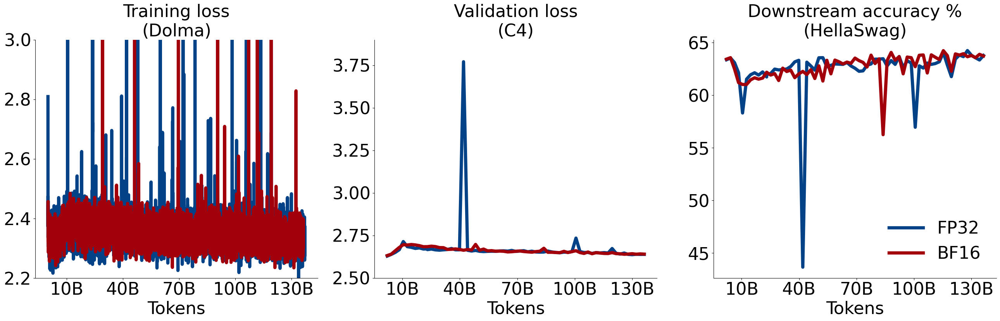

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_lblfp32, losses_lblbf16),
  (val_lblfp32, val_lblbf16),
  ([(x, y*100) for (x, y) in down_lblfp32], [(x, y*100) for (x, y) in down_lblbf16]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="FP32",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="BF16",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [10, 40, 70, 100, 130]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 3.0]
        )

    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.5, 3.9]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('lbl.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### QK Norm

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_init.pkl"):
  with open("losses_init.pkl", "rb") as f:
      losses_init = pickle.load(f)

  with open("val_init.pkl", "rb") as f:
      val_init = pickle.load(f)

  with open("down_init.pkl", "rb") as f:
      down_init = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("rrfxe3i7", 4500000),
  ]

  losses_init = []
  val_init = []
  down_init = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_init += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_init += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_init += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_init.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_init.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_init.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_init.pkl", "wb") as f:
      pickle.dump(losses_init, f)

  with open("val_init.pkl", "wb") as f:
      pickle.dump(val_init, f)

  with open("down_init.pkl", "wb") as f:
      pickle.dump(down_init, f)

print(len(losses_init), len(val_init), len(down_init))



<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Run ID: rrfxe3i7
10000 287 287


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_qknorm.pkl"):
  with open("losses_qknorm.pkl", "rb") as f:
      losses_qknorm = pickle.load(f)

  with open("val_qknorm.pkl", "rb") as f:
      val_qknorm = pickle.load(f)

  with open("down_qknorm.pkl", "rb") as f:
      down_qknorm = pickle.load(f)

else:
  import wandb
  api = wandb.Api()


  moe_runs = [
      ("bjlwpyk8", 5000),
      ("fccwk197", 10000),
      ("8c3bsjbd", 158000),
  ]

  losses_qknorm = []
  val_qknorm = []
  down_qknorm = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_qknorm += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_qknorm += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_qknorm += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]

  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_qknorm.append(row["train/CrossEntropyLoss"])
            if i % 1000 == 0:
                val_qknorm.append(row["eval/c4_en-validation/CrossEntropyLoss"])
                down_qknorm.append(row["eval/downstream/hellaswag_len_norm"])

  # Save to file
  import pickle

  with open("losses_qknorm.pkl", "wb") as f:
      pickle.dump(losses_qknorm, f)

  with open("val_qknorm.pkl", "wb") as f:
      pickle.dump(val_qknorm, f)

  with open("down_qknorm.pkl", "wb") as f:
      pickle.dump(down_qknorm, f)

print(len(losses_qknorm), len(val_qknorm), len(down_qknorm))



Run ID: bjlwpyk8
Run ID: fccwk197
Run ID: 8c3bsjbd
23197 160 160


In [ ]:
last_step = min(losses_init[-1][0], losses_qknorm[-1][0])

losses_init = [(x[0],x[1]) for x in losses_init if x[0] <= last_step]
losses_qknorm = [(x[0],x[1]) for x in losses_qknorm if x[0] <= last_step]

max_len = min(len(val_init), len(val_qknorm))

val_qknorm = val_qknorm[:max_len]
val_init = val_init[:max_len]

max_len = min(len(down_init), len(down_qknorm))

down_qknorm = down_qknorm[:max_len]
down_init = down_init[:max_len]

print(losses_qknorm[-1], losses_init[-1], len(losses_qknorm), len(losses_init))
print(val_qknorm[-1], val_init[-1], len(val_qknorm), len(val_init))
print(down_qknorm[-1], down_init[-1], len(down_qknorm), len(down_init))

(157206, 2.337663173675537) (157173, 2.334967613220215) 23196 5414
(157000, 2.6525309085845947) (160000, 2.6620383262634277) 160 160
(157000, 0.6188010573387146) (160000, 0.610535740852356) 160 160


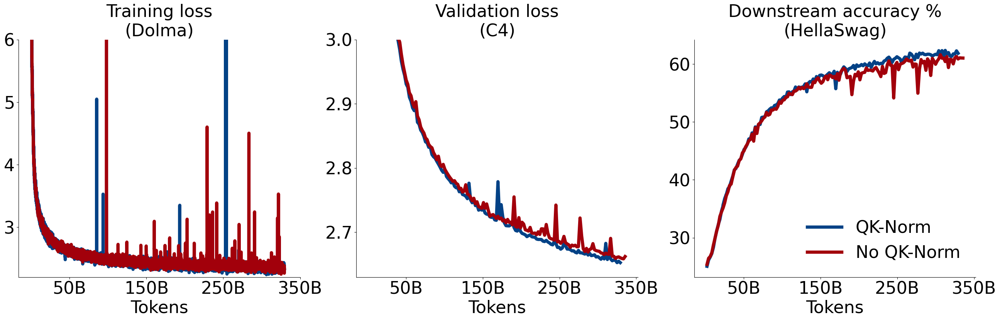

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

#data = [
#  (losses_nls, losses_ls, [x * 100 for x in range(len(losses_nls))]),
#  (val_nls, val_ls, [x * 1000 for x in range(len(val_nls))]),
#  ([x*100 for x in down_nls], [x*100 for x in down_ls], [x * 1000 for x in range(len(down_nls))]),
#]

data = [
  (losses_qknorm, losses_init),
  (val_qknorm, val_init),
  ([(x, y*100) for (x, y) in down_qknorm], [(x, y*100) for (x, y) in down_init]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        # data[i][2],
        # data[i][0],
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="QK-Norm",
    )
    ax.plot(
        # data[i][2],
        # data[i][1],
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="No QK-Norm",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    #ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [50, 150, 250, 350]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 6.0]
        )
    elif i == 1:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.63, 3.0]
        )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False,
)

# Put legend on middle plot which has more space

# Deduplicate legend
#handles, labels = ax.get_legend_handles_labels()
#by_label = dict(zip(labels, handles))
#axes.flatten()[1].legend(by_label.values(), by_label.keys(), fontsize=FONTSIZE, frameon=False)

#fig.legend(
    #loc="upper center",
#    fontsize=FONTSIZE,
#    frameon=False
#)

plt.savefig('qknorm.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### LN

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all
# Optionally avg multiple downstream tasks
downstream_tasks_to_random = {
    "hellaswag_len_norm": 25,
    "piqa_len_norm": 50,
    "sciq_acc": 25,
    "arc_easy_acc": 25,
    "copa_acc": 50,
    "openbook_qa_len_norm": 25,
    "social_iqa_len_norm": 1/3*100,
    "commonsense_qa_len_norm": 25,
    "boolq_acc": 50,
    "arc_challenge_len_norm": 25,
    "winogrande_acc": 50,
}

if os.path.exists("losses_rmsx.pkl"):
  with open("losses_rms.pkl", "rb") as f:
      losses_rms = pickle.load(f)

  with open("val_rms.pkl", "rb") as f:
      val_rms = pickle.load(f)

  with open("down_rms.pkl", "rb") as f:
      down_rms = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("so1ovllx", 35000),
      ("cgl34bsd", 51000),
  ]

  losses_rms = []
  val_rms = []
  down_rms = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_rms += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_rms += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]

        if len(downstream_tasks_to_random) > 1:
          down_rms += [
              (
                  x['_step'],
                  # Normalize each value to be within 0 - 1 where 0 is n i.e. random performance & average
                  sum([(x['eval/downstream/' + task]*100-n)/(100-n) for task, n in downstream_tasks_to_random.items()]) / len(downstream_tasks_to_random)
            ) for x in run.history(samples=samples, keys=["eval/downstream/" + task for task in downstream_tasks_to_random.keys()], x_axis="_step", pandas=False, stream="default")
          ]
        else:
          down_rms += [
              (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
          ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_n.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_n.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_n.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_rms.pkl", "wb") as f:
      pickle.dump(losses_rms, f)

  with open("val_rms.pkl", "wb") as f:
      pickle.dump(val_rms, f)

  with open("down_rms.pkl", "wb") as f:
      pickle.dump(down_rms, f)

print(len(losses_rms), len(val_rms), len(down_rms))


Run ID: so1ovllx
Run ID: cgl34bsd
20000 10 10


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_nplnx.pkl"):
  with open("losses_npln.pkl", "rb") as f:
      losses_npln = pickle.load(f)

  with open("val_npln.pkl", "rb") as f:
      val_npln = pickle.load(f)

  with open("down_npln.pkl", "rb") as f:
      down_npln = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("pxpd0scj", 146000),
  ]

  losses_npln = []
  val_npln = []
  down_npln = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_npln += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_npln += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        if len(downstream_tasks_to_random) > 1:
          down_npln += [
              (
                  x['_step'],
                  # Normalize each value to be within 0 - 100 where 0 is n i.e. random performance & average
                  sum([(x['eval/downstream/' + task]*100-n)/(100-n) for task, n in downstream_tasks_to_random.items()]) / len(downstream_tasks_to_random)
            ) for x in run.history(samples=samples, keys=["eval/downstream/" + task for task in downstream_tasks_to_random.keys()], x_axis="_step", pandas=False, stream="default")
          ]
        else:
          down_npln += [
              (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
          ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_n.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_n.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_n.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_npln.pkl", "wb") as f:
      pickle.dump(losses_npln, f)

  with open("val_npln.pkl", "wb") as f:
      pickle.dump(val_npln, f)

  with open("down_npln.pkl", "wb") as f:
      pickle.dump(down_npln, f)

print(len(losses_npln), len(val_npln), len(down_npln))

Run ID: pxpd0scj
10000 29 29


In [ ]:
last_step = min(losses_rms[-1][0], losses_npln[-1][0])

losses_rms = [(x[0],x[1]) for x in losses_rms if x[0] <= last_step]
losses_npln = [(x[0],x[1]) for x in losses_npln if x[0] <= last_step]

max_len = min(len(val_npln), len(val_rms))

val_rms = val_rms[:max_len]
val_npln = val_npln[:max_len]

max_len = min(len(down_npln), len(down_rms))

down_rms = down_rms[:max_len]
down_npln = down_npln[:max_len]


print(losses_rms[-1], losses_npln[-1], len(losses_rms), len(losses_npln))
print(val_rms[-1], val_npln[-1], len(val_rms), len(val_npln))
print(down_rms[-1], down_npln[-1], len(down_rms), len(down_npln))

(52744, 2.4048826694488525) (52726, 2.393275260925293) 20000 3610
(50000, 2.6941261291503906) (50000, 2.726390838623047) 10 10
(50000, 0.35520381006327545) (50000, 0.3356054840665875) 10 10


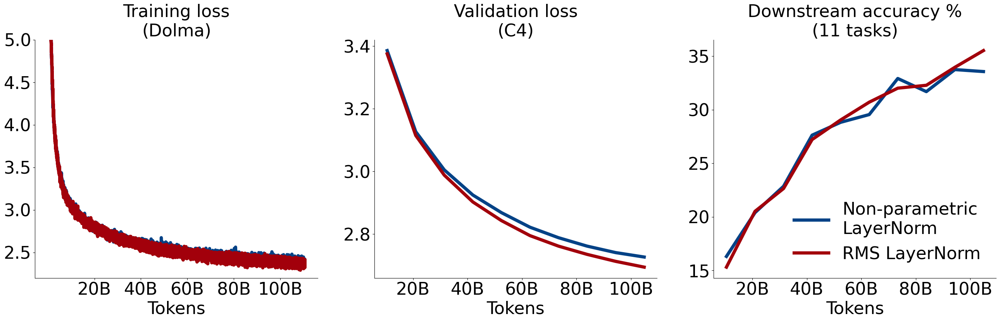

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(11 tasks)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_npln, losses_rms),
  (val_npln, val_rms),
  ([(x, y*100) for (x, y) in down_npln], [(x, y*100) for (x, y) in down_rms]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Non-parametric\nLayerNorm",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="RMS LayerNorm",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)


    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.2, 5.0]
        )

    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.5, 3.9]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('ln.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### LN GradNorm

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("gradnorm_rmsX.pkl"):
  with open("gradnorm_rms.pkl", "rb") as f:
      gradnorm_rms = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("so1ovllx", 35000),
      ("cgl34bsd", 51000),
  ]

  gradnorm_rms = []

  for run_id, end_step in moe_runs:
      print("Run ID:", run_id)
      run = api.run(f"ai2-llm/olmoe/{run_id}")

      samples = end_step // sample_every_n

      gradnorm_rms += [
          (x['_step'], x['optim/total_grad_norm']) for x in run.history(samples=samples, keys=["optim/total_grad_norm"], x_axis="_step", pandas=False, stream="default")
      ]

  # Save to file
  import pickle

  with open("gradnorm_rms.pkl", "wb") as f:
      pickle.dump(gradnorm_rms, f)

print(len(gradnorm_rms))


Run ID: so1ovllx
Run ID: cgl34bsd
1812


In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("gradnorm_nplnX.pkl"):
  with open("gradnorm_npln.pkl", "rb") as f:
      gradnorm_npln = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("pxpd0scj", 146000),
  ]

  gradnorm_npln = []

  for run_id, end_step in moe_runs:
      print("Run ID:", run_id)
      run = api.run(f"ai2-llm/olmoe/{run_id}")

      samples = end_step // sample_every_n

      gradnorm_npln += [
          (x['_step'], x['optim/total_grad_norm']) for x in run.history(samples=samples, keys=["optim/total_grad_norm"], x_axis="_step", pandas=False, stream="default")
      ]

  # Save to file
  import pickle

  with open("gradnorm_npln.pkl", "wb") as f:
      pickle.dump(gradnorm_npln, f)

print(len(gradnorm_npln))


Run ID: pxpd0scj
10000


In [ ]:
last_step = min(gradnorm_npln[-1][0], gradnorm_rms[-1][0])

gradnorm_rms = [(x[0],x[1]) for x in gradnorm_rms if x[0] <= last_step]
gradnorm_npln = [(x[0],x[1]) for x in gradnorm_npln if x[0] <= last_step]

print(gradnorm_rms[-1], gradnorm_npln[-1], len(gradnorm_rms), len(gradnorm_npln))

(52740, 0.15614373981952667) (52740, 0.5161663889884949) 1812 3616


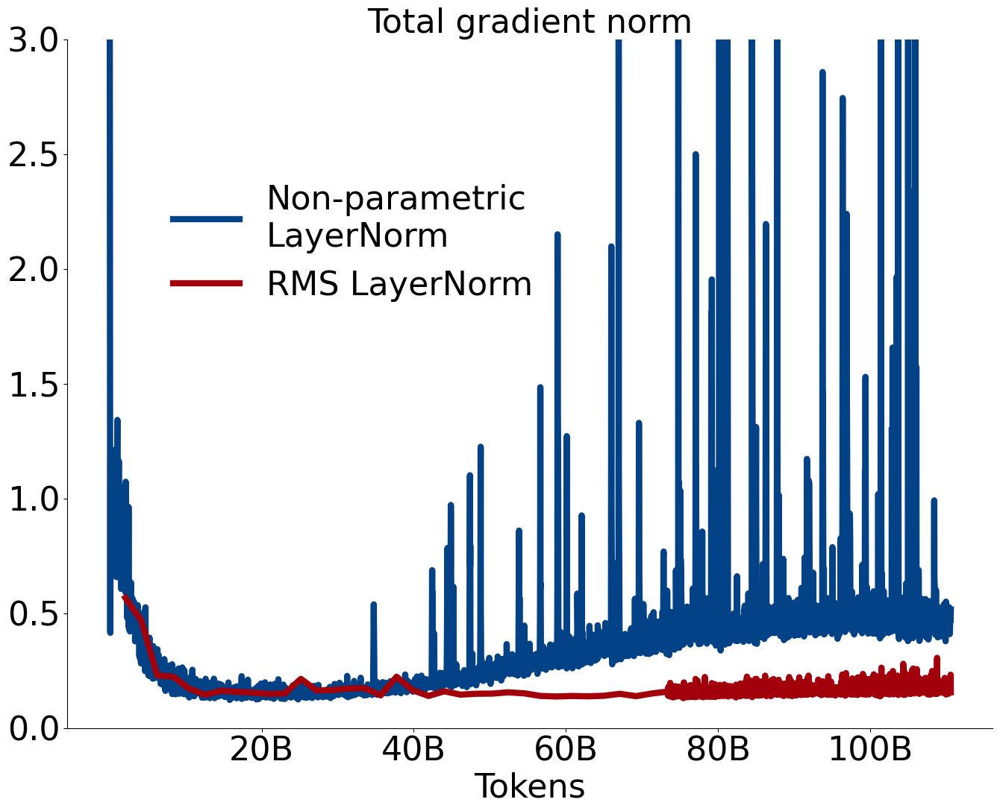

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(16, 12), ncols=1)

titles = [
    "Total gradient norm",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (gradnorm_npln, gradnorm_rms),
]

for i, ax in enumerate([axes]):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="Non-parametric\nLayerNorm",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="RMS LayerNorm",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [20, 40, 60, 80, 100]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [0, 3.0]
        )

    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.5, 3.9]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False,
    # set loc in xy
    loc=(0.1, 0.6),
)

plt.savefig('gradnormln.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Decay Emb

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_demb.pkl"):
  with open("losses_demb.pkl", "rb") as f:
      losses_demb = pickle.load(f)

  with open("val_demb.pkl", "rb") as f:
      val_demb = pickle.load(f)

  with open("down_demb.pkl", "rb") as f:
      down_demb = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("mhzp4nqe", 5000),
      ("fmjwqgmw", 31000)
  ]

  losses_demb = []
  val_demb = []
  down_demb = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_demb += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_demb += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_demb += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_demb.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_demb.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_demb.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_demb.pkl", "wb") as f:
      pickle.dump(losses_demb, f)

  with open("val_demb.pkl", "wb") as f:
      pickle.dump(val_demb, f)

  with open("down_demb.pkl", "wb") as f:
      pickle.dump(down_demb, f)

print(len(losses_demb), len(val_demb), len(down_demb))


Run ID: mhzp4nqe
Run ID: fmjwqgmw
15000 6 6


In [ ]:
last_step = min(losses_rms[-1][0], losses_demb[-1][0])

losses_rms = [(x[0],x[1]) for x in losses_rms if x[0] <= last_step]
losses_demb = [(x[0],x[1]) for x in losses_demb if x[0] <= last_step]

max_len = min(len(val_demb), len(val_rms))

val_rms = val_rms[:max_len]
val_demb = val_demb[:max_len]

max_len = min(len(down_demb), len(down_rms))

down_rms = down_rms[:max_len]
down_demb = down_demb[:max_len]


print(losses_rms[-1], losses_demb[-1], len(losses_rms), len(losses_demb))
print(val_rms[-1], val_demb[-1], len(val_rms), len(val_demb))
print(down_rms[-1], down_demb[-1], len(down_rms), len(down_demb))

(33196, 2.510359764099121) (33199, 2.4511311054229736) 8531 15000
(30000, 2.7947592735290527) (30000, 2.793471574783325) 6 6
(30000, 0.5328620076179504) (30000, 0.5340569615364075) 6 6


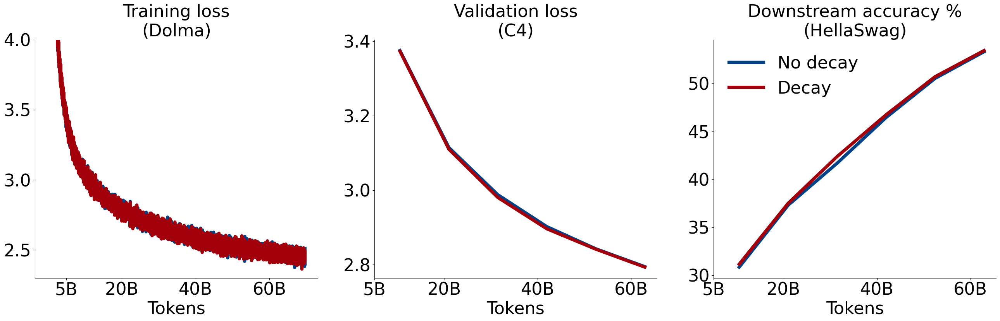

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_rms, losses_demb),
  (val_rms, val_demb),
  ([(x, y*100) for (x, y) in down_rms], [(x, y*100) for (x, y) in down_demb]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="No decay",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Decay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [5, 20, 40, 60]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.3, 4.0]
        )

    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.5, 3.9]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('embdecay.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### AdamW eps

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_eps.pkl"):
  with open("losses_eps.pkl", "rb") as f:
      losses_eps = pickle.load(f)

  with open("val_eps.pkl", "rb") as f:
      val_eps = pickle.load(f)

  with open("down_eps.pkl", "rb") as f:
      down_eps = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("pijx97sz", 5000),
      ("cfc4m3pd", 16000),
  ]

  losses_eps = []
  val_eps = []
  down_eps = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_eps += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_eps += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_eps += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_eps.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_eps.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_eps.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_eps.pkl", "wb") as f:
      pickle.dump(losses_eps, f)

  with open("val_eps.pkl", "wb") as f:
      pickle.dump(val_eps, f)

  with open("down_eps.pkl", "wb") as f:
      pickle.dump(down_eps, f)

print(len(losses_eps), len(val_eps), len(down_eps))


Run ID: pijx97sz
Run ID: cfc4m3pd
15000 3 3


In [ ]:
last_step = min(losses_demb[-1][0], losses_eps[-1][0])

losses_demb = [(x[0],x[1]) for x in losses_demb if x[0] <= last_step]
losses_eps = [(x[0],x[1]) for x in losses_eps if x[0] <= last_step]

max_len = min(len(val_eps), len(val_demb))

val_demb = val_demb[:max_len]
val_eps = val_eps[:max_len]

max_len = min(len(down_eps), len(down_demb))

down_demb = down_demb[:max_len]
down_eps = down_eps[:max_len]

print(losses_demb[-1], losses_eps[-1], len(losses_demb), len(losses_eps))
print(val_demb[-1], val_eps[-1], len(val_demb), len(val_eps))
print(down_demb[-1], down_eps[-1], len(down_demb), len(down_eps))

(15926, 2.646186113357544) (15926, 2.417684316635132) 8921 15000
(15000, 2.980419874191284) (15000, 2.7277166843414307) 3 3
(15000, 0.4237203598022461) (15000, 0.5824536681175232) 3 3


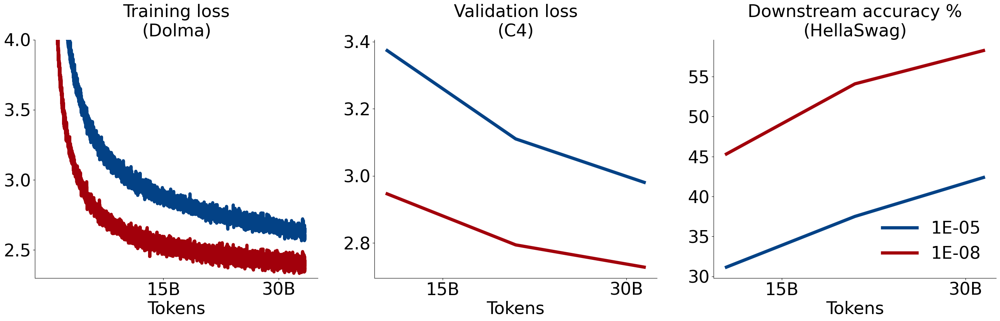

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_demb, losses_eps),
  (val_demb, val_eps),
  ([(x, y*100) for (x, y) in down_demb], [(x, y*100) for (x, y) in down_eps]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="1E-05",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="1E-08",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [15, 30]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.3, 4.0]
        )

    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.5, 3.9]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('adamweps.pdf', dpi=300, bbox_inches='tight')
plt.show()

##### Decay LN

In [ ]:
# Load files if exist
import os
import pickle

sample_every_n = 1 # Set to -1 for all

if os.path.exists("losses_ndrms.pkl"):
  with open("losses_ndrms.pkl", "rb") as f:
      losses_ndrms = pickle.load(f)

  with open("val_ndrms.pkl", "rb") as f:
      val_ndrms = pickle.load(f)

  with open("down_ndrms.pkl", "rb") as f:
      down_ndrms = pickle.load(f)

else:
  import wandb
  api = wandb.Api()

  moe_runs = [
      ("oyuyl7jz", 22000),
  ]

  losses_ndrms = []
  val_ndrms = []
  down_ndrms = []

  if sample_every_n > 0:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")

        samples = end_step // sample_every_n

        losses_ndrms += [
            (x['_step'], x['train/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["train/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        val_ndrms += [
            (x['_step'], x['eval/c4_en-validation/CrossEntropyLoss']) for x in run.history(samples=samples, keys=["eval/c4_en-validation/CrossEntropyLoss"], x_axis="_step", pandas=False, stream="default")
        ]
        down_ndrms += [
            (x['_step'], x['eval/downstream/hellaswag_len_norm']) for x in run.history(samples=samples, keys=["eval/downstream/hellaswag_len_norm"], x_axis="_step", pandas=False, stream="default")
        ]
  else:
    for run_id, end_step in moe_runs:
        print("Run ID:", run_id)
        run = api.run(f"ai2-llm/olmoe/{run_id}")
        for i, row in enumerate(run.scan_history()):
            if i == 0: continue
            if i > end_step: break
            if i % 100 == 0:
                losses_ndrms.append((i, row["train/CrossEntropyLoss"]))
            if i % 1000 == 0:
                val_ndrms.append((i, row["eval/c4_en-validation/CrossEntropyLoss"]))
                down_ndrms.append((i, row["eval/downstream/hellaswag_len_norm"]))

  # Save to file
  import pickle

  with open("losses_ndrms.pkl", "wb") as f:
      pickle.dump(losses_ndrms, f)

  with open("val_ndrms.pkl", "wb") as f:
      pickle.dump(val_ndrms, f)

  with open("down_ndrms.pkl", "wb") as f:
      pickle.dump(down_ndrms, f)

print(len(losses_ndrms), len(val_ndrms), len(down_ndrms))


10000 4 4


In [ ]:
last_step = min(losses_ndrms[-1][0], losses_eps[-1][0])

losses_ndrms = [(x[0],x[1]) for x in losses_ndrms if x[0] <= last_step]
losses_eps = [(x[0],x[1]) for x in losses_eps if x[0] <= last_step]

max_len = min(len(val_eps), len(val_ndrms))

val_ndrms = val_ndrms[:max_len]
val_eps = val_eps[:max_len]

max_len = min(len(down_eps), len(down_ndrms))

down_ndrms = down_ndrms[:max_len]
down_eps = down_eps[:max_len]

print(losses_ndrms[-1], losses_eps[-1], len(losses_ndrms), len(losses_eps))
print(val_ndrms[-1], val_eps[-1], len(val_ndrms), len(val_eps))
print(down_ndrms[-1], down_eps[-1], len(down_ndrms), len(down_eps))

(15926, 2.421509265899658) (15926, 2.417684316635132) 7317 15000
(15000, 2.7316548824310303) (15000, 2.7277166843414307) 3 3
(15000, 0.5732921957969666) (15000, 0.5824536681175232) 3 3


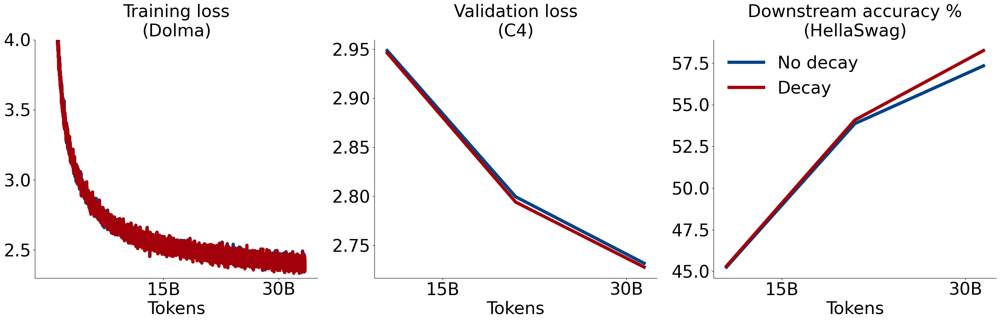

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(32, 8), ncols=3)

titles = [
    "Training loss\n(Dolma)",
    "Validation loss\n(C4)",
    "Downstream accuracy %\n(HellaSwag)",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  (losses_ndrms, losses_eps),
  (val_ndrms, val_eps),
  ([(x, y*100) for (x, y) in down_ndrms], [(x, y*100) for (x, y) in down_eps]),
]

for i, ax in enumerate(axes.flatten()):
    ax.plot(
        [x[0] for x in data[i][0]],
        [x[1] for x in data[i][0]],
        linewidth=6.0,
        color=colors[0],
        label="No decay",
    )
    ax.plot(
        [x[0] for x in data[i][1]],
        [x[1] for x in data[i][1]],
        linewidth=6.0,
        color=colors[1],
        label="Decay",
    )

    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)

    ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

    ax.set_xlabel("Tokens", fontsize=FONTSIZE)

    ax.set_title(titles[i], fontsize=FONTSIZE)

    x_ticks = [15, 30]
    # Transform billion tokens to steps
    x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
    x_ticks = [str(x) + "B" for x in x_ticks]

    ax.set_xticks(x_ticks_loc, x_ticks)

    # Set ylims
    if i == 0:
        a, b = ax.get_ylim()
        ax.set_ylim(
            [2.3, 4.0]
        )

    #elif i == 1:
    #    a, b = ax.get_ylim()
    #    ax.set_ylim(
    #        [2.5, 3.9]
    #    )

plt.legend(
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('lndecay.pdf', dpi=300, bbox_inches='tight')
plt.show()


##### XYZ

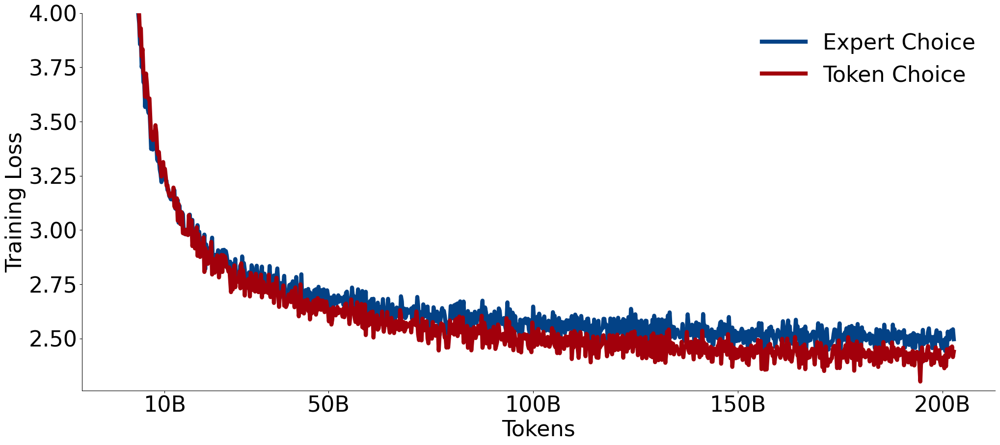

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

FONTSIZE = 32
TOKENS_PER_STEP = 4096 * 512

fig, axes = plt.subplots(figsize=(24, 10), ncols=1)
ax = axes

titles = [
    "Expert Choice",
    "Token Choice",
]

colors = [
    "#034286",
    "#A2000B",
]

data = [
  losses_ec,
  losses_tc,
]


#for i, ax in enumerate(axes.flatten()):

steps = [x * 100 for x in range(len(data[0]))]
#tokens = [np.log10(x * 1e9 / TOKENS_PER_STEP) for x in range(len(data[0]))]


ax.plot(
    steps,
    data[0],
    linewidth=6.0,
    color=colors[0],
    label="Expert Choice",
)
ax.plot(
    steps,
    data[1],
    linewidth=6.0,
    color=colors[1],
    label="Token Choice",
)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.tick_params(axis='both', which='major', labelsize=FONTSIZE)

ax.set_ylabel("Training Loss", fontsize=FONTSIZE)
ax.set_xlabel("Tokens", fontsize=FONTSIZE)

# ax.set_title(titles[i], fontsize=FONTSIZE)
#ax.set_xscale(
#    "log"
#)

x_ticks = [10, 50, 100, 150, 200]
# Transform billion tokens to steps
x_ticks_loc = [x * 1e9 / TOKENS_PER_STEP for x in x_ticks]
x_ticks = [str(x) + "B" for x in x_ticks]

ax.set_xticks(x_ticks_loc, x_ticks)

#ax.set_xscale(
#    "log"
#)

plt.ylim(
    [2.26, 4]
)

#plt.xlim(
#    [-10, 1260]
#)

plt.legend(
    loc="upper right",
    fontsize=FONTSIZE,
    frameon=False
)

plt.savefig('loss7.pdf', dpi=300, bbox_inches='tight')
plt.show()



In [ ]:
len(losses_tc)

968

In [ ]:
!head /content/wandb_export_2024-06-19T20_49_10.342-07_00.csv

"Step","32830 (Run set) - train/CrossEntropyLoss","32830 (Run set) - train/CrossEntropyLoss__MIN","32830 (Run set) - train/CrossEntropyLoss__MAX","32153 (Run set) - train/CrossEntropyLoss","32153 (Run set) - train/CrossEntropyLoss__MIN","32153 (Run set) - train/CrossEntropyLoss__MAX","mitchish1 (Run set 2) - train/CrossEntropyLoss","mitchish1 (Run set 2) - train/CrossEntropyLoss__MIN","mitchish1 (Run set 2) - train/CrossEntropyLoss__MAX"
"3","","","","10.44860553741455","10.44860553741455","10.44860553741455","","",""
"4","","","","10.286612510681152","10.286612510681152","10.286612510681152","","",""
"40","","","","7.907280445098877","7.907280445098877","7.907280445098877","","",""
"47","","","","7.767358779907227","7.767358779907227","7.767358779907227","","",""
"51","","","","7.7421040534973145","7.7421040534973145","7.7421040534973145","","",""
"52","","","","7.715868949890137","7.715868949890137","7.715868949890137","","",""
"56","","","","7.633136749267578","7.633136749267578","7

In [ ]:
!pip install -q wandb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.1/296.1 kB 21.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.9 MB/s eta 0:00:00


In [ ]:
import wandb
api = wandb.Api()
run = api.run("ai2-llm/olmoe/9217flhv")
if run.state == "finished":
    for i, row in run.history().iterrows():
        print(row["_timestamp"], row["accuracy"])

In [ ]:
history = run.scan_history()
losses = [row["train/CrossEntropyLoss"] for row in history]

In [ ]:
len(losses)

110583

In [ ]:
len(list(run.history().iterrows()))

500

In [ ]:
row

System/Peak GPU Memory (MB)                                                 NaN
_step                                                                      5345
eval/ice-validation/Perplexity                                             None
eval/pile-validation/Perplexity                                            None
eval/dolma_common-crawl-validation/Perplexity                              None
eval/downstream/mmlu_other_mc_5shot_test_len_norm                          None
eval/downstream/mmlu_social_sciences_mc_5shot_test_len_norm                None
eval/downstream/arc_challenge_len_norm                                     None
eval/wikitext_103-validation/Perplexity                                    None
throughput/device/batches_per_second                                   0.112304
eval/downstream/social_iqa_len_norm                                        None
eval/dolma_stack-validation/Perplexity                                     None
eval/c4_en-validation/CrossEntropyLoss  

In [ ]:
path = "/content/wandb_export_2024-06-19T20_49_10.342-07_00.csv"

import pandas as pd

with open(path, "r") as f:
    df = pd.read_csv(f)

In [ ]:
path = "/content/wandb_export_2024-06-19T20_49_10.342-07_00.csv"

import pandas as pd

with open(path, "r") as f:
    df = pd.read_csv(f)

# https://stackoverflow.com/questions/42281844/what-is-the-mathematics-behind-the-smoothing-parameter-in-tensorboards-scalar
def smooth(scalars, weight: float):  # Weight between 0 and 1
    last = scalars[0]  # First value in the plot (first timestep)
    smoothed = list()
    for point in scalars:
        smoothed_val = last * weight + (1 - weight) * point  # Calculate smoothed value
        smoothed.append(smoothed_val)                        # Save it
        last = smoothed_val                                  # Anchor the last smoothed value

    return smoothed

for key in ["sgpt2_e5s_bs2048_bf16_mix32 - train/loss_emb"]:
    df[key] = smooth(df[key].values.tolist(), weight=0.9)